# Week 4 - Exploring Semantic Spaces (Word Embeddings)
This week, we build on last week's topic modeling techniques by taking a text corpus we have developed, specifying an underlying number of dimensions, and training a model with a neural network auto-encoder (one of Google's word2vec  algorithms) that best describes corpus words in their local linguistic contexts, and exploring their locations in the resulting space to learn about the discursive culture that produced them.

This is our third document representation we have learned: First, we used word counts. Second, we used LDA topic models built around term coocurrence in the same document (i.e., a "bag of words"). Third, documents here are represented as densely indexed locations in dimensions, so that distances between those documents (and words) contain more information, though they require the full vector of dimension loadings (rather than just a few selected topic loadings) to describe. We will explore these spaces to understand complex, semantic relationships between words, index documents with descriptive words, identify the likelihood that a given document would have been produced by a given vector model, and explore how semantic categories can help us understand the cultures that produced them.

Note that most modern natural language processing (NLP) research, at least in computer science, uses word embeddings. This is the foundation of most state-of-the-art models.

Also note that the code in this Notebook can take many minutes or even hours to run. This is the case for most NLP research these days, and it's a good opportunity to start thinking about how to manage high-compute workloads, such as running code on small samples to test it, loading datafiles in [chunks](https://stackoverflow.com/a/25962187), or [multiprocessing](https://en.wikipedia.org/wiki/Multiprocessing).

## <font color="red">*Pitch Your Project*</font>

<font color="red">In the three cells immediately following, describe **WHAT** you are planning to analyze for your final project (i.e., texts, contexts and the social game, world and actors you intend to learn about through your analysis) (<200 words), **WHY** you are going to do it (i.e., why would theory and/or the average person benefit from knowing the results of your investigation) (<200 words), and **HOW** you plan to investigate it (i.e., what are the approaches and operations you plan to perform, in sequence, to yield this insight) (<400 words).

# ***What?*** 
<200 words

## ***Why?***
<200 words

## ***How?***
<400 words

## <font color="red">*Pitch Your Sample*</font>

<font color="red">In the cell immediately following, describe the rationale behind your proposed sample design for your final project. What is the social game, social work, or social actors you about whom you are seeking to make inferences? What are its virtues with respect to your research questions? What are its limitations? What are alternatives? What would be a reasonable path to "scale up" your sample for further analysis (i.e., high-profile publication) beyond this class? (<300 words).

## ***Which (words)?***
<300 words

In [2]:
#All these packages need to be installed from pip
import gensim#For word2vec, etc
import requests #For downloading our datasets
import lucem_illud #pip install -U git+git://github.com/UChicago-Computational-Content-Analysis/lucem_illud.git

import numpy as np #For arrays
import pandas as pd #Gives us DataFrames
import matplotlib.pyplot as plt #For graphics
import seaborn #Makes the graphics look nicer
import sklearn.metrics.pairwise #For cosine similarity
import sklearn.manifold #For T-SNE
import sklearn.decomposition #For PCA

#This 'magic' command makes the plots work better
#in the notebook, don't use it outside of a notebook.
#Also you can ignore the warning
%matplotlib inline

import os #For looking through files
import os.path #For managing file paths

# Getting our corpora

Instead of downloading our corpora, we have download them in advance; a subset of the [senate press releases](https://github.com/lintool/GrimmerSenatePressReleases) are in `grimmerPressReleases`. We will load them into a DataFrame, but first we need to define a function to convert directories of text files into DataFrames:

In [3]:
def loadDir(targetDir, category):
    allFileNames = os.listdir(targetDir)
    #We need to make them into usable paths and filter out hidden files
    filePaths = [os.path.join(targetDir, fname) for fname in allFileNames if fname[0] != '.']

    #The dict that will become the DataFrame
    senDict = {
        'category' : [category] * len(filePaths),
        'filePath' : [],
        'text' : [],
    }

    for fPath in filePaths:
        with open(fPath) as f:
# Try this line instead if you get an encoding error.
#         with open(fPath, encoding="ISO-8859-1") as f:
            senDict['text'].append(f.read())
            senDict['filePath'].append(fPath)

    return pd.DataFrame(senDict)

Now we can use the function in all the directories in `data/grimmerPressReleases`. If you are on Google Colab, note that rather than downloading GitHub data to your local machine and then uploading it to Drive, you can more quickly `git clone` directly to Colab, such as `!git clone https://github.com/lintool/GrimmerSenatePressReleases.git /drive/MyDrive/`, which then makes your `dataDir = 'drive/MyDrive/grimmerPressReleases/raw'`.

In [4]:
#dataDir = 'content/drive/MyDrive/grimmerPressReleases/raw'
dataDir = '../data/grimmerPressReleases'

senReleasesDF = pd.DataFrame()

for senatorName in [d for d in os.listdir(dataDir) if d[0] != '.']:
    senPath = os.path.join(dataDir, senatorName)
    senReleasesDF = senReleasesDF.append(loadDir(senPath, senatorName), ignore_index = True)

senReleasesDF[:100:10]

,category,filePath,text
0,Klobuchar,../data/grimmerPressReleases/Klobuchar/22May20...,...
10,Klobuchar,../data/grimmerPressReleases/Klobuchar/22Aug20...,...
20,Klobuchar,../data/grimmerPressReleases/Klobuchar/17Jul20...,...
30,Klobuchar,../data/grimmerPressReleases/Klobuchar/14Dec20...,...
40,Klobuchar,../data/grimmerPressReleases/Klobuchar/22Jan20...,...
50,Klobuchar,../data/grimmerPressReleases/Klobuchar/28May20...,...
60,Klobuchar,../data/grimmerPressReleases/Klobuchar/27Jun20...,...
70,Klobuchar,../data/grimmerPressReleases/Klobuchar/01Nov20...,...
80,Klobuchar,../data/grimmerPressReleases/Klobuchar/24Jan20...,...
90,Klobuchar,../data/grimmerPressReleases/Klobuchar/23Jan20...,...


Word2Vec needs to retain the sentence structure so as to capture a "continuous bag of words (CBOW)" and all of the skip-grams within a word window. The algorithm tries to preserve the distances induced by one of these two local structures. This is very different from clustering and LDA topic modeling which extract unordered words alone.

When we normalize here, we don't use the lematized form of the word because we might lose information. Note the paramter in the normalize tokens function.

In [5]:
#Apply our functions, notice each row is a list of lists now
senReleasesDF['tokenized_sents'] = senReleasesDF['text'].apply(lambda x: [lucem_illud.word_tokenize(s) for s in lucem_illud.sent_tokenize(x)])
#senReleasesDF['normalized_sents'] = senReleasesDF['tokenized_sents'].apply(lambda x: [lucem_illud.normalizeTokens(s, lemma=False) for s in x])
senReleasesDF['normalized_sents'] = senReleasesDF['tokenized_sents'].apply(lambda x: [lucem_illud.normalizeTokens(s) for s in x])

senReleasesDF[:100:10]

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Klobuchar'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Features'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Fergus'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Meets'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Local'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Burmese'. Check that your pipeline includes components that assign token.pos, typicall

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'standard'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'any'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'requirement'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Calls'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Action'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Stop'. Check that your pipeline includes components that assign token.pos, typically 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'technology'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'seeking'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'simplify'. Check that your pipeline includes components that assign token.pos, 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Secures'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '45'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Million'. Check that your pipeline includes components that assign token.pos, typically

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Showcases'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Efforts'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Global'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Increased'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Protection'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Great'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Named'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Conference'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'earns'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Hearing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Examine'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Delta'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Blasts'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Taking'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Easy'. Check that your pipeline includes components that assign token.pos, typically

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Urges'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Fellow'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Support'. Check that your pipeline includes components that assign token.pos, typical

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'reasonably'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'really'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'accurate'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Passes'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Improve'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Troop'. Check that your pipeline includes components that assign token.pos, typical

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Supports'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Lab'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Protects'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Veterans'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Benefits'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Delivers'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Wins'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Cellulosic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Ethanol'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'followed'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'official'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'submission'. Check that your pipeline includes components that assign token.pos,

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Following'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Republic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'New'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Gives'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Ethics'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Discussed'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Armed'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Forces'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'build'. Check that your pipeline includes components that assign token.pos, typically

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Investigation'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Considered'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Dismissing'. Check that your pipeline includes components that assign tok

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Passing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'mourn'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'inspiration'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Place'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'pioneering'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'reintegrate'. Check that your pipeline includes components that assign token.pos,

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Improved'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Cosponsors'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '21st'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Therefore'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'concentrations'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'discovered'. Check that your pipeline includes components that assign tok

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Warm'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Welcome'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Area'. Check that your pipeline includes components that assign token.pos, typically 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Leads'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Importance'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Examining'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Breakfast'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Meats'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Thielen'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Cop'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Beat'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Markets'. Check that your pipeline includes components that assign token.pos, typically '

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Highlights'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Southwest'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Tour'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Introducing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'truth'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ordinary'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Allowing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Flexibility'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Due'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Labor'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Pauls'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Shift'. Check that your pipeline includes components that assign token.pos, typically 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'construct'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Combined'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Arms'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'CFTC'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Step'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'vigilance'. Check that your pipeline includes components that assign token.pos, typicall

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Quick'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Time'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'upside'. Check that your pipeline includes components that assign token.pos, typically 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Convened'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Summit'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Hear'. Check that your pipeline includes components that assign token.pos, typical

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'tentative'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Investigative'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Recall'. Check that your pipeline includes components that assign token.po

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'auto'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '1000'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'consumption'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Discuss'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Promise'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Jobs'. Check that your pipeline includes components that assign token.pos, typical

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Minnetonka'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'grade'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'repeals'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Traveling'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Be'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Aware'. Check that your pipeline includes components that assign token.pos, typically

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Massive'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Oil'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Profits'. Check that your pipeline includes components that assign token.pos, typicall

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'bank'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Follow'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Transparency'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Denounces'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Deliberate'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Effort'. Check that your pipeline includes components that assign token.pos, 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'tide'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'pointed'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'vigorously'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Make'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Available'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Dozen'. Check that your pipeline includes components that assign token.pos, typical

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'FTAs'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'guidance'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Rapid'. Check that your pipeline includes components that assign token.pos, typicall

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Aid'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'paperwork'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Paulison'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'fusarium'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'blight'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Basin'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Web'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Best'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'coveted'. Check that your pipeline includes components that assign token.pos, typically '

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Starbuck'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Hand'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Scandinavian'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '450'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'senior'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'insulation'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'essence'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'homeowner'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Agrees'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Participates'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Ag'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Hires'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Crapo'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Increase'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Biodiesel'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'snags'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '360'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'omnibus'. Check that your pipeline includes components that assign token.pos, typically 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Unanimously'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'regulate'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'attached'. Check that your pipeline includes components that assign token.pos

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Investigate'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'whistleblower'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'emerged'. Check that your pipeline includes components that assign token

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'SW'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Trip'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Gets'. Check that your pipeline includes components that assign token.pos, typically 'tagg

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'navigate'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'complicated'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'boomers'. Check that your pipeline includes components that assign token.pos,

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Launches'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'http'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'abundance'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '91'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Thunderhawk'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Blandin'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Trying'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Adopt'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Babies'. Check that your pipeline includes components that assign token.pos, typicall

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Solution'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'stressing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'fixing'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'realizing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'regard'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'subsidizing'. Check that your pipeline includes components that assign token.pos,

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '64'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'appreciative'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'relies'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'praising'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'marking'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'merged'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'DOD'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '459'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'revolutionary'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Possible'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'underscores'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'tothe'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Proposals'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Invest'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'cellulose'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Get'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Preview'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Future'. Check that your pipeline includes components that assign token.pos, typically

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'locking'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'exclusive'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Roads'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'gaming'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'notify'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'flaws'. Check that your pipeline includes components that assign token.pos, typicall

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'initiate'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'stigma'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'recruit'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Returns'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'helicopter'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'BioBusiness'. Check that your pipeline includes components that assign token.po

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Higher'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'reallocation'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '1965'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Three'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Katey'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'upgraded'. Check that your pipeline includes components that assign token.pos, typical

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Alleged'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Reports'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Refusing'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Reformers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Dialogue'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Serious'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Crowley'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Grassley'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'makers'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'interoperability'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'suspicious'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'airports'. Check that your pipeline includes components that assign to

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Heating'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '131'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'expecting'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'announcing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'installations'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'designated'. Check that your pipeline includes components that assign tok

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Conferees'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'appropriating'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Betty'. Check that your pipeline includes components that assign token.pos

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'worthy'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Say'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ravaged'. Check that your pipeline includes components that assign token.pos, typically

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Job'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'presses'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'unemployment'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Freshman'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'WWII'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Gerald'. Check that your pipeline includes components that assign token.pos, typical

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Allard'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Applaud'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Wayne'. Check that your pipeline includes components that assign token.pos, typical

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Father'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'intestine'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'underwent'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Testifies'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Quote'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'topic'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Hosts'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'responds'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'opposing'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Shop'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Carefully'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Premiums'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'NTSB'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Hold'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Collapse'. Check that your pipeline includes components that assign token.pos, typically

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Prepare'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Blank'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Richfield'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Provisions'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'carp'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'MNMinnesota'. Check that your pipeline includes components that assign token.pos, 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'nears'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'saferby'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'modernizing'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Speaks'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Need'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ratio'. Check that your pipeline includes components that assign token.pos, typically 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Released'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Advance'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Dingell'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'blessing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Shifts'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'mpg'. Check that your pipeline includes components that assign token.pos, typicall

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Muscular'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Dystrophy'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'CARE'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Must'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Shortchanges'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Created'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Commends'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'commended'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'labeling'. Check that your pipeline includes components that assign token.pos, 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Herseth'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Sandlin'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Moran'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Starts'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Focus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Opportunities'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'recruiting'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'licensing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'heroism'. Check that your pipeline includes components that assign token.pos,

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'pathway'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'cells'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'derived'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Expanded'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'localities'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'amended'. Check that your pipeline includes components that assign token.pos, 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Magill'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'appointment'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'appoint'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Honor'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'expresses'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'sympathy'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'phased'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'redeployment'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'mired'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Leaves'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'shaping'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'terrific'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Easier'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Election'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'polling'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Senatorsincluding'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Pa'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Mass'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'privately'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Stated'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'exaggerate'. Check that your pipeline includes components that assign token.pos, 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Provision'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Phased'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Withdrawal'. Check that your pipeline includes components that assign token.pos, 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Expresses'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Frustration'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Stalling'. Check that your pipeline includes components that assign token.po

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Signing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Landmark'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'shepherd'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'reauthorizing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Sweeping'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Reforms'. Check that your pipeline includes components that assign token.po

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Foreclosure'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Stronger'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'optimism'. Check that your pipeline includes components that assign token.pos

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'enacting'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Storch'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Eckert'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Cass'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Lawmakers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'CAH'. Check that your pipeline includes components that assign token.pos, typically

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Recognize'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'buckled'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'buckle'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'incurring'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Citizens'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Older'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'stretched'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Temporarily'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Diverting'. Check that your pipeline includes components that assign token.p

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'thriving'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'reconcile'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Medicines'. Check that your pipeline includes components that assign token.pos,

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Requests'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Survey'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Skies'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Hugo'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Tornado'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Surveys'. Check that your pipeline includes components that assign token.pos, typical

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'mass'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'DCSenators'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'UPA'. Check that your pipeline includes components that assign token.pos, typicall

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'palliative'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'hospice'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'biosafety'. Check that your pipeline includes components that assign token.pos,

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Toughen'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Reauthorization'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'breakdowns'. Check that your pipeline includes components that assign toke

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'tracts'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'fragmentation'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'packing'. Check that your pipeline includes components that assign token.pos,

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'regretted'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'stolen'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'stuffed'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'clock'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Paulose'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'turmoil'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'readiness'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'hangar'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Revise'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Sworn'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'sworn'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Ill'. Check that your pipeline includes components that assign token.pos, typically 't

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Weatherization'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Save'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Money'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'CNA'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'fading'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'dams'. Check that your pipeline includes components that assign token.pos, typically 't

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'slashing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '2996'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Interest'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'obviously'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'rusty'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'corroded'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'credibility'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'arena'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'defeat'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'SENS'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'MCCAIN'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'HAIL'. Check that your pipeline includes components that assign token.pos, typically '

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Childhelp'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'substantiated'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'compiled'. Check that your pipeline includes components that assign token.

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'pour'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'criminals'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'joke'. Check that your pipeline includes components that assign token.pos, typicall

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'attack'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'perpetrated'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Resolved'. Check that your pipeline includes components that assign token.pos, 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'undertake'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Fetus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Farming'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'lessening'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'symptom'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'teach'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'suspected'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'aggravated'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'felons'. Check that your pipeline includes components that assign token.pos, 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'SUPPORTING'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Breakthroughs'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Cord'. Check that your pipeline includes components that assign token.pos

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'DITAT'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'DEUS'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'OUR'. Check that your pipeline includes components that assign token.pos, typically 'ta

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'LEADS'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'SUCCESSFUL'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'DEBATE'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ISRAEL'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'HAS'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'FULL'. Check that your pipeline includes components that assign token.pos, typically 't

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'RINGING'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'rang'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'permanently'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'AN'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'AUGUST'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'tasks'. Check that your pipeline includes components that assign token.pos, typically 't

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'assumption'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'procured'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'manpower'. Check that your pipeline includes components that assign token.pos,

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'GIVING'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'SOME'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'OVERDUE'. Check that your pipeline includes components that assign token.pos, typicall

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'taint'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Chertoff'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'communicated'. Check that your pipeline includes components that assign token.pos, 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'WHY'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'PATRIOT'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'MUST'. Check that your pipeline includes components that assign token.pos, typically '

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'graduating'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'elementary'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'graders'. Check that your pipeline includes components that assign token.pos

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Unlike'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Marx'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Lenin'. Check that your pipeline includes components that assign token.pos, typically 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'resolves'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'repayment'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'allocation'. Check that your pipeline includes components that assign token.pos

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'prospective'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'administrators'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'rationale'. Check that your pipeline includes components that assign to

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'deficiency'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'F]ully'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '4,300'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '187'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Rod'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Paige'. Check that your pipeline includes components that assign token.pos, typically 'tag

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'INTRODUCES'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ADD'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'LAS'. Check that your pipeline includes components that assign token.pos, typically

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'SCENIC'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'TRAIL'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Trails'. Check that your pipeline includes components that assign token.pos, typicall

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Frederick'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Kagan'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'cites'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'JUDGING'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'SAM'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ALITO'. Check that your pipeline includes components that assign token.pos, typically 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'perilous'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'REMEMBERING'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'pause'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Judicial'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Districts'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '1,924'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '1040'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'dreaded'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'refund'. Check that your pipeline includes components that assign token.pos, typicall

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ardent'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Associates'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'MGM'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'limitless'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Agreeing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'wreck'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'MINIMUM'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'WAGE'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'INCLUDES'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'REPEALING'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'UIGEA'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'DON'T'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'WALNUT'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'CANYON'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Walnut'. Check that your pipeline includes components that assign token.pos, typical

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'liquid'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'margins'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'heirs'. Check that your pipeline includes components that assign token.pos, typical

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'CONTROL'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'BORDERS'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'reacquaint'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'REVIEWS'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'FIGHTING'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'presumption'. Check that your pipeline includes components that assign token.pos,

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'TEST'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'OPERATION'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'YUMA'. Check that your pipeline includes components that assign token.pos, typicall

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Habeas'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'custody'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'row'. Check that your pipeline includes components that assign token.pos, typically

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'landscapes'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'JON'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'PETE'. Check that your pipeline includes components that assign token.pos, typicall

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'DAY'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'bitter'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'overtax'. Check that your pipeline includes components that assign token.pos, typically

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'COMING'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'HIKE'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'prediction'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ANNIVERSARY'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'GROWTH'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Four'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'HOLDS'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'LIMIT'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Corpus'. Check that your pipeline includes components that assign token.pos, typically

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'REAUTHORIZES'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'VIOLENCE'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'WOMEN'. Check that your pipeline includes components that assign token.pos, 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'disdain'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'RATIONAL'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'MR'. Check that your pipeline includes components that assign token.pos, typicall

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'CRITICIZES'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'HIGHWAY'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '284'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'treaties'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Ratner'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'boasted'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'URGES'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'COCHRAN'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'CONFEREES'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'landslides'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Sabino'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Proactive'. Check that your pipeline includes components that assign token.pos, 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Conn.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'TESTIMONY'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'CAN'. Check that your pipeline includes components that assign token.pos, typicall

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'STATE'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'UNION'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'REFORM'. Check that your pipeline includes components that assign token.pos, typically

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'STRONG'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'IF'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'UNAPPRECIATED'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'FEINSTEIN'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'CRIMINALIZE'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'TUNNELING'. Check that your pipeline includes components that assign token.p

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'GETS'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'CLEAN'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'examination'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '7.9'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Employees'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'widows'. Check that your pipeline includes components that assign token.pos, typical

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'RENEWABLE'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ostensibly'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'watt'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'heed'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'shaky'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'bumps'. Check that your pipeline includes components that assign token.pos, typically '

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Parliament'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'badly'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'palpable'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'roots'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'grandparents'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Notwithstanding'. Check that your pipeline includes components that assign toke

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'guessing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'liberating'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'blessings'. Check that your pipeline includes components that assign token.pos

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'BAD'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'DEAL'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'likened'. Check that your pipeline includes components that assign token.pos, typically '

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ANTI-'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Reaffirming'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '3199'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'CORNYN'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'COMPREHENSIVE'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'bolster'. Check that your pipeline includes components that assign token.pos,

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'WEEK'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'kicks'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'concentrate'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'legislate'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'governs'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '1930s'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'MOVE'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'BRAZILIAN'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'TOURISTS'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Article'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'HEART'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'generals'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ROBERTS'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'PHILOSOPHY'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'RESTRAINT'. Check that your pipeline includes components that assign token.pos,

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Boehner'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'conforming'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'GSE'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'KILL'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'inheritances'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'revert'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'obstructed'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'standstill'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'drafters'. Check that your pipeline includes components that assign token.po

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Unsolved'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'pre-1970s'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'violated'. Check that your pipeline includes components that assign token.pos, 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'FRIENDLY'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'REMINDER'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'coverage-76'. Check that your pipeline includes components that assign token.pos

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'REP'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'GRIJALVA'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '326'. Check that your pipeline includes components that assign token.pos, typically '

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'TELLS'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'TALK'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Daschle'. Check that your pipeline includes components that assign token.pos, typically

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'diplomats'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'equipping'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'arming'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'height'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '573'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'zeroes'. Check that your pipeline includes components that assign token.pos, typically 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Slope'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'pads'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'deposits'. Check that your pipeline includes components that assign token.pos, typicall

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'BLASTS'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'SUPREME'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'auspices'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'minors'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Lives'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'illustrated'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'PART'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'deliberations'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'troublesome'. Check that your pipeline includes components that assign token.po

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'societal'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'teen'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'pregnancy'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'EXPAND'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'PETRIFIED'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Petrified'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'SHOWING'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'FIRSTHAND'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'HELPING'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'LOUSY'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'LEGISLATE'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Consolidated'. Check that your pipeline includes components that assign token.pos,

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Dripping'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'encompasses'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '640'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'REFLECTIONS'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'FOURTH'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'jaded'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'LEGISLATIVE'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'BLACKMAIL'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'extraneous'. Check that your pipeline includes components that assign token.

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Resistant'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Ambush'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '11.6'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ANOTHER'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'REASON'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'STOP'. Check that your pipeline includes components that assign token.pos, typicall

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'WINNING'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Newt'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Gingrich'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'thief'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'sued'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'parking'. Check that your pipeline includes components that assign token.pos, typically

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'NATION'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'shattered'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'societies'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'uniting'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'royal'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Enlightenment'. Check that your pipeline includes components that assign token.pos, 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'MEETS'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'illuminating'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'credentials'. Check that your pipeline includes components that assign token.po

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ACCOUNTABILITY'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'prioritizing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'maximizing'. Check that your pipeline includes components that assign 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ADDITIONAL'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'JUDGESHIP'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'NINTH'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'tiering'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'classifying'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'seriousness'. Check that your pipeline includes components that assign token.p

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'INCREASE'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'INCARCERATING'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '4,743'. Check that your pipeline includes components that assign token.pos,

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'WORK'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Outdated'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'restraints'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'SIFTING'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'DEDUCTION'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'TEACHER'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Ga.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'DeMint'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Putnam'. Check that your pipeline includes components that assign token.pos, typically 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'NETTING'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ONLINE'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'judging'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'gist'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'province'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'factions'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'FT'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'MCDOWELL'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '2464'. Check that your pipeline includes components that assign token.pos, typically '

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'FRAUDULENT'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'INVESTIGATORS'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'SOUTHWEST'. Check that your pipeline includes components that assign toke

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'STAKES'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'republican'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'entrust'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Authorizing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'EXAMINES'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'HOW'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'civic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'inclined'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'naturalization'. Check that your pipeline includes components that assign token.pos

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'resumes'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Rehnquist'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'quit'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'JOHN'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'FINALLY'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'HEADED'. Check that your pipeline includes components that assign token.pos, typicall

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'refocused'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'gimmicks'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '2017'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'hardened'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'detection'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'compliment'. Check that your pipeline includes components that assign token.pos

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'behavioral'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'cues'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'forgeries'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'LOST'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ALL'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'SENSE'. Check that your pipeline includes components that assign token.pos, typically 'ta

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'LESSONS'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'KATRINA'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'POTENTIAL'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Burr'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'N.C.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Okla.'. Check that your pipeline includes components that assign token.pos, typically 't

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'SAY'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'distort'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'outlandish'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '118,203'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'AC'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'majoring'. Check that your pipeline includes components that assign token.pos, typicall

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '199th'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Adventures'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Abe'. Check that your pipeline includes components that assign token.pos, typical

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'CLEAR'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'EVIDENCE'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'unprocessed'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'rebuke'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'noncompliance'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Governors'. Check that your pipeline includes components that assign token.po

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'conceive'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'knees'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'knocking'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'DOLLAR'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'VALUE'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '110.70'. Check that your pipeline includes components that assign token.pos, typicall

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'positioned'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'etc'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'RAISE'. Check that your pipeline includes components that assign token.pos, typical

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'MEDICAL'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ASSOCIATION'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'HIGHEST'. Check that your pipeline includes components that assign token.pos, 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '1529'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'STATEHOOD'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Statehood'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'schedules'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Eliminating'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Freezing'. Check that your pipeline includes components that assign token.po

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'CHINESE'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'DISSIDENT'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '1000TH'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'LOOKING'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'heralds'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'bipartisanship'. Check that your pipeline includes components that assign token.po

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'COMMENTS'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'CORETTA'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'SCOTT'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'IRAQI'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'barometer'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'fingers'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'HIKES'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'AIM'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'RICH'. Check that your pipeline includes components that assign token.pos, typically 'ta

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ARTS'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'CRAFTS'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Arts'. Check that your pipeline includes components that assign token.pos, typically '

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'objected'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'wording'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'HELD'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'INTO'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'RAPID'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'DETECTION'. Check that your pipeline includes components that assign token.pos, typical

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'clearer'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Electoral'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'descend'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'COURTESY'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'obstructing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '1974'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'PACE'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'TRAINING'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'gaping'. Check that your pipeline includes components that assign token.pos, typical

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'intervention'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'burial'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ENVIRONMENT'. Check that your pipeline includes components that assign token.p

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'replete'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'sparking'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'calamities'. Check that your pipeline includes components that assign token.pos, 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'PATIENTS'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'WANT'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'HEALTHCARE'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'I-10'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'updating'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'hydrological'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'FISCAL-'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'REQUESTS'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'steward'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Chula'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '101(a)(4'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '303'. Check that your pipeline includes components that assign token.pos, typically

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'arterial'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Fe'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Jomax'. Check that your pipeline includes components that assign token.pos, typically 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'SCORE'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'FISCAL'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'RESPONSIBILITY'. Check that your pipeline includes components that assign token.pos, 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'NEWS'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'teens'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Annie'. Check that your pipeline includes components that assign token.pos, typically '

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'RISES'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ALONG'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '3739'. Check that your pipeline includes components that assign token.pos, typically '

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'constitutionally'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'PREVENTING'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'TAXATION'. Check that your pipeline includes components that assign to

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '82.04'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Material'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '103(a'. Check that your pipeline includes components that assign token.pos, typical

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'MESSAGE'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Mahmoud'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Ahmadinejad'. Check that your pipeline includes components that assign token.pos, 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'wll'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Andrea'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '7130'. Check that your pipeline includes components that assign token.pos, typically 't

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'PORTS'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ENTRY'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'contended'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'VICTORIES'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'wound'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'duck'. Check that your pipeline includes components that assign token.pos, typical

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'APPEALS'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'injures'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'INSURING'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'EQUALIZE'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'SURVIVORS'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Survivor'. Check that your pipeline includes components that assign token.pos, 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Walters'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'enticed'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'commentators'. Check that your pipeline includes components that assign token.pos,

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'QUICKLY'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'COMMISSION'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'RECOMMENDATIONS'. Check that your pipeline includes components that assign toke

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'rolled'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'inflow'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'heightened'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'geologists'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ANWR'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'recoverable'. Check that your pipeline includes components that assign token.pos, 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'STOPPING'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'SUING'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'MCA'. Check that your pipeline includes components that assign token.pos, typically

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'LAUNCH'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'UAV'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Hermes'. Check that your pipeline includes components that assign token.pos, typically 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'MARINE'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'POINT'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'VIEW'. Check that your pipeline includes components that assign token.pos, typically 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Oh'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'sweat'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'NAMES'. Check that your pipeline includes components that assign token.pos, typically 'ta

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'CRITICALLY'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'FLAWED'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'immigrate'. Check that your pipeline includes components that assign token.pos, 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'occupations'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'PAIN'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'PUMP'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'SHIELDING'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'INDEPENDENCE'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'cognizant'. Check that your pipeline includes components that assign token.

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'eagerly'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'SESSION'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ENHANCING'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'RONALD'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'REAGAN'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'MEANT'. Check that your pipeline includes components that assign token.pos, typicall

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'decrees'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'balky'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'bureaucracies'. Check that your pipeline includes components that assign token.pos, 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'SEAPORTS'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'piled'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'anchor'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'WERE'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ONLY'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'WRITING'. Check that your pipeline includes components that assign token.pos, typically 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'SOCIAL'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'CRISIS'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'WHO'. Check that your pipeline includes components that assign token.pos, typically 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'EXTENSIONS'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'averting'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '6111'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'discoveries'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'bedsides'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Bench'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'RELEASES'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'FINDINGS'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'PROBLEMS'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'UNWAVERING'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'COMMITMENT'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'savage'. Check that your pipeline includes components that assign token.pos,

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'MONEY'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'TANK'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'INSTEAD'. Check that your pipeline includes components that assign token.pos, typically

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'counterpoint'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ELIMINATION'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'consulted'. Check that your pipeline includes components that assign toke

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'escalated'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'sand'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'prevails'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Kyoto'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Approach'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Talks'. Check that your pipeline includes components that assign token.pos, typical

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'worrying'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'dumping'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Watching'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'indulge'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'treason'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'espionage'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Sentor'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Univisi'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'n'. Check that your pipeline includes components that assign token.pos, typically '

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Bold'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Framework'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'UNFCCC'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'HANSCOM'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'PRIVATIZED'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'HOUSING'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Opposition'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Connor'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'defers'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'memo'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'chipping'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Roe'. Check that your pipeline includes components that assign token.pos, typically 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'afloat'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Entrepreneurship'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Reservist'. Check that your pipeline includes components that assign token

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Groundhog'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'appease'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'accustomed'. Check that your pipeline includes components that assign token.pos,

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Losing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Page'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'A14'. Check that your pipeline includes components that assign token.pos, typically 't

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'soup'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'kitchens'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'balcony'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'newscasts'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Omits'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Conflicting'. Check that your pipeline includes components that assign token.pos, 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'MLB'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'DirectTV'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Extra'. Check that your pipeline includes components that assign token.pos, typically

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Into'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Valerie'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Plame'. Check that your pipeline includes components that assign token.pos, typically

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Misplaced'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'shivering'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'instruct'. Check that your pipeline includes components that assign token.pos,

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Pepperell'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Complete'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'PEPPERELL'. Check that your pipeline includes components that assign token.pos,

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Stand'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Demonstrators'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Warns'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Walpole'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Series'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Morgan'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'boots'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'notch'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'stunning'. Check that your pipeline includes components that assign token.pos, typical

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Crossfire'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Escalating'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Arlington'. Check that your pipeline includes components that assign token.po

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Rubaie'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Coordinating'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'legitimizing'. Check that your pipeline includes components that assign token.

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Don'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Shut'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'von'. Check that your pipeline includes components that assign token.pos, typically 'tagg

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'winnings'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Rockies'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'sweep'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'grading'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'MCAS'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'manageable'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'RiverFest'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Concord'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Sudbury'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Providence'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'distress'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'distressing'. Check that your pipeline includes components that assign token.p

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Occupational'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Healths'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Fatality'. Check that your pipeline includes components that assign token.pos

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'woke'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Lucky'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'fearlessly'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Refunds'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Everson'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Questionable'. Check that your pipeline includes components that assign token.pos,

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'TCE'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Trichloroethylene'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'contaminants'. Check that your pipeline includes components that assign toke

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'migrations'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'tensions'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Prueher'. Check that your pipeline includes components that assign token.pos, 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'PRYOR'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'OBAMA'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'SAVE'. Check that your pipeline includes components that assign token.pos, typically '

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Situation'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'landfall'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'overtop'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'corps'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Westmoreland'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Ba'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'addicted'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'hydrogen'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Codes'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Denying'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'compassionate'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'vetoing'. Check that your pipeline includes components that assign token.pos

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'schooner'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Ernestina'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Treasures'. Check that your pipeline includes components that assign token.pos,

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'OTIS'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'REMAINS'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Closure'. Check that your pipeline includes components that assign token.pos, typical

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Caught'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Raids'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Repeat'. Check that your pipeline includes components that assign token.pos, typicall

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'cruise'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Merrian'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Celebrity'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Notify'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Ward'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Commonwealths'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'asegurar'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'servicio'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'completo'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'NMTCs'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Entities'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'CDEs'. Check that your pipeline includes components that assign token.pos, typicall

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'EarthJustice'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Front'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Lawn'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Authored'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'stealthily'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'povertyin'. Check that your pipeline includes components that assign token.pos

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'COMPETITIVE'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'MODERNIZE'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'COLLEGE'. Check that your pipeline includes components that assign token.pos

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'mammogram'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'microchip'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'realignment'. Check that your pipeline includes components that assign token.p

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'quell'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'cetera'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'brothers'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'vaccinations'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Illnesses'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'silently'. Check that your pipeline includes components that assign token.p

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Advocate'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'hi'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '1111'. Check that your pipeline includes components that assign token.pos, typically '

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Aumueller'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'typifies'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Paying'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Cathy'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Glasson'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'obliged'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Indefinite'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Appointments'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Repeats'. Check that your pipeline includes components that assign token.p

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Rallies'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Mayflower'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Ballroom'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'crescent'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'fitful'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'mediation'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'CONGRATULATE'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'SOX'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'SERIES'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'smartest'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '694'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'roadway'. Check that your pipeline includes components that assign token.pos, typical

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Nuevo'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Herald'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'hacia'. Check that your pipeline includes components that assign token.pos, typically

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'eligi'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'nada'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'poda'. Check that your pipeline includes components that assign token.pos, typically 't

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'sera'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'detener'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'corriente'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'presentation'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'unanimity'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'pivotal'. Check that your pipeline includes components that assign token.po

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'minimalist'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'sting'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'informant'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Eulogy'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Temple'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'graceful'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Pornography'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Downloaded'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'songs'. Check that your pipeline includes components that assign token.pos,

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'irrevocable'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'rewriting'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'BATON'. Check that your pipeline includes components that assign token.pos, 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Re'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Repeal'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Wasteful'. Check that your pipeline includes components that assign token.pos, typically

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Paulson'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Monitor'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Backdated'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Own'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Predicts'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'impetus'. Check that your pipeline includes components that assign token.pos, typical

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Option'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'rubberstamp'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Profiles'. Check that your pipeline includes components that assign token.pos, 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '1937'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'impeach'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'pillars'. Check that your pipeline includes components that assign token.pos, typical

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'YouthBuild'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'UMass'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ambulatory'. Check that your pipeline includes components that assign token.pos, 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Comply'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Lawsuit'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Biological'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Trailers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'formaldehyde'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'disbursed'. Check that your pipeline includes components that assign token.p

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Tide'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'tides'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'coastlines'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Privilege'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Writ'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Cases'. Check that your pipeline includes components that assign token.pos, typical

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'adviser'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'wedge'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'DeGette'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Respond'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Devastation'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'unforgivably'. Check that your pipeline includes components that assign token.

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'TIGHTEN'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'CHEMICAL'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'PLANTS'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Subsequent'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'exhaustive'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'veracity'. Check that your pipeline includes components that assign token.po

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'hometowns'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Strengthened'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Endorses'. Check that your pipeline includes components that assign token.p

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'snowy'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Nitzewho'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'institutionunderstood'. Check that your pipeline includes components that assign to

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Pakistans'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Kashmir'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Somalia'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'FRAG'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Speakes'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'bake'. Check that your pipeline includes components that assign token.pos, typically 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Strobe'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Talbott'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Thirteen'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'irrationality'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'electorate'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'YORK'. Check that your pipeline includes components that assign token.pos

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '236'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '439'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Downtown'. Check that your pipeline includes components that assign token.pos, typically '

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Break'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Logjam'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Openness'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'plains'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'adaptations'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Potential'. Check that your pipeline includes components that assign token.pos,

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'fiasco'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'graphically'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'competently'. Check that your pipeline includes components that assign token.po

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Suffolk'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Coakley'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'juveniles'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'revokes'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Murphy'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Tout'. Check that your pipeline includes components that assign token.pos, typicall

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'inconceivable'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Trimming'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'readings'. Check that your pipeline includes components that assign token.p

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '994'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '755'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'MetroWest'. Check that your pipeline includes components that assign token.pos, typically 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'downpayment'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Honan'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Discriminatory'. Check that your pipeline includes components that assign token.

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Testify'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Probe'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Ability'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Tunnel'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'approximate'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Artery'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Technologys'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Hockfield'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'pounding'. Check that your pipeline includes components that assign token.po

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'LNG'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'CONGRESSMAN'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'FRANK'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'stranglehold'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Vivian'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Malone'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Communicate'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Backup'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Charity'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'subpoenaed'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Matalin'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Niger'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'contending'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'obscured'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'inhabit'. Check that your pipeline includes components that assign token.pos, 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Cuyahoga'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Politicians'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'dubbed'. Check that your pipeline includes components that assign token.pos, 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Antman'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ASCO'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'excitement'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Jesus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ministry'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Concede'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Firm'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Colleague'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'leveraged'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'tapped'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'hastily'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Keystone'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Comercio'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'workshops'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'seminars'. Check that your pipeline includes components that assign token.pos, 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ECI'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Impacts'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'prioritize'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Polar'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Bears'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Blackwater'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Armenia'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Dismissal'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Armenian'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'slurs'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'realism'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'pessimists'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ARCTIC'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'comprise'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'subarctic'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Calculations'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Overstates'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ANGB'. Check that your pipeline includes components that assign token.pos,

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'mystifying'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'mending'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Examines'. Check that your pipeline includes components that assign token.pos, 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'totals'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'immunized'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'caller'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'winnable'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Lute'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'afterthought'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'TAA'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'textile'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'turnaround'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Agree'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Withdraw'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Criticizing'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '411'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'sleeps'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Misleads'. Check that your pipeline includes components that assign token.pos, typicall

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Wife'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Yaderlins'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Chertoffs'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Jackie'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Robinson'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ladies'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Ruling'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Regulate'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Woburn'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'WGBY'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'WGBYs'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'broadcastings'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Barretts'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '1775'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'spans'. Check that your pipeline includes components that assign token.pos, typicall

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Stroke'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Tedy'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Bruschi'. Check that your pipeline includes components that assign token.pos, typicall

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Count'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '232'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'absurdly'. Check that your pipeline includes components that assign token.pos, typically

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'tow'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'posthumously'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'debut'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Achieving'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Bipartisanship'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'BC'. Check that your pipeline includes components that assign token.pos, 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Regain'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'contemplating'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Northwestern'. Check that your pipeline includes components that assign token

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Hyatt'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Washingtons'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '813'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'edged'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'unraveled'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'preoccupied'. Check that your pipeline includes components that assign token.pos, 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Threatened'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'trophy'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'carcasses'. Check that your pipeline includes components that assign token.pos, 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Hebrew'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'enrollments'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'foresight'. Check that your pipeline includes components that assign token.pos,

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Mismanaged'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Won'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'monitors'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '404'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'frameworks'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'capitalization'. Check that your pipeline includes components that assign token.pos

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Protective'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'aWashington'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Layering'. Check that your pipeline includes components that assign token.p

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Scheffer'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Inaction'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Heal'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Czar'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Sheehan'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Keane'. Check that your pipeline includes components that assign token.pos, typically

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Wis'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Misusing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'circumvent'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Unit'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Reopen'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Negroponte'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Slams'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'slammed'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'disapproval'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'erroneously'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'misclassified'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'misclassifying'. Check that your pipeline includes components that assig

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'undisciplined'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'neurological'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'omissions'. Check that your pipeline includes components that assign to

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Bhutto'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Arrest'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Linking'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Esplanade'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'NYFD'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'redefines'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Veterinarian'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'aimless'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'questionably'. Check that your pipeline includes components that assign token

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Heartland'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Harvest'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Horticulture'. Check that your pipeline includes components that assign token.po

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '735'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'FY01'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '20001'. Check that your pipeline includes components that assign token.pos, typically 'ta

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'lady'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Robesch'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Brigid'. Check that your pipeline includes components that assign token.pos, typicall

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'belabor'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Solicitor'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Hogan'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'sensitivity'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'allay'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Shellfishermen'. Check that your pipeline includes components that assign token.

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Harold'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Glass'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'PECO'. Check that your pipeline includes components that assign token.pos, typically 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'reopening'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Comeau'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Fiorentini'. Check that your pipeline includes components that assign token.pos, 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Commute'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Sentence'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'commutation'. Check that your pipeline includes components that assign token.pos,

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Grills'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Evasion'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'embattled'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'fiddle'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'palatable'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'carves'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'cashing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Cunninghamcongressmen'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'furnishings'. Check that your pipeline includes components that assi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'solidify'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Paralyzed'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Grandparents'. Check that your pipeline includes components that assign token.p

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '81st'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'baggage'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'handedly'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '35th'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Dissent'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'contrived'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'smearing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'preeminently'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'disguise'. Check that your pipeline includes components that assign token.po

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Wyo'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'peak'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Implementation'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Condemning'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Musharaff'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Reinstating'. Check that your pipeline includes components that assign token.

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'reprogramming'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'prototypes'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'phenomenally'. Check that your pipeline includes components that assign t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Westport'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'radiologic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Shpack'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'OPINION'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'B3'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '674'. Check that your pipeline includes components that assign token.pos, typically 'ta

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'auctions'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'auction'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'scoop'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'maturity'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'fourteen'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'vuelva'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Reintroduce'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Acres'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'loggers'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'indecision'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'humvee'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Nobody'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Recruitment'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'draining'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Removing'. Check that your pipeline includes components that assign token.pos

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'crisscrossing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'promoters'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Insuring'. Check that your pipeline includes components that assign token.

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Telegram'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Gazette'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Visions'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'misinterpreted'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'imply'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'offended'. Check that your pipeline includes components that assign token.pos

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'stoke'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'simmering'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'reconsecrate'. Check that your pipeline includes components that assign token.pos,

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Ram'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'plank'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'grudging'. Check that your pipeline includes components that assign token.pos, typically

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '127'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'filmmaker'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'adulthood'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Ideas'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'betraying'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'perpetuation'. Check that your pipeline includes components that assign token.pos,

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Mandate'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'incensed'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'homefront'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'bemoan'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Itinerary'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'embassy'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Tel'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Aviv'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Tuttle'. Check that your pipeline includes components that assign token.pos, typically 't

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'BOLSTER'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'WARREN'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'JAG'. Check that your pipeline includes components that assign token.pos, typically

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Enforce'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'simulated'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'intensifies'. Check that your pipeline includes components that assign token.pos

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'whack'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'middles'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'disavow'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Lays'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Responsibly'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Stabilize'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'perpetrate'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Lorriane'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'apathetic'. Check that your pipeline includes components that assign token.pos

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'juncture'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'untaken'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'unbearable'. Check that your pipeline includes components that assign token.pos, 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Ki'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Protestors'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Watch'. Check that your pipeline includes components that assign token.pos, typicall

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Nine'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Celebration'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'punch'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'upended'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '1820'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Abroad'. Check that your pipeline includes components that assign token.pos, typicall

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Lends'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Petit'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'earache'. Check that your pipeline includes components that assign token.pos, typicall

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Assaults'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Acre'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'fortunately'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Strength'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Reject'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Uniformed'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'afterthoughts'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'grip'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'carpet'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'emotions'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'shirk'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Grown'. Check that your pipeline includes components that assign token.pos, typical

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Completing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Sharpton'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'NYC'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Partner'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Anchor'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Brunner'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'bang'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Delays'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'pandering'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'degrades'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Deborah'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Majoras'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Clarity'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Militias'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'definitively'. Check that your pipeline includes components that assign token.pos

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Erase'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'undemocratic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Marcos'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Maggie'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Rauh'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'periodically'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Auction'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'revolutionizing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'glance'. Check that your pipeline includes components that assign token.po

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Balkans'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Imminent'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'entitlements'. Check that your pipeline includes components that assign token.pos

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'disenfranchise'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Esq'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Intentional'. Check that your pipeline includes components that assign token.po

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Junk'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Fax'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'SUMMARY'. Check that your pipeline includes components that assign token.pos, typically '

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'immortalized'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'crucially'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'OBrien'. Check that your pipeline includes components that assign token.pos

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '1700'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Shelby'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'algal'. Check that your pipeline includes components that assign token.pos, typically 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'truisms'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Beauport'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Sleeper'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'skipped'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'dental'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'dose'. Check that your pipeline includes components that assign token.pos, typicall

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'lighten'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'debtpublic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'accountsand'. Check that your pipeline includes components that assign token.po

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Pandora'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'tarred'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Shalikashvili'. Check that your pipeline includes components that assign token.pos,

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Prescribing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Gastroenterology'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Lahey'. Check that your pipeline includes components that assign toke

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'FIGHTS'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'BASES'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'waxing'. Check that your pipeline includes components that assign token.pos, typicall

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Neglected'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Diseases'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'tuberculoses'. Check that your pipeline includes components that assign token.p

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Silvestre'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Reyes'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Exposes'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'coop'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'characters'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'psychiatrist'. Check that your pipeline includes components that assign token.pos,

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'boldness'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'streaking'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'entangled'. Check that your pipeline includes components that assign token.pos,

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Shepard'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'autumn'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Laramie'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Realizing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'concurrence'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'sail'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Limiting'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Medication'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Deaths'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Nuri'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'descends'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Medications'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'hovering'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Fishing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'groundfishery'. Check that your pipeline includes components that assign token.po

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Cars'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'gravy'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'greening'. Check that your pipeline includes components that assign token.pos, typicall

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Deposit'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'restructure'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'EMBARGOED'. Check that your pipeline includes components that assign token.pos

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Aplaude'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Decisi'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Guardia'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '016'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '726'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '290'. Check that your pipeline includes components that assign token.pos, typically 'tagge

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'HERB'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'KOHL'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '5653'. Check that your pipeline includes components that assign token.pos, typically 'ta

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'PRESSES'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'RICE'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'GATES'. Check that your pipeline includes components that assign token.pos, typically

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'FARMER'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Cooperatives'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'salaried'. Check that your pipeline includes components that assign token.pos,

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Skid'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Shoreland'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Deere'. Check that your pipeline includes components that assign token.pos, typical

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'AGRICULTURE'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Nutrient'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Marshfield'. Check that your pipeline includes components that assign token.p

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'countercyclical'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '414'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'regionally'. Check that your pipeline includes components that assign token.po

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'WEIGHS'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'XM'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'SIRIUS'. Check that your pipeline includes components that assign token.pos, typically '

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'BREAKFAST'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Learn'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'breakfasts'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'RACINE'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'INDUSTRIAL'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'engineer'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'METH'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'NORTHCENTRAL'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Northcentral'. Check that your pipeline includes components that assign token.po

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'INCOMING'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'CHIEF'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'reimportation'. Check that your pipeline includes components that assign token.pos,

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'shepherding'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'rentals'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Baraboo'. Check that your pipeline includes components that assign token.pos, 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'RESTORES'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'JUVENILE'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'approves'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Schering'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Plough'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Accuracy'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Cyndi'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Barbian'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'wisconsinpta'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'spirituality'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Important'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'therapies'. Check that your pipeline includes components that assign token.

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'rename'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'icon'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'raiser'. Check that your pipeline includes components that assign token.pos, typically

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Aiport'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'RETHINKING'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'RETIREMENT'. Check that your pipeline includes components that assign token.pos,

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'contacting'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Repeatedly'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Informed'. Check that your pipeline includes components that assign token.po

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'NEARLY'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'THIRD'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'feuded'. Check that your pipeline includes components that assign token.pos, typicall

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'EVE'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'CHINA'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'REV'. Check that your pipeline includes components that assign token.pos, typically 'tag

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ANTITRUST'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'PURCHASING'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ORGANIZATIONS'. Check that your pipeline includes components that assign toke

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'DEADLINE'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'EXTENDED'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'switched'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'superiors'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'vinegar'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'carrot'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'STURGEON'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'HARBOR'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'MICHIGAN'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'STRATEGIC'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Refining'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'pointing'. Check that your pipeline includes components that assign token.pos, 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'congestive'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'descendants'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Ku'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'AAI'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'SENSENBRENNER'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'CANDIDATES'. Check that your pipeline includes components that assign token.pos,

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'BLOCKS'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Applauding'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'MIDWEST'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Peg'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Lautenschlager'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '2600'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Overseeing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Tunney'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'PBM'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'SUFFICIENT'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'CHAIRS'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '791'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'PRODUCTION'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'pseudoephedrine'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'DEA'. Check that your pipeline includes components that assign token.po

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Adopted'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Designations'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Membership'. Check that your pipeline includes components that assign token.p

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'entrance'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'northerly'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'PRODUCTS'. Check that your pipeline includes components that assign token.pos, 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'exertions'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'battlegrounds'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Riders'. Check that your pipeline includes components that assign token.po

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'BANKING'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'banking'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Annuity'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'HEARINGS'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Steam'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'bypassing'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'packers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'stockyards'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'OPPOSES'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'MARQUETTE'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'INTERCHANGE'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'RELEASED'. Check that your pipeline includes components that assign token.po

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Mergers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'bottleneck'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Emphasizing'. Check that your pipeline includes components that assign token.po

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Donate'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Cash'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Adventist'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'PREDATORY'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'LENDING'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'flashy'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'RESERVES'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'megacorporations'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'COMMENDING'. Check that your pipeline includes components that assign to

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Payoffs'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'padding'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Sweetheart'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'SEEKS'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Spellings'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'trickling'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'JUNEAU'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'INCUBATOR'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Juneau'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Ashland'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Breakwater'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'LEAD'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'BYRD'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'VETO'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'JEOPARDIZES'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'LAKESHORE'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Lakeshore'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Milwaukeeans'. Check that your pipeline includes components that assign token.

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'WAUKESHA'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'COMPLY'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Waukesha'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Robberies'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Aggravated'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'CONTINUATION'. Check that your pipeline includes components that assign token

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'URBAN'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'FORESTRY'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'STORMWATER'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'faulted'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'aberration'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Wisconsinite'. Check that your pipeline includes components that assign token.p

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '711'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ALLIS'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Allis'. Check that your pipeline includes components that assign token.pos, typically 't

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'CHEESE'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'mozzarella'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'pantries'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'INLCUDES'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Sportfishing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'simplified'. Check that your pipeline includes components that assign token.

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Leibowitz'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Billy'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Tauzin'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'SHARING'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'LOCAL'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'robberies'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Eaton'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Projected'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'pollutant'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Lithonia'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'GeorgiaToday'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'eulogy'. Check that your pipeline includes components that assign token.pos,

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Wired'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'KEYNOTE'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Middleton'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Southwick'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'allnominees'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Southwicks'. Check that your pipeline includes components that assign token.

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Giller'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '805'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '522'. Check that your pipeline includes components that assign token.pos, typically 'ta

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'jewels'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'enjoyable'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Courthouse'. Check that your pipeline includes components that assign token.pos, 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Achievable'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Newport'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'learners'. Check that your pipeline includes components that assign token.pos, 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'SCHOLARS'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Large'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Percentage'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'epitome'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Indies'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'reborn'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Xpress'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '2007William'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'PresidentThe'. Check that your pipeline includes components that assign token.p

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'TEACH'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Forgives'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Excellent'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'videotapes'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Zubaida'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Abd'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'supervisors'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'rubbing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'salt'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'competes'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'nourish'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '1800s'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Federalists'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '1811'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Wolcott'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'MSAC'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'chapters'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'progressively'. Check that your pipeline includes components that assign token.pos, 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'fractured'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'SITUATION'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'WORSELike'. Check that your pipeline includes components that assign token.pos

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Civics'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ALEXANDER'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'HISTORY'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '200513'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '122'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '958'. Check that your pipeline includes components that assign token.pos, typically 'ta

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'troublingly'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'quotations'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'unclassified'. Check that your pipeline includes components that assign tok

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'epidemics'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'quash'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Steiger'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'DOCUMENTS'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'DESCRIPTIONS'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'stylized'. Check that your pipeline includes components that assign token.p

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'caption'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'fa'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ade'. Check that your pipeline includes components that assign token.pos, typically 'ta

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'LIBRARY'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'MUSEUM'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Gerrys'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '8252'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'reminiscent'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'sheeps'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Kirsanow'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Rankings'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Atkinson'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Shamefully'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Robbing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'rested'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '1780'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'McCullough'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'restrained'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'tutors'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Educators'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'McKeons'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Sectarian'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'polarization'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'disband'. Check that your pipeline includes components that assign token.po

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Cheroff'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'problemBy'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'KennedyAs'. Check that your pipeline includes components that assign token.pos, 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Eritrea'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'hopelessness'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'civilizations'. Check that your pipeline includes components that assign toke

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'MATTER'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'FAIRNESSSenator'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'thatThe'. Check that your pipeline includes components that assign token.po

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Levi'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Levis'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Divisions'. Check that your pipeline includes components that assign token.pos, typical

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '21ST'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'lapses'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'lifelines'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Insurgents'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Moqtada'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'rearming'. Check that your pipeline includes components that assign token.pos, 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'impasse'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'unemployable'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'latency'. Check that your pipeline includes components that assign token.pos,

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'hyped'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'distorting'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ADEQUATE'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Schoomaker'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Commandant'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Hagee'. Check that your pipeline includes components that assign token.pos, 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'hopedpolitical'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Brig'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Cavalry'. Check that your pipeline includes components that assign token.pos, 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'subordinating'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Eleventh'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'contemptuously'. Check that your pipeline includes components that assign t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'brazen'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'starter'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Pick'. Check that your pipeline includes components that assign token.pos, typicall

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'thumbing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'rebukes'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'categorically'. Check that your pipeline includes components that assign token.po

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'leapt'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'reciprocate'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'materially'. Check that your pipeline includes components that assign token.pos,

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Walmart'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Orderly'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Flake'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ALBANY'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'HERALD'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'DAILY'. Check that your pipeline includes components that assign token.pos, typicall

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Demonstrations'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'RALLY'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Jaime'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'equalize'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '581'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Fortuitous'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Pentagons'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Worcesters'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Columbine'. Check that your pipeline includes components that assign token.po

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'disgruntled'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Lefkow'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Supremacist'. Check that your pipeline includes components that assign token.po

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Hosanna'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Mahaley'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Reville'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Dodds'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'CAST'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Comprehension'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Assassinations'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Coroner'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Diyala'. Check that your pipeline includes components that assign token.pos

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Cure'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'impairing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'bathing'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Moderation'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Branches'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'impeached'. Check that your pipeline includes components that assign token.pos

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'a1'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'msocom_1'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Missisippi'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'HURTS'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'SUSPENDING'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'BACON'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'SHEETS'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'IraqIraq'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'careI'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Behinds'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'constituentsand'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Massachusettsto'. Check that your pipeline includes components that assign

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Studying'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'AwardFor'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'toCongress'. Check that your pipeline includes components that assign token.pos,

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'AWOL'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'smelled'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Olmstead'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'dug'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Domenicis'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'grocery'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'IRCA'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Amnesty'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'jumping'. Check that your pipeline includes components that assign token.pos, typical

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'empowerment'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Skilled'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'RESPECT'. Check that your pipeline includes components that assign token.pos, 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'UNHCR'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'UNs'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'colloquy'. Check that your pipeline includes components that assign token.pos, typically

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'deposing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'foreseen'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Alarm'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '13TH'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'dampen'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'spirits'. Check that your pipeline includes components that assign token.pos, typicall

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Patsy'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'OUTLOOK'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '167'. Check that your pipeline includes components that assign token.pos, typically 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'NRS'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'soundness'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'sheds'. Check that your pipeline includes components that assign token.pos, typicall

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'reassessed'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Cannon'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'evenly'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '2006The'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'PortmanDirector'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'BudgetOld'. Check that your pipeline includes components that assign token

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'RICK'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'indecency'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'blamed'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'LIST'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'SUPPORTERS'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'languish'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'PROVISIONS'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'OFTHE'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Dylan'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'leaped'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'summons'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'mild'. Check that your pipeline includes components that assign token.pos, typicall

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'RMC'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ReportBetter'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Guidance'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'PDFs'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Exhibits'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'adjourns'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ACCOMPANY'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '1429'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'PURPOSE'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'bylaws'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'schooling'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'TRANSITION'. Check that your pipeline includes components that assign token.pos, 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Counsels'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'boasting'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Monica'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Weiner'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'underwrite'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'mart'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Forecasts'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'restarting'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'STATISTICS'. Check that your pipeline includes components that assign token.p

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '6375'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'portability'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'H2C'. Check that your pipeline includes components that assign token.pos, typical

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '230th'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Walt'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'amplest'. Check that your pipeline includes components that assign token.pos, typically

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Stickler'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Arlene'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Holen'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'diagnosable'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Nickel'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Mines'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'obeying'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'diligent'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'takeaway'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'adjudicated'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'silica'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'intruding'. Check that your pipeline includes components that assign token.pos,

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Swampscott'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'anguish'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'fruitless'. Check that your pipeline includes components that assign token.pos,

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'identicalto'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Witczak'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Dorman'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Motley'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Decatur'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'cakewalk'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'nineties'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'overthrew'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Shreveport'. Check that your pipeline includes components that assign token.pos

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'catastrophefor'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '780'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '052'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'labored'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Ridge'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'rying'. Check that your pipeline includes components that assign token.pos, typicall

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'forgoing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'shied'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '836'. Check that your pipeline includes components that assign token.pos, typically

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'thesis'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Hosinger'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'padded'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '294'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Bellingham'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Cleanup'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Citibank'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'desperation'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Samaritans'. Check that your pipeline includes components that assign token.p

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'realign'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '2903'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'resubmitted'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'LETTERS'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'enticing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'quitting'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'PCP'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'flavorings'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'informative'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'hood'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'cape'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'cardboard'. Check that your pipeline includes components that assign token.pos, typicall

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Helms'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'affiliations'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'whitewashes'. Check that your pipeline includes components that assign token.po

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '852'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'gratuitously'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'demagogues'. Check that your pipeline includes components that assign token.pos, 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'variable'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Borrower'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Contingent'. Check that your pipeline includes components that assign token.pos,

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Environmentally'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Gebolys'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'unadulterated'. Check that your pipeline includes components that assign t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '2633KENNEDY'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'CURBS'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ANIMAL'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ladders'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Northshore'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Ladder'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'AMWHERE'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'TERI'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'BROCKTON'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'forwardly'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'celebre'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Measuring'. Check that your pipeline includes components that assign token.pos, 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Calhoun'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Montview'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Psalms'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'unionists'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'nationalists'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'irreconcilable'. Check that your pipeline includes components that assign t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'RiceSecretary'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'StateDepartment'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'State2201'. Check that your pipeline includes components that assign

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Hatred'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'DCOn'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'quicksand'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'dismissals'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Bud'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Cummins'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'rrence'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Yaser'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Hamdi'. Check that your pipeline includes components that assign token.pos, typically

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'heretical'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Brister'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Feeman'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'blunderbuss'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ramping'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'devil'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Sauerbrey'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'bulls'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'resettle'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'demean'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'interrogating'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'migrated'. Check that your pipeline includes components that assign token.pos

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Croteau'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Streetworker'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Peacemaking'. Check that your pipeline includes components that assign token.

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Doubled'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Patroladds'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Enforcementadds'. Check that your pipeline includes components that assign toke

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'numerical'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'uncapped'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'LPR'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'knell'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Johnstown'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'deceiving'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'CBCs'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Jena'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'simplifying'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Ineffective'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'TEXT'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'EXCERPTS'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'DEFINED'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'switches'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'amortization'. Check that your pipeline includes components that assign token.pos

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Carry'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Retreat'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'KennedyMonday'. Check that your pipeline includes components that assign token.pos, 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'avidly'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'conspired'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'entrap'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'usas'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'hashow'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ambivalent'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '482'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'redistributed'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '745'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'kissed'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'indignity'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'subdue'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'NCLBs'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Involvement'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Sticklers'. Check that your pipeline includes components that assign token.pos, 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Reemployment'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'USERRA'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Discounting'. Check that your pipeline includes components that assign token.p

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Simple'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Enormously'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'inflator'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'compensates'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'consequently'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Briefs'. Check that your pipeline includes components that assign token.p

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'LACKING'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'rollbacks'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'spurious'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'belated'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'carelessly'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'CHART'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'funding255'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'thyself'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Bah'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'applauding'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'il'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Eireann'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'commercialize'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '278'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Aerodyne'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'VANGUARD'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'backgrounder'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'adversarial'. Check that your pipeline includes components that assign token

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'aftershock'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'fatter'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'quarteryet'. Check that your pipeline includes components that assign token.pos,

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Dermot'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Salvatore'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'eminence'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'revolted'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'bags'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'bartenders'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Beal'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Turnbull'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Waldwin'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Geiger'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Coverden'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Tribulations'. Check that your pipeline includes components that assign token.pos,

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'upheaval'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'revival'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Biloxi'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Vikki'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'eloquences'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'betterment'. Check that your pipeline includes components that assign token.pos, 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'archaeological'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'otter'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'mink'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'EquipmentThe'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Proclamation'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'terrorizing'. Check that your pipeline includes components that assign t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'SenatorJohn'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'forfunding'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'theMassachusetts'. Check that your pipeline includes components that assign

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'turnpike'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'KennedyAt'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'TunnelJune'. Check that your pipeline includes components that assign token.pos

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Jonas'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Salk'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'checkers'. Check that your pipeline includes components that assign token.pos, typicall

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Sportszone'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Merchandise'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Putz'. Check that your pipeline includes components that assign token.pos, 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Okaloosa'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Niceville'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Bittersweet'. Check that your pipeline includes components that assign token.po

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Matter'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'PrioritiesThe'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'PrinciplesChildren'. Check that your pipeline includes components that assign

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'indoctrinate'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Aquinas'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Thirteenth'. Check that your pipeline includes components that assign token.p

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'studentsnot'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'DL'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'SCHOLARSHIPS'. Check that your pipeline includes components that assign token.pos, 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Muchissimas'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'recibir'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'premio'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'LIHEAPthe'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Programis'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'costsand'. Check that your pipeline includes components that assign token.pos,

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '2005Honorable'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '20530Dear'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'disgorgement'. Check that your pipeline includes components that assign to

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '1871'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'paradox'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'UI'. Check that your pipeline includes components that assign token.pos, typically 't

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '2007Section'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'SummaryThe'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'INDIVIDUALS'. Check that your pipeline includes components that assign toke

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Waivers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ESEA'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'LEAs'. Check that your pipeline includes components that assign token.pos, typically 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'dismantled'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Loyalty'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'hobbled'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'swung'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'GIs'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'mistakethe'. Check that your pipeline includes components that assign token.pos, typical

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'pharmacologist'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'whitewashed'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'HuffingtonPost'. Check that your pipeline includes components that assi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '892'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'prevarication'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'legislationdesigned'. Check that your pipeline includes components that assign t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '329'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '948'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Finaid'. Check that your pipeline includes components that assign token.pos, typically 'ta

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Contacts'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'misbranding'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'enjoining'. Check that your pipeline includes components that assign token.po

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'BPS'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'swear'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Medals'. Check that your pipeline includes components that assign token.pos, typically '

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Tolerate'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Reprinted'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'peculiar'. Check that your pipeline includes components that assign token.pos, 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Raw'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ramparts'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ain'. Check that your pipeline includes components that assign token.pos, typically '

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Forgive'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'subsidiesIts'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '1964In'. Check that your pipeline includes components that assign token.pos, 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Maude'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Hurd'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Gandy'. Check that your pipeline includes components that assign token.pos, typically '

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Mahony'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'cardinal'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Qualities'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'inflamed'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'gao'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'CLOSER'. Check that your pipeline includes components that assign token.pos, typicall

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Affect'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'sectarianism'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'foresees'. Check that your pipeline includes components that assign token.pos,

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'bronchitis'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'carpal'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'syndrome'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'progression'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'festivals'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'puppet'. Check that your pipeline includes components that assign token.pos,

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Telecoms'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '2511'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Cicconi'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Fellows'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Remedial'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'preparatory'. Check that your pipeline includes components that assign token.pos,

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'artillery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'shells'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'looted'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Conservancys'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'engraved'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'pavers'. Check that your pipeline includes components that assign token.pos,

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '327'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Consortia'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'projection'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'nonproliferation'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '456'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'torpedoes'. Check that your pipeline includes components that assign token.po

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'EEOC'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'downgrades'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Ishimaru'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'abdicates'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'untrustworthy'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '1700s'. Check that your pipeline includes components that assign token.pos

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '2449'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'prudently'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ROCKEFELLER'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '753'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'trifecta'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '3678'. Check that your pipeline includes components that assign token.pos, typically 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'STUDENTSThe'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'CostsThe'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '830'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Ob'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Gyn'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'sparsely'. Check that your pipeline includes components that assign token.pos, typically 't

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'numbering'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Context'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'uniformity'. Check that your pipeline includes components that assign token.pos,

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Rene'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'realigning'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Baca'. Check that your pipeline includes components that assign token.pos, typical

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'MIOTCRA'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'recidivism'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Contents'. Check that your pipeline includes components that assign token.pos, 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'profitsmoney'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'serviced'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Sheets'. Check that your pipeline includes components that assign token.pos,

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'perceptive'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Athens'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'idiotes'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'bullying'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Reg'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Schaitberger'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Flooding'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'uprooting'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Avenues'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'correspondents'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'theMemorial'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Concert'. Check that your pipeline includes components that assign toke

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'tripling'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'imbalances'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Adopting'. Check that your pipeline includes components that assign token.pos,

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Yawkey'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Conquer'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Farbers'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'earnedor'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'taxpayerswhich'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'abominable'. Check that your pipeline includes components that assign toke

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'fbi'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ucr'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'hc2005'. Check that your pipeline includes components that assign token.pos, typically 'ta

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'condescending'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'grate'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'sideline'. Check that your pipeline includes components that assign token.pos,

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'backers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Donohue'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Different'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'RDTE'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Logisitics'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Deposition'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '2033'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'SuAsCo'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Lamprey'. Check that your pipeline includes components that assign token.pos, typicall

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'popularly'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Height'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Sinatra'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '2633Sandra'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Abrevaya'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '7115Today'. Check that your pipeline includes components that assign token.pos

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'BRIEFS'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'unsubstantiated'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Chattanooga'. Check that your pipeline includes components that assign toke

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Quayle'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Strom'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Tremendous'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Annually'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Salant'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Harts'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Fry'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'premised'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Pursuant'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'BROWNBACK'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'OTHERS'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Keene'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'cleaners'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'gantlet'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'hounded'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'overdrive'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ICU'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Rapporteurs'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'placeby'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Ruberto'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'spokes'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'darkens'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'nces'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'nationsreportcard'. Check that your pipeline includes components that assign token.po

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'prologue'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Proceduresstrengthens'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '274A'. Check that your pipeline includes components that assign tok

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Quotas'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ased'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'CEOS'. Check that your pipeline includes components that assign token.pos, typically '

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'bolsters'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'familiesin'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'unworthy'. Check that your pipeline includes components that assign token.pos,

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Cathie'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Widener'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Offerman'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'GGG'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'HHH'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Pathology'. Check that your pipeline includes components that assign token.pos, typically 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'MASenator'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Deutsche'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'CCAIs'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'spellings'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'PLAIN'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'joblessness'. Check that your pipeline includes components that assign token.pos, 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Pinkney'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'electrician'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Zoraya'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'marbled'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'vaulted'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'irrefutable'. Check that your pipeline includes components that assign token.pos, 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Katzenbach'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Alaskans'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'referenda'. Check that your pipeline includes components that assign token.pos

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ALLQUALITY'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'AMERICANSKey'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'healthcaremore'. Check that your pipeline includes components that assign 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Involving'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ESL'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Griffith'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'RecallThe'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'veterinarians'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Adulterated'. Check that your pipeline includes components that assign tok

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'commence'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'LAUTENBERG'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'BYRON'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'MMS'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'LIPA'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'obstructions'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'AdventistsUnited'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ChristUnited'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ChurchUnitarian'. Check that your pipeline includes components that 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Identifying'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Conducting'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'DIHS'. Check that your pipeline includes components that assign token.pos, 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'kangaroo'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'corrode'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'cheapen'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'supercomputers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'robotics'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'emulate'. Check that your pipeline includes components that assign token.p

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'poorYour'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'freeThe'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Noah'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Kofman'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Pollitz'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'grievance'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'lifesaver'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'illustrating'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'returnedthat'. Check that your pipeline includes components that assign tok

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'recedes'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'vagaries'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'electrified'. Check that your pipeline includes components that assign token.pos,

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Creative'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Concepts'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'rending'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'nsf'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Biomineralization'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Direction'. Check that your pipeline includes components that assign token.p

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'KENNEDYOld'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Ironsides'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'arouse'. Check that your pipeline includes components that assign token.pos, 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'weary'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'REDEVELOPMENT'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Rank'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'REASONS'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'BILLMinimum'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Thirdly'. Check that your pipeline includes components that assign token.pos, 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Investigating'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'practicesincluding'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Barred'. Check that your pipeline includes components that assign

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'harshness'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Fordham'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Wetherall'. Check that your pipeline includes components that assign token.pos, 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'livesover'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'nationwidedue'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'increaseddue'. Check that your pipeline includes components that assign to

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'frisk'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'differed'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Affidavit'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'LU'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '496'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Haul'. Check that your pipeline includes components that assign token.pos, typically 'tagge

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Credentialed'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'FoxWHAT'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ConventionWHEN'. Check that your pipeline includes components that assign tok

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Fontanas'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Partners2'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Director3'. Check that your pipeline includes components that assign token.pos,

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'payday'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'MBNA'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Fatema'. Check that your pipeline includes components that assign token.pos, typically

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'unjustifiable'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'spat'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'wasteland'. Check that your pipeline includes components that assign token.pos,

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'infect'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'days85'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Ness'. Check that your pipeline includes components that assign token.pos, typically

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'granular'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'maniacal'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'organizationally'. Check that your pipeline includes components that assign toke

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'slowness'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'enlarged'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '154th'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'McEntee'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'UNIONS'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'UpEmployees'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Mentoring'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Exempt'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'restrictively'. Check that your pipeline includes components that assign token.po

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'sputtering'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Strokes'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Incoming'. Check that your pipeline includes components that assign token.pos, 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Careers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ActDespite'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'templates'. Check that your pipeline includes components that assign token.pos,

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'alluring'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'sweeteners'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '712'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Terrible'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'trainingand'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Actthe'. Check that your pipeline includes components that assign token.pos, 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Cloning'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'unfertilized'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'SCNT'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '220th'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '94th'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Boxborough'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'acknowledgedthey'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Spreading'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Bedfords'. Check that your pipeline includes components that assign tok

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Chapel'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Howitzers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Noncommissioned'. Check that your pipeline includes components that assign token.

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'returnees'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'gainful'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'downsized'. Check that your pipeline includes components that assign token.pos, 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Snchez'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '4844'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'termed'. Check that your pipeline includes components that assign token.pos, typically

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'heartlessly'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'refinement'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Postmarket'. Check that your pipeline includes components that assign token

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Erick'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Kamau'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Islanders'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'STRENGTHENING'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'SECUITY'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'carryout'. Check that your pipeline includes components that assign token.po

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'nonsupervisory'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'assimilate'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'straints'. Check that your pipeline includes components that assign toke

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'frittered'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'preferring'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'bunting'. Check that your pipeline includes components that assign token.pos,

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Clancy'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Lynns'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'GE'. Check that your pipeline includes components that assign token.pos, typically 't

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'schizophrenia'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'McDonnell'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Deaf'. Check that your pipeline includes components that assign token.pos,

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Hungary'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'condoning'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Americaeven'. Check that your pipeline includes components that assign token.pos

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '0384'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'unneeded'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Stephanopolous'. Check that your pipeline includes components that assign token.pos,

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'oars'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'rowing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'puzzled'. Check that your pipeline includes components that assign token.pos, typicall

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'schoolbooks'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'salutes'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Khalizad'. Check that your pipeline includes components that assign token.pos,

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Cotton'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Mather'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'trellis'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '2693'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'snatching'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Capades'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Scharfen'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'unrealistically'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'cfm'. Check that your pipeline includes components that assign token.pos,

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'pharmacology'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '819'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'allergy'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Kafka'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'esque'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'gauntlet'. Check that your pipeline includes components that assign token.pos, typical

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Yvette'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Companions'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Pacheco'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Mohammed'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Abdallah'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Farrow'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'excuseabsolutely'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'excuseto'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'enlistments'. Check that your pipeline includes components that assign t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Yarmouth'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'substation'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Craft'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'NPR'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'foisted'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Rives'. Check that your pipeline includes components that assign token.pos, typically 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'unselfishly'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'rts'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Gannett'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'barest'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'harmonization'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'MARKETPLACE'. Check that your pipeline includes components that assign token.

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'receptive'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'militarized'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'emigrate'. Check that your pipeline includes components that assign token.po

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'RULE'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'PARAGRAPH'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'SPECIFIC'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'inflames'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'TRIBUNALS'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '5088'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'pretenses'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'laughter'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Kiki'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'algebra'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'gatekeeper'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'predictor'. Check that your pipeline includes components that assign token.pos,

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'faction'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'intently'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Scottish'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Kuss'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'interacted'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Mars'. Check that your pipeline includes components that assign token.pos, typical

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Schieffer'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '11mentality'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'IraqLink'. Check that your pipeline includes components that assign token.po

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'promulgating'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'purges'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'corrupted'. Check that your pipeline includes components that assign token.pos

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Burning'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'abhor'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Germanyall'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'judgesparticularly'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Workersthe'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'downgrading'. Check that your pipeline includes components that assi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'jeans'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'begrudgingly'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'swelling'. Check that your pipeline includes components that assign token.pos, 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Marti'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Todo'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'hermoso'. Check that your pipeline includes components that assign token.pos, typically

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Hale'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'vulnerable16'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Cardiology'. Check that your pipeline includes components that assign token.pos,

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'script'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Propaganda'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'compliments'. Check that your pipeline includes components that assign token.pos

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'LLEEA'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'PROFILE'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'COURAGE'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'failedfailed'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'yearsBecause'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'overestimate'. Check that your pipeline includes components that assign 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'HOSPITALS'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'LIFETIME'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Astonishing'. Check that your pipeline includes components that assign token.po

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'FIGHTER'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '8B'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'F136'. Check that your pipeline includes components that assign token.pos, typically 't

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'AUDIO'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'dialing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '7327'. Check that your pipeline includes components that assign token.pos, typically

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'AES'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'PHEAA'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'scratched'. Check that your pipeline includes components that assign token.pos, typicall

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'renomination'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '2007George'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'AvenueWashington'. Check that your pipeline includes components that assig

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'interpose'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'scuttling'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'thatevery'. Check that your pipeline includes components that assign token.pos

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Weinstein'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Tucci'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'archivists'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'societyprimarily'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'individualsto'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'months11'. Check that your pipeline includes components that assign

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'diapers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'goodies'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'flimsiest'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'IOP'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'IOPs'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'POLITICS'. Check that your pipeline includes components that assign token.pos, typically 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Boilermakers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'roomwhen'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Dedre'. Check that your pipeline includes components that assign token.pos, 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'SLM'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Dunlap'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '2007Tim'. Check that your pipeline includes components that assign token.pos, typically

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'afflicting'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'regrow'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'retinas'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'TurnAnd'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Correct'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Courtand'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'coalmines'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'Questioning'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'IRAQWMD'. Check that your pipeline includes components that assign token.pos

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'SHORT'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'MONTHLY'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'NUMBER'. Check that your pipeline includes components that assign token.pos, typical

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'charles'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'schumer'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ny'. Check that your pipeline includes components that assign token.pos, typically

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'china'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'andrew'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'michelle'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'stephen'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'johnson'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'pennsylvania'. Check that your pipeline includes components that assign token.pos,

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '35w'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'fy08'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'mary'. Check that your pipeline includes components that assign token.pos, typically 'tag

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'stacy'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'walter'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'reed'. Check that your pipeline includes components that assign token.pos, typically 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'craig'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'thomas'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'wy'. Check that your pipeline includes components that assign token.pos, typically 't

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'bosnia'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'kosovo'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'truman'. Check that your pipeline includes components that assign token.pos, typical

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'tethered'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'committeewhich'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'madam'. Check that your pipeline includes components that assign token.pos

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'byrne'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'pauls'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'mnscu'. Check that your pipeline includes components that assign token.pos, typically 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'liberians'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'liberian'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'liberia'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'geren'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'bct'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'pittsburgh'. Check that your pipeline includes components that assign token.pos, typical

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'fra'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'dme'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'oceanic'. Check that your pipeline includes components that assign token.pos, typically 't

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'conrad'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'kent'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'nd'. Check that your pipeline includes components that assign token.pos, typically 'ta

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'jackson'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'steele'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'hmgp'. Check that your pipeline includes components that assign token.pos, typicall

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'costco'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'opec'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'israel'. Check that your pipeline includes components that assign token.pos, typically

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'lamar'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'tn'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'joseph'. Check that your pipeline includes components that assign token.pos, typically 't

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'byrd'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'thad'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'cochran'. Check that your pipeline includes components that assign token.pos, typically 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'babe'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ox'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'wednesdays'. Check that your pipeline includes components that assign token.pos, typically

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'burnsville'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'mndot'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'authoritys'. Check that your pipeline includes components that assign token.pos, 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'olaf'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'northfield'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'saturdays'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'unicef'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'hague'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'transferability'. Check that your pipeline includes components that assign token.pos,

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'keith'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ellisons'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'barney'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'wv'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'atts'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'verizon'. Check that your pipeline includes components that assign token.pos, typically 't

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'florida'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'celebrex'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'lipitor'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'richfield'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'vitelli'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'bois'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'pat'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'furlong'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'middletown'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'mcalpin'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'folk'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ortonville'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'rysavys'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'baxter'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'brainerd'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'moussaoui'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'zacarias'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'clarence'. Check that your pipeline includes components that assign token.pos, 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'polytechnic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'cbs'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'cnn'. Check that your pipeline includes components that assign token.pos, typicall

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'chings'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'watchers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'taskforce'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'marie'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'hanson'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'kahler'. Check that your pipeline includes components that assign token.pos, typicall

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'paulose'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'manley'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'rodell'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'liza'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'stoner'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'lizas'. Check that your pipeline includes components that assign token.pos, typically 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'pam'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'perri'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'weaver'. Check that your pipeline includes components that assign token.pos, typically '

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'childhelp'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'phoenix'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'zarqawi'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'tucson'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'http://kyl.senate.gov/legis_center/biomassfundingletter.pdf'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ditat'. Check that your pipelin

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'zuni'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'gale'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'norton'. Check that your pipeline includes components that assign token.pos, typically '

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'islamic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'nazism'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'japanese'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'rumsfeld'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'berkowitz'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'hoover'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ira'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'r.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'caryll'. Check that your pipeline includes components that assign token.pos, typically 'tag

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'n.m'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'geneva'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'schlesinger'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'mtg'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'georgia'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 's.2454'. Check that your pipeline includes components that assign token.pos, typically

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'martinez'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'lackawanna'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'u.s.-visit'. Check that your pipeline includes components that assign token.po

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'barrett'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'mcconnell'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'plenipotentiary'. Check that your pipeline includes components that assign token

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'tea-21'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'guantanamo'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'cuba'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'roberts'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'terror?we'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'sabino'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'fisa'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'paa'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'nclb'. Check that your pipeline includes components that assign token.pos, typically 'tag

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'nogales'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'tong'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'cruz'. Check that your pipeline includes components that assign token.pos, typically 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'mitch'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'nba'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'scottie'. Check that your pipeline includes components that assign token.pos, typically 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'gary'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'aldona'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'robbins'. Check that your pipeline includes components that assign token.pos, typicall

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'mtbe'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'shelton'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'cd'. Check that your pipeline includes components that assign token.pos, typically 't

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'u.s.-based'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 's.a.f.e'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'hastert'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'iraq?[w]hile'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'babbitt'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'schuk'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 's.895'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'asia'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'simula'. Check that your pipeline includes components that assign token.pos, typically 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'masha'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'arabian'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'wahhabism'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'madrid'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'bali'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'riyadh'. Check that your pipeline includes components that assign token.pos, typically

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'goss'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'sbhps'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'sos'. Check that your pipeline includes components that assign token.pos, typically 'ta

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'tommy'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'thompson'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'outfall'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'porn'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ecb'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'bray'. Check that your pipeline includes components that assign token.pos, typically 'tag

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'coretta'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'reverend'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 's.res'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'wenk'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'bethel'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'woodstock'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'cbocs'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'centcom'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'raymond'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ccagw'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'schatz'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'naco'. Check that your pipeline includes components that assign token.pos, typically 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'havasu'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'safford'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'sedona'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'garners'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'sqe'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ibm'. Check that your pipeline includes components that assign token.pos, typically 't

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'andrea'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'colin'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'spence'. Check that your pipeline includes components that assign token.pos, typicall

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'giuliani'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'rudy'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'anwr'. Check that your pipeline includes components that assign token.pos, typically

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'grupo'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'beta'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'minuteman'. Check that your pipeline includes components that assign token.pos, typical

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'dtv-09'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'lamentably'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'harris'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'tdd'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'pediment'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ovc'. Check that your pipeline includes components that assign token.pos, typically '

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'intergovernmental'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'celsius'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'lautenberg'. Check that your pipeline includes components that assign to

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'roe'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'karl'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'rove'. Check that your pipeline includes components that assign token.pos, typically 'tag

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'uss'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'sampson'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'aegis'. Check that your pipeline includes components that assign token.pos, typically 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'quake'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'hadley'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'chipeven'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'wolfowitz'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'shaha'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'riza'. Check that your pipeline includes components that assign token.pos, typical

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'kennedys'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ingersoll'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'walpole'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'haidar'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ibadi'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'saleh'. Check that your pipeline includes components that assign token.pos, typically

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'brac'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'riverfest'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'concord'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'hagels'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'healths'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'livestrong'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'jeffords'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'mcnamara'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'clifford'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'tennessee'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'deval'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'madame'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'robertson'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'sharon'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'rev'. Check that your pipeline includes components that assign token.pos, typical

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'englands'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'confrpt'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'xml'. Check that your pipeline includes components that assign token.pos, typical

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'webbs'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'roves'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'vick'. Check that your pipeline includes components that assign token.pos, typically '

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'rudman'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'phd'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'mit'. Check that your pipeline includes components that assign token.pos, typically 'ta

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'acheson'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'kennan'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'flush'. Check that your pipeline includes components that assign token.pos, typical

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'versin'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'mosul'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'senadores'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'inglaterra'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'turqua'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'otan'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'lord'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'labors'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'marlborough'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'hyannis'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'faneuil'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'organizes'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'patricks'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'rieckhoff'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'benning'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'msnbc'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'levinson'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'schmidt'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'somalia'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ethiopians'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'helmand'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'timothy'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'greenfield'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'palestine'. Check that your pipeline includes components that assign token.pos,

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'piltz'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'exxonmobil'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'watson'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'sneaking'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'savannah'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'episcopalian'. Check that your pipeline includes components that assign token.po

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'everett'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'vivian'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'malone'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'mumbai'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'lancaster'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'heinz'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'lackluster'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'cbo'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'snapshot'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'inquirer'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ibrahim'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'jaafari'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ogden'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'nordhaus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'pascals'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'thorson'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'whittendon'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'marburger'. Check that your pipeline includes components that assign token.pos,

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'daryl'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'johnston'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'broadcaster'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'yaderlins'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'chertoffs'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'a95'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'woburn'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'transrails'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'transrail'. Check that your pipeline includes components that assign token.pos, 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'demos'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'malden'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'cimit'. Check that your pipeline includes components that assign token.pos, typically

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'niki'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'tsongas'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'bc'. Check that your pipeline includes components that assign token.pos, typically 't

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'hubzone'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'schleinger'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'fr'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'douglass'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'dept'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'wpi'. Check that your pipeline includes components that assign token.pos, typically 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'negroponte'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'shaukat'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'aziz'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'syrians'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'rocktober'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'rox'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'kissinger'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'brooke'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'bhuttos'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'solicitor'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'hogan'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'hartson'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'harold'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'peco'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'mier'. Check that your pipeline includes components that assign token.pos, typically '

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'casscells'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'tbis'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'perfecting'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'senatorsfour'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'luceys'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'jeffs'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'andrews'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'baldwin'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'berman'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'tubbs'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '3e880'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'cybernet'. Check that your pipeline includes components that assign token.pos, typical

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'provincetown'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'nps'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'pollack'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'terence'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'reardon'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'epiphany'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'briseno'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'charleston'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'aldridge'. Check that your pipeline includes components that assign token.pos, 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'atari'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'uri'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'shanghai'. Check that your pipeline includes components that assign token.pos, typically

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'jafari'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'grenada'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'jag'. Check that your pipeline includes components that assign token.pos, typically

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'iso'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'stellwagen'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'picayune'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ontario'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'wair'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'beals'. Check that your pipeline includes components that assign token.pos, typically

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'khartoum'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'janjaweed'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'shearns'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'oliveira'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'raynham'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ouellette'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'adelstein'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'metco'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'alitos'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'fatah'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'narragansett'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'bays'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'uae'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'peninsular'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'oriental'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'brittney'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'shelby'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'alexandrium'. Check that your pipeline includes components that assign token.pos, 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'pandora'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'shalikashvili'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'hoar'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'puget'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'tb'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'amcs'. Check that your pipeline includes components that assign token.pos, typically 'tag

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'capitols'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'burgess'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'brightman'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'seacoast'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'massport'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'cosco'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'iraqand'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'rumsfelds'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'armys'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ladish'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'cudahy'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'pliant'. Check that your pipeline includes components that assign token.pos, typical

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'agr'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ffa'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'nopec'. Check that your pipeline includes components that assign token.pos, typically 'tag

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'atp'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'lis'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'kocot'. Check that your pipeline includes components that assign token.pos, typically 'tag

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'truax'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'reiss'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'wbic'. Check that your pipeline includes components that assign token.pos, typically '

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'leegin'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'pitofsky'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'pamela'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'benfits'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'lisc'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'lilsc'. Check that your pipeline includes components that assign token.pos, typically

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'tunney'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'pbm'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'mci'. Check that your pipeline includes components that assign token.pos, typically 'ta

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'kewaunee'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'oxybutynin'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ditropan'. Check that your pipeline includes components that assign token.pos,

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ojjdp'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'hidtas'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'unquote'. Check that your pipeline includes components that assign token.pos, typical

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'champs'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'badger'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'judaism'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'garnishment'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'dodgeville'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'approps'. Check that your pipeline includes components that assign token.po

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'hank'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'wcl'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ltd'. Check that your pipeline includes components that assign token.pos, typically 'tagg

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'elderlink'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'broome'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'dunedin'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'christine'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'hraychuck'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'polk'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'vas'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'grhaib'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'actwas'. Check that your pipeline includes components that assign token.pos, typically 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ronnie'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'gaddis'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'napoleon'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'thaleia'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'katina'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'mtv'. Check that your pipeline includes components that assign token.pos, typically

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'freeland'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'gsp'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'augments'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'avon'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'abcd'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'worselike'. Check that your pipeline includes components that assign token.pos, typicall

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'horowitz'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'dumond'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'lara'. Check that your pipeline includes components that assign token.pos, typical

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'thoreau'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'capes'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'mya'. Check that your pipeline includes components that assign token.pos, typically 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'melton'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'zerhouni'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'nabel'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'crutcher'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'dewar'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'rhodes'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'osha'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'kameenui'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'kameenuis'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'cavalry'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'fetter'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'c4isr'. Check that your pipeline includes components that assign token.pos, typical

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'walmart'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'flake'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'massey'. Check that your pipeline includes components that assign token.pos, typical

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'phonex'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'tepid'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'chattanooga'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'fortuitous'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'a18'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'balfanz'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ponchartrain'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'brenda'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'osbey'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'tyco'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'securityhas'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'polaroid'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'perkins'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'behinds'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'massachusettsto'. Check that your pipeline includes components that assign token.p

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'committeewhen'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'work83'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'lawswashington'. Check that your pipeline includes components that assign tok

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'domenicis'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'italian'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'carmonas'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'valentine'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ilir'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'inn'. Check that your pipeline includes components that assign token.pos, typically

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'americawhich'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'statesjoin'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 's2488'. Check that your pipeline includes components that assign token.pos

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'nrs'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'oblack'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'jude'. Check that your pipeline includes components that assign token.pos, typically 't

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'meade'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'mcdonough'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '2010quality'. Check that your pipeline includes components that assign token.pos, 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'actour'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'connie'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '2007organizations'. Check that your pipeline includes components that assign token.p

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'spellingssecretaryu'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'education400'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '7w301washington'. Check that your pipeline includes components th

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '645a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '648a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'monica'. Check that your pipeline includes components that assign token.pos, typically '

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'h2c'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'riskhispanic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'masenators'. Check that your pipeline includes components that assign token.pos, 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'summarymental'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '2007purpose'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '2c'. Check that your pipeline includes components that assign token.pos,

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'isis'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'montalvo'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'crosstalk'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'koops'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'terrys'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'satchers'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'actshort'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'taxpayerthe'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'taxpayersaccording'. Check that your pipeline includes components that assign

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ninewa'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'provinceamerican'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'belize'. Check that your pipeline includes components that assign token.po

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '3202email'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'kathryn'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'seffrin'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'wagonerfebruary'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'isf'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'anarchic'. Check that your pipeline includes components that assign token.pos,

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'gebolys'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'fleischer'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'weaponsmany'. Check that your pipeline includes components that assign token.pos

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'rican'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ricans'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'devlin'. Check that your pipeline includes components that assign token.pos, typicall

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'novartis'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'jobswashington'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'easthampton'. Check that your pipeline includes components that assign tok

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'flsa'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'alda'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'cherubino'. Check that your pipeline includes components that assign token.pos, typicall

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'brister'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'feeman'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'walden'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'clintons'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'croteau'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'streetworker'. Check that your pipeline includes components that assign token.pos

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'lpr'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'workersi'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'branzburg'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'agapito'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'stricklin'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'andalex'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'fukuyama'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'algiers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'polands'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'refugeeswhat'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'refugeeswhere'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'buildingwhen'. Check that your pipeline includes components that assign

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'byrds'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'erma'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'mingo'. Check that your pipeline includes components that assign token.pos, typically '

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'gruber'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'amendmentonce'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'bagram'. Check that your pipeline includes components that assign token.pos, 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'aerodyne'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'gvd'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'microcontinuum'. Check that your pipeline includes components that assign token.pos, 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'salvatore'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'mlitary'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'inkenbrandt'. Check that your pipeline includes components that assign token.pos

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'nachc'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'fqhc'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'hawkins'. Check that your pipeline includes components that assign token.pos, typically

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 's373'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'matfield'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'biodiversity'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'thatinnovative'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'wemust'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'kennedyat'. Check that your pipeline includes components that assign token.p

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'capetown'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'breifs'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'senatewho'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'sportszone'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'putz'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'blaine'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'stratham'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'wendler'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'saginaw'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'brownlee'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'dov'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'zackheim'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'augustthe'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'courseamericans'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'reauthorizationsummary'. Check that your pipeline includes components th

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'futa'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'noor'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'kennedybio'. Check that your pipeline includes components that assign token.pos, typical

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'arthurslove'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'americanhistory'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'melissawagoner'. Check that your pipeline includes components that ass

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'kennedyour'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '2006i'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'danbury'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'clinicaltrials'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'bartlett'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'bps'. Check that your pipeline includes components that assign token.pos, 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'dri'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'comer'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'cattlemen'. Check that your pipeline includes components that assign token.pos, typicall

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'muralists'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'raices'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'williamstown'. Check that your pipeline includes components that assign token.pos

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'zoe'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'lawbut'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'amendmentsummary'. Check that your pipeline includes components that assign token.pos, 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'musculoskeletal'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'vioxxabout'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'borks'. Check that your pipeline includes components that assign token.

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'kennedybackgroundthe'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'danis'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'maoa'. Check that your pipeline includes components that assign token.p

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'garvey'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'camara'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'caldwell'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'stonemans'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'educationpresident'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'aci'. Check that your pipeline includes components that assign token.

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'internists'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'gyn'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'gyns'. Check that your pipeline includes components that assign token.pos, typicall

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'govjennifer'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'mullin'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '5698melissa'. Check that your pipeline includes components that assign token.po

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '20528attention'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'renner'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'assistantdear'. Check that your pipeline includes components that assign tok

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'yawkey'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'farbers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'benz'. Check that your pipeline includes components that assign token.pos, typicall

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'victorys'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'coloradogeorgiaidaho'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'iowakentuckymissourimontananebraskanevadanew'. Check that your pipel

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'novembers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'landis'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'landiss'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'suasco'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'lamprey'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'wekiva'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'kennedyon'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '2006for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'protestants'. Check that your pipeline includes components that assign token.pos

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'clip'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'harman'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'powerline'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 's1649'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'countsblack'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 's1650'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'asg'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'spruce'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'goose'. Check that your pipeline includes components that assign token.pos, typically '

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'champlain'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'dcas'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'villaraigosa'. Check that your pipeline includes components that assign token.pos, 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'definitionsff'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'gg'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'hh'. Check that your pipeline includes components that assign token.pos, typicall

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'academys'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'inuit'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'prout'. Check that your pipeline includes components that assign token.pos, typical

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'adelphia'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'dicamillo'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'esop'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'alaskans'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'cliffs'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'brick'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'kennedyfloor'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'meredith'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'esl'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'gwg'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'mcgarity'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'emi'. Check that your pipeline includes components that assign token.pos, typically '

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'madelaware'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'butts'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'generationdistrict'. Check that your pipeline includes components that assign tok

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'guzzi'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'luncheonmonday'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'wei'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'weicker'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'brooking'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'senatory'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'himma'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'kofman'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'pollitz'. Check that your pipeline includes components that assign token.pos, typical

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'sccc'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'sg'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'whittlesey'. Check that your pipeline includes components that assign token.pos, typically

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'hgtv'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'sankaty'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'moca'. Check that your pipeline includes components that assign token.pos, typically 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'courtc'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'aunqualified'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'californians'. Check that your pipeline includes components that assign token.

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'delineates'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'santanas'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'committeebut'. Check that your pipeline includes components that assign token.

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'arthurs'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'kennedytribute'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'credentialed'. Check that your pipeline includes components that assign tok

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ahealth'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'acttitle'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'iprescription'. Check that your pipeline includes components that assign token.po

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'harvards'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 's700'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'goosean'. Check that your pipeline includes components that assign token.pos, typica

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'caruso'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'brennan'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'knox'. Check that your pipeline includes components that assign token.pos, typicall

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'middlemiss'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'hippa'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'weinberg'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'planshsa'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'inasmuch'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'caucasians'. Check that your pipeline includes components that assign token.pos,

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'counselfor'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'duckworth'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'duarte'. Check that your pipeline includes components that assign token.pos, 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'lowenberg'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'weststar'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'chapel'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'edlink'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'jerome'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'michigans'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'edmonds'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'blackhawk'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'cellophane'. Check that your pipeline includes components that assign token.pos,

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'parris'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'lejeune'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'gallantry'. Check that your pipeline includes components that assign token.pos, typ

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'khalizad'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'mccarrick'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'eminences'. Check that your pipeline includes components that assign token.pos,

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'bikeway'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'duff'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'bertha'. Check that your pipeline includes components that assign token.pos, typicall

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'yvette'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'pacheco'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'leavitts'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'yarmouth'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'errol'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'hohrein'. Check that your pipeline includes components that assign token.pos, typic

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'cirelli'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'gannett'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'aag'. Check that your pipeline includes components that assign token.pos, typicall

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'fehb'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'fashionable'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'muzzling'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'organisation'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'miis'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'astra'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'texans'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'awould'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'schieffer'. Check that your pipeline includes components that assign token.pos, typi

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'maecitibankbank'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'onebank'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'americawells'. Check that your pipeline includes components that assign to

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'bienvenidos'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'christs'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'cortes'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'technologyhealth'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'ita'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'rhios'. Check that your pipeline includes components that assign token.pos, t

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'tarr'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'vito'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'giacalone'. Check that your pipeline includes components that assign token.pos, typicall

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'alpine'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'refugia'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'divergence'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'nguyen'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'baugh'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'aes'. Check that your pipeline includes components that assign token.pos, typically '

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'avant'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'alnylam'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'triton'. Check that your pipeline includes components that assign token.pos, typical

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'hopkinton'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'weinstein'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'tucci'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'archimedes'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'buchans'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'richardo'. Check that your pipeline includes components that assign token.pos, 

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'glaucoma'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'sojourners'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'edgar'. Check that your pipeline includes components that assign token.pos, ty

/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token 'xviii'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '1860d'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108.format(text=string))
/Users/mao_shiba/opt/anaconda3/lib/python3.8/site-packages/spacy/pipeline/lemmatizer.py:187: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for the token '1860d2'. Check that your pipeline includes components that assign token.pos, typically

,category,filePath,text,tokenized_sents,normalized_sents
0,Klobuchar,../data/grimmerPressReleases/Klobuchar/22May20...,...,"[[Klobuchar, Features, Fergus, Falls, Bakery, ...","[[klobuchar, features, fergus, falls, bakery, ..."
10,Klobuchar,../data/grimmerPressReleases/Klobuchar/22Aug20...,...,"[[Sen, Klobuchar, Showcases, Local, Efforts, t...","[[sen, klobuchar, showcases, local, efforts, c..."
20,Klobuchar,../data/grimmerPressReleases/Klobuchar/17Jul20...,...,"[[Klobuchar, Urges, Fellow, Senators, to, Supp...","[[klobuchar, urges, fellow, senators, support,..."
30,Klobuchar,../data/grimmerPressReleases/Klobuchar/14Dec20...,...,"[[Senator, Klobuchar, Wins, Passage, of, Cellu...","[[senator, klobuchar, wins, passage, cellulosi..."
40,Klobuchar,../data/grimmerPressReleases/Klobuchar/22Jan20...,...,"[[Klobuchar, Gives, Beyond, the, Yellow, Ribbo...","[[klobuchar, gives, yellow, ribbon, place, arm..."
50,Klobuchar,../data/grimmerPressReleases/Klobuchar/28May20...,...,"[[Sen, Klobuchar, Statement, in, Observance, o...","[[sen, klobuchar, statement, observance, memor..."
60,Klobuchar,../data/grimmerPressReleases/Klobuchar/27Jun20...,...,"[[Klobuchar, Secures, 2, 5, Million, for, Vete...","[[klobuchar, secures, veterans, education, hea..."
70,Klobuchar,../data/grimmerPressReleases/Klobuchar/01Nov20...,...,"[[Klobuchar, Carbon, Counter, Passes, First, C...","[[klobuchar, carbon, counter, passes, committe..."
80,Klobuchar,../data/grimmerPressReleases/Klobuchar/24Jan20...,...,"[[Sen, Klobuchar, Urges, Minnesotans, Travelin...","[[sen, klobuchar, urges, minnesotans, travelin..."
90,Klobuchar,../data/grimmerPressReleases/Klobuchar/23Jan20...,...,"[[Klobuchar, Co, sponsors, Emergency, LIHEAP, ...","[[klobuchar, co, sponsors, emergency, liheap, ..."


In [11]:
senReleasesDF['normalized_sents'][:2].sum()

[['klobuchar',
  'features',
  'fergus',
  'falls',
  'bakery',
  'minnesota',
  'morning',
  'serves',
  'treats',
  'popular',
  'western',
  'minnesota',
  'bakery'],
 ['washington', 'd', 'c'],
 ['bakery',
  'goods',
  'falls',
  'baking',
  'company',
  'fergus',
  'falls',
  'featured',
  'treat',
  'month',
  'u',
  's'],
 ['s',
  'minnesota',
  'morning',
  'weekly',
  'gathering',
  'constituents',
  'visiting',
  'nations',
  'capital',
  'owned',
  'operated',
  'young',
  'couple',
  'traci',
  'kromenaker',
  'scot',
  'erickson',
  'falls',
  'baking',
  'company',
  'attracted',
  'customers',
  'western',
  'minnesota',
  'fergus',
  'falls',
  'contributed',
  'towns',
  'economic',
  'revitalization',
  'falls',
  'baking',
  'company',
  'great',
  'example',
  'homemade',
  'minnesota',
  'business',
  'kind',
  'keeps',
  'rural',
  'communities',
  'strong',
  'vibrant',
  'klobuchar',
  'said',
  'plus',
  'scones',
  'delicious',
  'klobuchar',
  'visited',
  'do

# Word2Vec

We will be using the gensim implementation of [Word2Vec](https://radimrehurek.com/gensim/models/word2vec.html#gensim.models.word2vec.Word2Vec). Note that newer versions of gensim have different syntax, but if you're using a newer version, you should see informative error messages (e.g., replace `senReleasesW2V['president'][:10]` with `senReleasesW2V.wv['president'][:10]`). The following lines should work out-of-the-box on Google Colab.

To load our data our data we give all the sentences to the trainer:

In [5]:
# The sg=0 argument indicates that we don't want to use "skipgram" but instead "CBOW"
senReleasesW2V = gensim.models.word2vec.Word2Vec(senReleasesDF['normalized_sents'].sum(), sg=0)

Inside the word2vec object, each word has a vector. To access the vector directly, use the square braces (`__getitem__`) method:

In [9]:
# senReleasesW2V['president'][:10] #Shortening because it's very large
senReleasesW2V.wv['president'][:10]# this is the right version for gensim4!

array([-0.12520722, -1.1039219 , -0.01324284, -1.9752071 ,  0.8753659 ,
        1.6116257 , -0.11964376,  1.3745174 , -2.187307  ,  2.2375174 ],
      dtype=float32)

If you want the full matrix, `syn0` stores all the vectors: **Wrong! It should be vectors now**

In [15]:
dir(senReleasesW2V.wv)
senReleasesW2V.wv.vectors

array([[ 4.2060697e-01,  7.6684266e-01,  2.1284564e+00, ...,
        -6.4603835e-01,  9.9937522e-01,  1.9977232e-02],
       [ 8.1042767e-01,  1.0177217e-01,  1.6271521e+00, ...,
        -1.2289009e+00, -5.2536212e-02, -2.2219841e-01],
       [ 1.1968399e+00,  1.8109637e+00, -1.2704395e+00, ...,
         6.1034727e-01, -4.7690239e-02, -1.2434428e+00],
       ...,
       [ 1.7439490e-02, -5.3722732e-04, -4.8786379e-02, ...,
        -2.5665579e-02,  3.7538402e-02, -2.7217038e-02],
       [ 1.0927606e-03, -2.0930393e-02,  2.7410300e-02, ...,
        -6.8703137e-02,  4.7303841e-02,  8.4473751e-03],
       [-5.8508217e-03,  5.4564718e-02, -4.0116098e-02, ...,
        -7.2640948e-02,  5.8724515e-02, -1.4953565e-02]], dtype=float32)

Then, `index2word` lets you translate from the matrix to words:

In [17]:
senReleasesW2V.wv.index_to_key[10]

'american'

Now we can look at a few things that come from the word vectors. The first is to find similar vectors (cosine similarity):

In [19]:
senReleasesW2V.wv.most_similar('president')

[('administration', 0.8077504634857178),
 ('presidents', 0.7765780687332153),
 ('administrations', 0.7208744287490845),
 ('cheney', 0.6290092468261719),
 ('linean', 0.5961727499961853),
 ('lamont', 0.5701123476028442),
 ('rollback', 0.5627843737602234),
 ('veto', 0.544828474521637),
 ('responds', 0.5336655378341675),
 ('presidential', 0.52864009141922)]

In [20]:
senReleasesW2V.wv.most_similar('war')

[('wars', 0.6671501994132996),
 ('disobedience', 0.6637797951698303),
 ('afghanistan', 0.6420788168907166),
 ('compounding', 0.6404932141304016),
 ('chaos', 0.6220782995223999),
 ('unresisted', 0.6212155818939209),
 ('quagmire', 0.6210634708404541),
 ('liberation', 0.6175064444541931),
 ('misguided', 0.6152233481407166),
 ('escalation', 0.6150155663490295)]

Find which word least matches the others within a word set (cosine similarity):

In [21]:
senReleasesW2V.wv.doesnt_match(['administration', 'administrations', 'presidents', 'president', 'washington'])

'washington'

Find which word best matches the result of a semantic *equation* (here, we seek the words whose vectors best fit the missing entry from the equation: **X + Y - Z = _**.

In [22]:
senReleasesW2V.wv.most_similar(positive=['clinton', 'republican'], negative = ['democrat'])

[('vetoes', 0.6941545605659485),
 ('signed', 0.692627489566803),
 ('signature', 0.6674593687057495),
 ('veto', 0.6625410318374634),
 ('vetoed', 0.6609100103378296),
 ('nixon', 0.6366561055183411),
 ('bush', 0.6352853775024414),
 ('bushs', 0.6347838044166565),
 ('signing', 0.6232576966285706),
 ('blocked', 0.6143712997436523)]

Here we see that **Clinton + Republican - Democrat = Bush**. In other words, in this dataset, **Clinton** is to **Democrat** as **Bush** is to **Republican**. Whoah!

We can also save the vectors for later use:

In [23]:
senReleasesW2V.save("senpressreleasesWORD2Vec")

We can also use dimension reduction to visulize the vectors. We will start by selecting a subset we want to plot. Let's look at the top words from the set:

In [25]:
numWords = 50
targetWords = senReleasesW2V.wv.index_to_key[:numWords]

We can then extract their vectors and create our own smaller matrix that preserved the distances from the original:

In [27]:
wordsSubMatrix = []
for word in targetWords:
    wordsSubMatrix.append(senReleasesW2V.wv[word])
wordsSubMatrix = np.array(wordsSubMatrix)
wordsSubMatrix

array([[ 0.42060697,  0.76684266,  2.1284564 , ..., -0.64603835,
         0.9993752 ,  0.01997723],
       [ 0.81042767,  0.10177217,  1.6271521 , ..., -1.2289009 ,
        -0.05253621, -0.22219841],
       [ 1.1968399 ,  1.8109637 , -1.2704395 , ...,  0.6103473 ,
        -0.04769024, -1.2434428 ],
       ...,
       [-0.84306514,  0.20441745, -1.4789883 , ...,  0.36643973,
         2.5449893 , -1.0056903 ],
       [-0.51617205,  0.84984225, -1.0191164 , ..., -0.20068616,
        -0.27322164, -1.4370621 ],
       [ 0.13495001, -1.4787632 ,  0.91384315, ...,  0.27660102,
        -1.4714991 , -0.404785  ]], dtype=float32)

Then we can use PCA to reduce the dimesions (e.g., to 50), and T-SNE to project them down to the two we will visualize. We note that this is nondeterministic process, and so you can repeat and achieve alternative projectsions/visualizations of the words:

In [28]:
pcaWords = sklearn.decomposition.PCA(n_components = 50).fit(wordsSubMatrix)
reducedPCA_data = pcaWords.transform(wordsSubMatrix)
#T-SNE is theoretically better, but you should experiment
tsneWords = sklearn.manifold.TSNE(n_components = 2).fit_transform(reducedPCA_data)

We now can plot the points

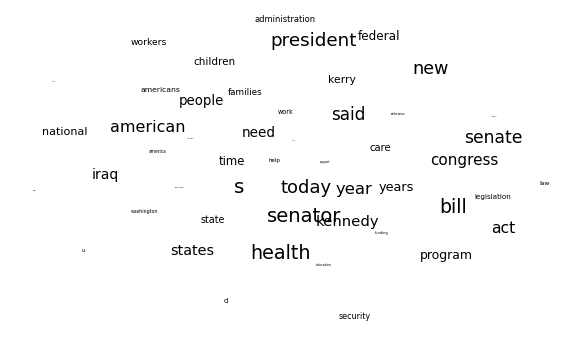

In [31]:
fig = plt.figure(figsize = (10,6))
ax = fig.add_subplot(111)
ax.set_frame_on(False)
plt.scatter(tsneWords[:, 0], tsneWords[:, 1], alpha = 0)#Making the points invisible 
for i, word in enumerate(targetWords):
    ax.annotate(word, (tsneWords[:, 0][i],tsneWords[:, 1][i]), size =  20 * (numWords - i) / numWords)
plt.xticks(())
plt.yticks(())
plt.show()

My visualization above puts ``said`` next to ``congress`` and ``bill`` near ``act``. ``health`` is beside ``care`` and ``national`` abuts ``security``.
random state involved in the PCA and TSNE

# Chinese examples
The following datafile is [available on Canvas](https://canvas.uchicago.edu/courses/39937/files/6674623/download). The Chinese word2vec model we use in this assignment was made with an old version of Gensim. If you have a version of '4.0.0' or later, you can run code like `!pip install gensim==3.8.3` (the last v3 of Gensim before v4) and restart your notebook to load that file. However, it's usually best to use the most recent stable versions of Python packages, so you can skip this section and go straight to the FastText section if you would like.

In [17]:
# !pip install gensim==3.8.3

In [32]:
import gensim
gensim.__version__

'4.1.2'

In [18]:
import gensim
gensim.__version__

'4.0.1'

In [ ]:
# If your version is 4.0.0 or later, this code will raise `AttributeError: Can't get attribute 'Vocab'...`
# You can load an old version of Gensim or skip to FastText.
model=gensim.models.Word2Vec.load('../data/1992embeddings_hs_new3.sg')

## analogy

King+man-Queen? A few examples based on a corpus of Chinese news. 

First, location analogy: **province -> capital**

In [7]:
mm = model.wv.most_similar(positive=[u'长沙',u'陕西'], negative=[u'湖南']) # Changsha + Shaanxi - Hunan
for m in mm:
    print(m[0],m[1])
    print("Xi'an")
    break

西安 0.36609965562820435
Xi'an


In [8]:
mm = model.wv.most_similar(positive=[u'广州',u'湖北'], negative=[u'广东']) # Guangzhou + Hubei - Guangdong
for m in mm:
    print(m[0],m[1])
    print("Wuhan")
    break

武汉 0.3677000403404236
Wuhan


Second, location analogy: **country -> capital**

In [11]:
mm = model.wv.most_similar(positive=[u'东京',u'美国'], negative=[u'日本']) # Tokyo + US - Japan
for m in mm:
    print(m[0],m[1])
    print("(Washington DC)")
    break

华盛顿 0.508813738822937
(Washington DC)


## similar words

In [9]:
word = u'社会主义'  #socialism
ss = model.wv.similar_by_word(word,topn=10)
print("the most similar words to " + word + " is: ")
for s in ss:
    print(s[0])
print("")

the most similar words to 社会主义 is: 
特色
市场经济
理论
建设
改革开放
马克思主义
党
经济体制
基本路线
现代化



In [10]:
#@title
word = u'玉米'  # corn
ss = model.wv.similar_by_word(word,topn=10)
print("the most similar words to " + word + " is: ")
for s in ss:
    print(s[0])
print("")

the most similar words to 玉米 is: 
小麦
水稻
作物
棉花
新品种
杂交
大豆
增产
栽培
农作物



## Adding more context - FastText

Since the original word2vec paper, there have followed a slew of word embedding related methods which innovate and build on them in many ways. One popular extension is FastText ([Bojanowski et al. 2017](https://arxiv.org/abs/1607.04606)), which uses sub-words to generate its vectors. Using subwords means that it is powerful in dealing with unknown words and sparse languages that otherwise have a rich morphological structure. These sub-words are incorporated into the previously skipgram and CBOW methods. For example, if the word is “which”, it is represented as the word itself along with a bag of constituent n-grams. If n=3, the representation looks like <wh, whi, hic, ich, ch>, and we learn a representation for each of these constituents, with the word “which” taking on the average value of these constituents. 

FastText can be used either via Gensim or the official package, and primarily has two functions - word representations, and text classification (Joulin et al. 2017). See below for code using the FastText package for playing with word representations, taken from their word representations tutorial (https://fasttext.cc/docs/en/unsupervised-tutorial.html).


In [34]:
! pip install fasttext

     |████████████████████████████████| 68 kB 5.5 MB/s eta 0:00:01
  Using cached pybind11-2.9.1-py2.py3-none-any.whl (211 kB)
  Created wheel for fasttext: filename=fasttext-0.9.2-cp38-cp38-macosx_10_15_x86_64.whl size=347463 sha256=6a4201ddae00d6821e27dc94022f868c8f2ec9bc47b6965704fce6ec4f661b56
  Stored in directory: /Users/mao_shiba/Library/Caches/pip/wheels/93/61/2a/c54711a91c418ba06ba195b1d78ff24fcaad8592f2a694ac94
Successfully built fasttext


### Representations with FastText

We will follow the instructions in the FastText tutorial to prepare our data, (Wikipedia). You can either follow the instructions on the page for setting the data, or download/copy it to drive it from this [Google Drive link](https://drive.google.com/file/d/12T3nNzf0a7tdhm1lVyfz9Ix9XVITFMCP/view?usp=sharing). 

In this example, we will be training a model - it is also possible to download and use the many pre-trained models.

In [ ]:
!pip install fasttext

In [36]:
import fasttext

In [35]:
# Replace with the path for where you have placed the 'fil9' file.
file_address = "/Users/mao_shiba/Downloads/fil9" 

In [37]:
model = fasttext.train_unsupervised(file_address)

Read 110M words words
Number of words:  418014
Number of labels: 0


Progress: 100.0% words/sec/thread:   49922 lr:  0.000000 avg.loss:  0.432130 ETA:   0h 0m 0s 83.9% words/sec/thread:   50014 lr:  0.008033 avg.loss:  0.510722 ETA:   0h 4m12s 84.0% words/sec/thread:   50012 lr:  0.008008 avg.loss:  0.510633 ETA:   0h 4m12s 84.0% words/sec/thread:   50011 lr:  0.008003 avg.loss:  0.510597 ETA:   0h 4m11s 84.4% words/sec/thread:   49925 lr:  0.007814 avg.loss:  0.509666 ETA:   0h 4m 6s 84.4% words/sec/thread:   49919 lr:  0.007812 avg.loss:  0.509660 ETA:   0h 4m 6s 84.4% words/sec/thread:   49909 lr:  0.007788 avg.loss:  0.509523 ETA:   0h 4m 5s 84.5% words/sec/thread:   49897 lr:  0.007773 avg.loss:  0.509464 ETA:   0h 4m 5s 84.6% words/sec/thread:   49891 lr:  0.007684 avg.loss:  0.509144 ETA:   0h 4m 2s 84.9% words/sec/thread:   49894 lr:  0.007529 avg.loss:  0.507610 ETA:   0h 3m57s 85.1% words/sec/thread:   49899 lr:  0.007447 avg.loss:  0.506667 ETA:   0h 3m54s 85.2% words/sec/thread:   49902 lr:  0.007413 avg.loss:  0.506271 ETA:   0h 3m53s words

While FastText is running, the progress and estimated time to completion is shown on your screen. Once the training finishes, the model variable contains information on the trained model, which you can use for querying:



In [38]:
model.words

['the',
 'of',
 'and',
 'in',
 'a',
 'to',
 'is',
 'The',
 'are',
 'for',
 'was',
 'as',
 'with',
 'by',
 'from',
 'that',
 'on',
 'or',
 'at',
 'an',
 'his',
 'have',
 'which',
 'it',
 'In',
 'be',
 'age',
 'also',
 'he',
 'has',
 'were',
 'not',
 'who',
 'had',
 'population',
 'this',
 'but',
 'km',
 'other',
 'there',
 'their',
 'one',
 'under',
 'A',
 'more',
 '18',
 'its',
 'all',
 'living',
 'first',
 'two',
 'income',
 'median',
 'been',
 'It',
 'out',
 'total',
 'United',
 'can',
 'For',
 'years',
 'they',
 'This',
 'He',
 'into',
 'There',
 'most',
 'city',
 'average',
 'As',
 'such',
 'used',
 '65',
 'some',
 'up',
 'no',
 'mi.',
 'New',
 'those',
 'many',
 'only',
 'made',
 'after',
 'than',
 'would',
 'when',
 'American',
 'family',
 'area',
 'any',
 'every',
 'States',
 'town',
 '100',
 'known',
 'links',
 'External',
 'her',
 'about',
 'County,',
 'located',
 'size',
 'below',
 'may',
 'between',
 'over',
 'time',
 '1',
 'families',
 'density',
 'line.',
 'called',
 'hous

It returns all words in the vocabulary, sorted by decreasing frequency. We can get the word vector by:



In [39]:
model.get_word_vector("the")

array([-0.04602171,  0.37335998,  0.17624637, -0.01593552, -0.08361395,
       -0.04418657,  0.17343237, -0.40200952,  0.37671193, -0.07767872,
       -0.09473751,  0.15658063, -0.24462396,  0.06274088, -0.3303394 ,
       -0.19584861,  0.03111605,  0.18222323,  0.11355972, -0.05256558,
        0.19034699, -0.26476407, -0.04734094,  0.07360854, -0.18247016,
       -0.06140347,  0.26069424,  0.09479532, -0.14136612, -0.02419508,
       -0.30358088, -0.05112446, -0.4628273 ,  0.16716363,  0.13822572,
       -0.19664559, -0.2986213 ,  0.18523735,  0.01731895, -0.3532249 ,
        0.22624163,  0.17495331, -0.5890943 ,  0.10888404,  0.3681816 ,
       -0.33374676,  0.05602506, -0.15142648,  0.2858038 , -0.31000912,
        0.16125153,  0.39676926,  0.1581369 , -0.4252155 ,  0.5420724 ,
        0.04276272, -0.16799764,  0.10582805,  0.03084226, -0.00947757,
       -0.06682112, -0.24106579,  0.0577469 ,  0.08815648, -0.0303598 ,
        0.08169305,  0.35184214, -0.46663088, -0.20600657,  0.06

In [41]:
model.save_model("result/fil9.bin")

In [ ]:
# when we want to use the model again
# model = fasttext.load_model("result/fil9.bin")

Let's now print some vectors.

In [42]:
[model.get_word_vector(x) for x in ["asparagus", "pidgey", "yellow"]]

[array([-0.5222276 ,  0.5369916 , -0.8013646 ,  0.07206502, -0.20329085,
        -0.06976362, -0.6679549 , -0.02571214,  0.17502631,  0.27412698,
        -0.14087023, -0.42876056,  0.26723376, -0.2719684 , -0.10860484,
        -0.59275115,  0.5560684 ,  0.00196698,  0.01925047, -0.5969042 ,
         0.08796213, -0.82296044,  0.56785804,  0.5171488 ,  0.07114615,
        -0.12087539, -0.21840751,  0.41454074, -0.4304316 , -0.39902687,
        -0.05771888, -0.344108  , -0.35390347,  0.15838444, -0.68264496,
         0.28633222, -0.11609085,  0.2277182 , -0.5446486 , -0.32010493,
         0.6127463 ,  0.05291921,  0.03237115, -0.22801328,  0.07610493,
        -0.58916986,  0.13409378,  0.24685532,  0.48946196,  0.24775372,
         0.62376857, -0.1251154 ,  0.00585771, -0.34966734,  0.74830174,
         0.9302015 , -0.06206424, -0.0335862 ,  0.28458276, -0.42565978,
         0.13246079,  0.13278224, -0.5568819 ,  0.46285933,  0.4957568 ,
        -0.07576983,  0.1895428 , -0.4138417 , -0.4

A nice feature is that you can also query for words that did not appear in your data! Indeed words are represented by the sum of their substrings. As long as the unknown word is made of known substrings, there is a representation of it!

As an example let's try with a misspelled word:



In [43]:
model.get_word_vector("enviroment")

array([-0.45854023,  0.34353146,  0.04246843,  0.1468096 , -0.01411953,
        0.04766056, -0.13955116, -0.44749174,  0.21052419, -0.00423831,
        0.04849819, -0.03287307,  0.12187457, -0.2707147 ,  0.31936696,
       -0.23806155,  0.14397742, -0.07756519,  0.29018   , -0.29286027,
       -0.13854408, -0.46353468,  0.28484523,  0.30589274,  0.44741878,
        0.12651195,  0.2722702 ,  0.40125278, -0.05809698, -0.2985128 ,
       -0.12851985, -0.06750852, -0.5821196 ,  0.30066144, -0.03454071,
       -0.14738533, -0.18005754, -0.13614771,  0.22183567, -0.33307242,
       -0.02969048, -0.0453173 , -0.5274714 , -0.23732771,  0.3741277 ,
       -0.20154527,  0.28079042,  0.5312219 ,  0.0567975 , -0.10748189,
        0.25933287,  0.11969326,  0.36182654,  0.11681188,  0.11709508,
        0.14495297,  0.06028367,  0.33579335, -0.31405398, -0.07448916,
       -0.02569243,  0.27569312, -0.09543128, -0.00365608,  0.17527561,
        0.00299266,  0.5194021 , -0.26098955, -0.41207758,  0.19

In [ ]:
# Add FastText here

## <font color="red">*Exercise 1*</font>

<font color="red">Construct cells immediately below this that embed documents related to your final project using at least two different specification of `word2vec` and/or `fasttext`, and visualize them each with two separate visualization layout specifications (e.g., TSNE, PCA). Then interrogate critical word vectors within your corpus in terms of the most similar words, analogies, and other additions and subtractions that reveal the structure of similarity and difference within your semantic space. What does this pattern reveal about the semantic organization of words in your corpora? Which estimation and visualization specification generate the most insight and appear the most robustly supported and why? 

<font color="red">***Stretch***: Explore different vector calculations beyond addition and subtraction, such as multiplication, division or some other function. What does this exploration reveal about the semantic structure of your corpus?

In [3]:
# !pip install jieba
import jieba
import re

In [34]:
comments = pd.read_csv('/Users/mao_shiba/Downloads/moviedata-10m/moviedata-10m/comments.csv')
comments = comments.loc[:, ['COMMENT_TIME','MOVIE_ID', 'VOTES', 'CONTENT']]
comments['CONTENT'].replace('[^\u4e00-\u9fa5A-Za-z0-9]+', ' ', regex = True, inplace=True)
comments = comments[:100000] # we use 100k comments

In [4]:
from langconv import *
# a converter that translate traditional Chinese into simplified Chinese. Thanks to Roc-xb! https://blog.csdn.net/qq_19309473/article/details/110952091

In [5]:
# source: https://github.com/goto456/stopwords/blob/master/cn_stopwords.txt
stop_words = open("/Users/mao_shiba/Downloads/stopwords-master/cn_stopwords customized.txt", 'r', encoding='utf-8').read()
stop_words_lst = stop_words.split('\n')

In [35]:
simplify = lambda x: Converter("zh-hans").convert(x)
comments['simplified'] = comments['CONTENT'].apply(simplify)
comments.head()

,COMMENT_TIME,MOVIE_ID,VOTES,CONTENT,simplified
0,2018-09-05 19:42:07,5113101,0,480p 画质不高 黑白 y,480p 画质不高 黑白 y
1,2019-07-09 14:52:07,5113101,0,毫无看点 黑白画质 一个男人孤独的心理情景历程 疯疯癫癫 没有任何恐怖的成分 这应该是剧情片吧,毫无看点 黑白画质 一个男人孤独的心理情景历程 疯疯癫癫 没有任何恐怖的成分 这应该是剧情片吧
2,2010-11-05 22:15:44,3718526,0,上吊那裡超好笑 可惜最後報告近況的旁白大扣分,上吊那里超好笑 可惜最后报告近况的旁白大扣分
3,2010-06-20 02:12:50,3718526,0,上海国际电影节观摩片,上海国际电影节观摩片
4,2011-04-09 22:10:13,3718526,0,,


In [50]:
cut_words = lambda x: [text for text in jieba.lcut(x) if text not in stop_words]
comments['cut_words'] = comments['simplified'].apply(cut_words)
comments.head()

,COMMENT_TIME,MOVIE_ID,VOTES,CONTENT,simplified,cut_words
0,2018-09-05 19:42:07,5113101,0,480p 画质不高 黑白 y,480p 画质不高 黑白 y,"[480p, 画质, 不高, 黑白, y]"
1,2019-07-09 14:52:07,5113101,0,毫无看点 黑白画质 一个男人孤独的心理情景历程 疯疯癫癫 没有任何恐怖的成分 这应该是剧情片吧,毫无看点 黑白画质 一个男人孤独的心理情景历程 疯疯癫癫 没有任何恐怖的成分 这应该是剧情片吧,"[毫无, 看点, 黑白, 画质, 一个, 男人, 孤独, 心理, 情景, 历程, 疯疯癫癫,..."
2,2010-11-05 22:15:44,3718526,0,上吊那裡超好笑 可惜最後報告近況的旁白大扣分,上吊那里超好笑 可惜最后报告近况的旁白大扣分,"[上吊, 超, 好笑, 可惜, 最后, 报告, 近况, 旁白, 扣分]"
3,2010-06-20 02:12:50,3718526,0,上海国际电影节观摩片,上海国际电影节观摩片,"[上海, 国际, 电影节, 观摩, 片]"
4,2011-04-09 22:10:13,3718526,0,,,[]


In [51]:
commentsW2V = gensim.models.word2vec.Word2Vec(comments['cut_words'].to_list(), sg=0)

In [39]:
commentsW2V.save("commentsWORD2Vec_100K")

In [10]:
commentsW2V = gensim.models.Word2Vec.load("/Users/mao_shiba/Desktop/2021-Content-Analysis/2022-Content-Analysis-HW/commentsWORD2Vec_100K")

In [40]:
commentsW2V.wv.most_similar(u'搞笑') # means funny/hilarious

[('好笑', 0.9291087985038757),
 ('无厘头', 0.9259297251701355),
 ('好玩', 0.9258910417556763),
 ('段子', 0.8899359107017517),
 ('欢乐', 0.8878933787345886),
 ('吓人', 0.881788969039917),
 ('桥段', 0.8743031620979309),
 ('笑点', 0.8620465397834778),
 ('来劲', 0.8465590476989746),
 ('梗', 0.8464322090148926)]

The first word also means funny/hilarious

In [41]:
commentsW2V.wv.most_similar(u'爱情') # means love

[('亲情', 0.9070714712142944),
 ('友情', 0.8969853520393372),
 ('单纯', 0.8621853590011597),
 ('悲剧', 0.8377240896224976),
 ('残酷', 0.8329243063926697),
 ('婚姻', 0.8309231996536255),
 ('现实', 0.8307872414588928),
 ('成长', 0.8228757381439209),
 ('家庭', 0.8203684687614441),
 ('青春', 0.8200092911720276)]

The first word means love between family members/kinship, second word means friendship

In [42]:
commentsW2V.wv.most_similar(positive=['电影', '爱情'], negative=['影片']) # positive = movie, love, negative='movie'(film)

[('青春', 0.8638702034950256),
 ('友情', 0.7569748163223267),
 ('总是', 0.7407435774803162),
 ('美好', 0.7335696816444397),
 ('单纯', 0.7310614585876465),
 ('少年', 0.7281846404075623),
 ('纯真', 0.7101383805274963),
 ('拯救', 0.7095749378204346),
 ('温暖', 0.7037698030471802),
 ('地球', 0.6919862627983093)]

The first word means youth! Oh! These reviews tend to associate love with youth/young people! Or at least it means that most love movies are telling love stories of young people.

In [44]:
numWords = 50
targetWords = commentsW2V.wv.index_to_key[:numWords]
wordsSubMatrix = []
for word in targetWords:
    wordsSubMatrix.append(commentsW2V.wv[word])
wordsSubMatrix = np.array(wordsSubMatrix)

In [45]:
pcaWords = sklearn.decomposition.PCA(n_components = 50).fit(wordsSubMatrix)
reducedPCA_data = pcaWords.transform(wordsSubMatrix)
#T-SNE is theoretically better, but you should experiment
tsneWords = sklearn.manifold.TSNE(n_components = 2).fit_transform(reducedPCA_data)

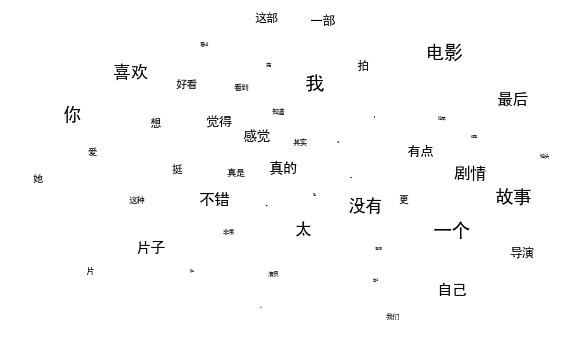

In [46]:
from matplotlib import font_manager as fm, rcParams

plt.rcParams['font.sans-serif']=['SimHei'] #显示中文标签
plt.rcParams['axes.unicode_minus']=False   #这两行需要手动设置

fig = plt.figure(figsize = (10,6))
ax = fig.add_subplot(111)
ax.set_frame_on(False)
plt.scatter(tsneWords[:, 0], tsneWords[:, 1], alpha = 0)#Making the points invisible 
for i, word in enumerate(targetWords):
    ax.annotate(word, (tsneWords[:, 0][i],tsneWords[:, 1][i]), size =  20 * (numWords - i) / numWords)
plt.xticks(())
plt.yticks(())
plt.show()

In the plot, we can find people tend to give more positive comments like ‘喜欢’（like）and ‘不错’（not bad）. Another point is that '剧情'plot and ‘故事’story are emphasized and they're close to each other. Since I didn't remove personal pronouns in the stop words list, we can explore gender related issues. Next, I will try to find some patterns about gender and plot. 

In [52]:
commentsW2V.wv.most_similar(positive=['他', '主角'], negative=['她']) # positive = he, protagonist, negative=she

KeyError: "Key '他' not present"

That's really interesting. I modified the stop words text to make sure that 'she' and 'he' are not included. But it turned out that 'he' didn't exist in the 100K comments!  

In [81]:
commentsW2V.wv.most_similar(positive=['剧情', '喜欢'], negative=['讨厌']) # positive = plot, like, negative=dislike

[('节奏', 0.7359270453453064),
 ('整体', 0.7351868748664856),
 ('情节', 0.7351126074790955),
 ('氛围', 0.731513261795044),
 ('气氛', 0.7286598086357117),
 ('营造', 0.7066499590873718),
 ('故事情节', 0.7019482254981995),
 ('流畅', 0.69172602891922),
 ('色调', 0.6894595623016357),
 ('剪辑', 0.6853305697441101)]

The first word means tempo/pacing.

In [66]:
commentsW2V.wv.most_similar('节奏') # tempo/pacing

[('剪辑', 0.9279853701591492),
 ('拖沓', 0.9250801801681519),
 ('略显', 0.9244438409805298),
 ('整体', 0.9231067299842834),
 ('冗长', 0.92015141248703),
 ('不足', 0.9162319302558899),
 ('气氛', 0.9138264060020447),
 ('太慢', 0.9127314686775208),
 ('营造', 0.904495120048523),
 ('悬念', 0.9019396901130676)]

The second and fifth words mean sluggish/tedious.  It shows what audiences care about most and hate most. 

# Doc2Vec

Instead of just looking at just how words embed within in the space, we can look at how the different documents relate to each other within the space. First lets load our data--abstracts of most U.S. physics papers from the 1950s.

In [ ]:
apsDF = pd.read_csv('../data/APSabstracts1950s.csv', index_col = 0)
apsDF[:10]

We will load these as documents into Word2Vec, but first we need to normalize and pick some tags.

In [ ]:
keywords = ['photomagnetoelectric', 'quantum', 'boltzmann', 'proton', 'positron', 'feynman', 'classical', 'relativity']

In [ ]:
apsDF['tokenized_words'] = apsDF['abstract'].apply(lambda x: lucem_illud.word_tokenize(x))
apsDF['normalized_words'] = apsDF['tokenized_words'].apply(lambda x: lucem_illud.normalizeTokens(x, lemma=False))

In [ ]:
taggedDocs = []
for index, row in apsDF.iterrows():
    #Just doing a simple keyword assignment
    docKeywords = [s for s in keywords if s in row['normalized_words']]
    docKeywords.append(row['copyrightYear'])
    docKeywords.append(row['doi']) #This lets us extract individual documnets since doi's are unique
    taggedDocs.append(gensim.models.doc2vec.LabeledSentence(words = row['normalized_words'], tags = docKeywords))
apsDF['TaggedAbstracts'] = taggedDocs

Now we can train a Doc2Vec model:

In [ ]:
apsD2V = gensim.models.doc2vec.Doc2Vec(apsDF['TaggedAbstracts'], size = 100) #Limiting to 100 dimensions

We can get vectors for the tags/documents, just as we did with words. Documents are actually the centroids (high dimensional average points) of their words. 

In [ ]:
apsD2V.docvecs[1952]

The words can still be accessed in the same way:

In [ ]:
apsD2V['atom']

We can still use the ``most_similar`` command to perform simple semantic equations:

In [ ]:
apsD2V.most_similar(positive = ['atom','electrons'], negative = ['electron'], topn = 1)

This is interesting. **Electron** is to **electrons** as **atom** is to **atoms**. Another way to understand this, developed below is: **electrons - electron** induces a singular to plural dimension, so when we subtract **electron** from **atom** and add **electrons**, we get **atoms**! 

In [ ]:
apsD2V.most_similar(positive = ['einstein','law'], negative = ['equation'], topn = 1)

In other words **Einstein** minus **equation** plus **law** equals **Meissner**--Walthur Meissner studied mechanical engineering and physics ... and was more likely to produce a "law" than a "equation", like the Meissner effect, the damping of the magnetic field in superconductors. If we built our word-embedding with a bigger corpus like the entire arXiv, a massive repository of physics preprints, we would see many more such relationships like **gravity - Newton + Einstein = relativity**.

We can also compute all of these *by hand*--explicitly wth vector algebra: 

In [ ]:
sklearn.metrics.pairwise.cosine_similarity(apsD2V['electron'].reshape(1,-1), apsD2V['positron'].reshape(1,-1))
#We reorient the vectors with .reshape(1, -1) so that they can be computed without a warning in sklearn

In the doc2vec model, the documents have vectors just as the words do, so that we can compare documents with each other and also with words (similar to how a search engine locates a webpage with a query). First, we will calculate the distance between a word and documents in the dataset:

In [ ]:
apsD2V.docvecs.most_similar([ apsD2V['electron'] ], topn=5 )

If we search for the first of these on the web (these are doi codes), we find the following...a pretty good match:

In [ ]:
from IPython.display import Image
Image("../data/PhysRev.98.875.jpg", width=1000, height=1000)

Now let's go the other way around and find words most similar to this document:

In [ ]:
apsD2V.most_similar( [ apsD2V.docvecs['10.1103/PhysRev.98.875'] ], topn=5) 

We can even look for documents most like a query composed of multiple words:

In [ ]:
apsD2V.docvecs.most_similar([ apsD2V['electron']+apsD2V['positron']+apsD2V['neutron']], topn=5 )

Now let's plot some words and documents against one another with a heatmap:

In [ ]:
heatmapMatrix = []
for tagOuter in keywords:
    column = []
    tagVec = apsD2V.docvecs[tagOuter].reshape(1, -1)
    for tagInner in keywords:
        column.append(sklearn.metrics.pairwise.cosine_similarity(tagVec, apsD2V.docvecs[tagInner].reshape(1, -1))[0][0])
    heatmapMatrix.append(column)
heatmapMatrix = np.array(heatmapMatrix)

In [ ]:
fig, ax = plt.subplots()
hmap = ax.pcolor(heatmapMatrix, cmap='terrain')
cbar = plt.colorbar(hmap)

cbar.set_label('cosine similarity', rotation=270)
a = ax.set_xticks(np.arange(heatmapMatrix.shape[1]) + 0.5, minor=False)
a = ax.set_yticks(np.arange(heatmapMatrix.shape[0]) + 0.5, minor=False)

a = ax.set_xticklabels(keywords, minor=False, rotation=270)
a = ax.set_yticklabels(keywords, minor=False)

Now let's look at a heatmap of similarities between the first ten documents in the corpus:

In [ ]:
targetDocs = apsDF['doi'][:10]

heatmapMatrixD = []

for tagOuter in targetDocs:
    column = []
    tagVec = apsD2V.docvecs[tagOuter].reshape(1, -1)
    for tagInner in targetDocs:
        column.append(sklearn.metrics.pairwise.cosine_similarity(tagVec, apsD2V.docvecs[tagInner].reshape(1, -1))[0][0])
    heatmapMatrixD.append(column)
heatmapMatrixD = np.array(heatmapMatrixD)

In [ ]:
fig, ax = plt.subplots()
hmap = ax.pcolor(heatmapMatrixD, cmap='terrain')
cbar = plt.colorbar(hmap)

cbar.set_label('cosine similarity', rotation=270)
a = ax.set_xticks(np.arange(heatmapMatrixD.shape[1]) + 0.5, minor=False)
a = ax.set_yticks(np.arange(heatmapMatrixD.shape[0]) + 0.5, minor=False)

a = ax.set_xticklabels(targetDocs, minor=False, rotation=270)
a = ax.set_yticklabels(targetDocs, minor=False)

Now let's look at a heatmap of similarities between the first ten documents and our keywords:

In [ ]:
heatmapMatrixC = []

for tagOuter in targetDocs:
    column = []
    tagVec = apsD2V.docvecs[tagOuter].reshape(1, -1)
    for tagInner in keywords:
        column.append(sklearn.metrics.pairwise.cosine_similarity(tagVec, apsD2V.docvecs[tagInner].reshape(1, -1))[0][0])
    heatmapMatrixC.append(column)
heatmapMatrixC = np.array(heatmapMatrixC)

In [ ]:
fig, ax = plt.subplots()
hmap = ax.pcolor(heatmapMatrixC, cmap='terrain')
cbar = plt.colorbar(hmap)

cbar.set_label('cosine similarity', rotation=270)
a = ax.set_xticks(np.arange(heatmapMatrixC.shape[1]) + 0.5, minor=False)
a = ax.set_yticks(np.arange(heatmapMatrixC.shape[0]) + 0.5, minor=False)

a = ax.set_xticklabels(keywords, minor=False, rotation=270)
a = ax.set_yticklabels(targetDocs, minor=False)

We will save the model in case we would like to use it again.

In [ ]:
apsD2V.save('apsW2V')

We can later load it:

In [ ]:
#apsD2V = gensim.models.word2vec.Word2Vec.load('data/apsW2V')

## <font color="red">*Exercise 2*</font>

<font color="red">Construct cells immediately below this that embed documents related to your final project using `doc2vec`, and explore the relationship between different documents and the word vectors you analyzed in the last exercise. Consider the most similar words to critical documents, analogies (doc _x_ + word _y_), and other additions and subtractions that reveal the structure of similarity and difference within your semantic space. What does this pattern reveal about the documentary organization of your semantic space?

The results in this exercise may not be very meaningful due to the sample size. In the exercise 1 I used 100k comments. However, I actually only used roughly 2000 comments in this exercise.  At first I tried to use 100K comments. My jupyter notebook kernal broken down. Then I tried to use Colab(I'm a Pro member).Its kernal collapsed as well as I used up all the allocated RAM. Even though I used 10k comments to train the model, the code ran for a very time with no results.

In [102]:
commentsDF = pd.read_csv('/Users/mao_shiba/Downloads/moviedata-10m/moviedata-10m/comments.csv')
commentsDF = commentsDF.loc[:, ['COMMENT_ID','COMMENT_TIME','MOVIE_ID', 'VOTES', 'CONTENT']]
commentsDF['CONTENT'].replace('[^\u4e00-\u9fa5A-Za-z0-9]+', ' ', regex = True, inplace=True)
commentsDF = commentsDF[:10000] # we use 10k comments

In [103]:
simplify = lambda x: Converter("zh-hans").convert(x)
commentsDF['simplified'] = commentsDF['CONTENT'].apply(simplify)
commentsDF.head()

,COMMENT_ID,COMMENT_TIME,MOVIE_ID,VOTES,CONTENT,simplified
0,1359352573,2018-09-05 19:42:07,5113101,0,480p 画质不高 黑白 y,480p 画质不高 黑白 y
1,1598245094,2019-07-09 14:52:07,5113101,0,毫无看点 黑白画质 一个男人孤独的心理情景历程 疯疯癫癫 没有任何恐怖的成分 这应该是剧情片吧,毫无看点 黑白画质 一个男人孤独的心理情景历程 疯疯癫癫 没有任何恐怖的成分 这应该是剧情片吧
2,311937819,2010-11-05 22:15:44,3718526,0,上吊那裡超好笑 可惜最後報告近況的旁白大扣分,上吊那里超好笑 可惜最后报告近况的旁白大扣分
3,262536568,2010-06-20 02:12:50,3718526,0,上海国际电影节观摩片,上海国际电影节观摩片
4,376372407,2011-04-09 22:10:13,3718526,0,,


In [104]:
cut_words = lambda x: [text for text in jieba.lcut(x) if text not in stop_words]
commentsDF['cut_words'] = commentsDF['simplified'].apply(cut_words)

Building prefix dict from the default dictionary ...
Loading model from cache /var/folders/cl/g60_skzn66v711f0ctx1nw_w0000gn/T/jieba.cache
Loading model cost 0.641 seconds.
Prefix dict has been built successfully.


In [105]:
new_commentsDF = pd.DataFrame(commentsDF.groupby("MOVIE_ID")["cut_words"].sum())
new_commentsDF['MOVIE_ID'] = new_commentsDF.index
new_commentsDF

,cut_words,MOVIE_ID
MOVIE_ID,,
1292899,"[想象, 美, 很多年, youtube, 看过, 片花, MEL, DIANE, 我, 美...",1292899
1293331,"[一个, 没有, 字幕, 版本, 喜欢, 里面, 古堡, 服饰, 死亡, 顺序, 女, 男,...",1293331
1293915,"[空有, 闹腾, 不好, 笑, 皆, 傻, 叉, 行事, 逻辑, 埃及, 盗宝, 探宝, 直...",1293915
1294181,"[北野, 老头, 总是, 自己, 拍得, 牛, 逼, 惨烈, 最后, 重复, 一遍, 一遍,...",1294181
1295201,"[一种, 生活, 状态, 理想主义者, 不堪, 窘迫, 游走, 晚间, 赌场, 夜店, 追逐...",1295201
...,...,...
30272988,"[视觉, 引导, 不错, 节奏, 有点, 跟不上, 我, 觉得, 需要, 腾出, 一点, 时...",30272988
30291500,"[贴, 炸, LC, 甜到, 爆, 11, 区, 大佬, 快, 剧透, 我, 不要, 你, ...",30291500
30316466,"[故事, 人物, 需要, 更, 突出, 才行, 别斯兰, 事件, 事, 高加索, 风景, 美...",30316466


In [106]:
keywords = ['剧情','节奏','喜欢','讨厌','爱情', '搞笑','男人', '女人', '主角', '配角']
# plot, tempo, like, dislike, love, humor, man, wowan, protagonist, support

In [109]:
taggedDocs = []
for index, row in new_commentsDF.iterrows():
    #Just doing a simple keyword assignment
    docKeywords = [s for s in keywords if s in row['cut_words']]
    docKeywords.append(row['MOVIE_ID'])
    taggedDocs.append(gensim.models.doc2vec.TaggedDocument(words = row['cut_words'], tags = docKeywords))
new_commentsDF['TaggedComment'] = taggedDocs
new_commentsDF

,cut_words,MOVIE_ID,TaggedComment
MOVIE_ID,,,
1292899,"[想象, 美, 很多年, youtube, 看过, 片花, MEL, DIANE, 我, 美...",1292899,"([想象, 美, 很多年, youtube, 看过, 片花, MEL, DIANE, 我, ..."
1293331,"[一个, 没有, 字幕, 版本, 喜欢, 里面, 古堡, 服饰, 死亡, 顺序, 女, 男,...",1293331,"([一个, 没有, 字幕, 版本, 喜欢, 里面, 古堡, 服饰, 死亡, 顺序, 女, 男..."
1293915,"[空有, 闹腾, 不好, 笑, 皆, 傻, 叉, 行事, 逻辑, 埃及, 盗宝, 探宝, 直...",1293915,"([空有, 闹腾, 不好, 笑, 皆, 傻, 叉, 行事, 逻辑, 埃及, 盗宝, 探宝, ..."
1294181,"[北野, 老头, 总是, 自己, 拍得, 牛, 逼, 惨烈, 最后, 重复, 一遍, 一遍,...",1294181,"([北野, 老头, 总是, 自己, 拍得, 牛, 逼, 惨烈, 最后, 重复, 一遍, 一遍..."
1295201,"[一种, 生活, 状态, 理想主义者, 不堪, 窘迫, 游走, 晚间, 赌场, 夜店, 追逐...",1295201,"([一种, 生活, 状态, 理想主义者, 不堪, 窘迫, 游走, 晚间, 赌场, 夜店, 追..."
...,...,...,...
30272988,"[视觉, 引导, 不错, 节奏, 有点, 跟不上, 我, 觉得, 需要, 腾出, 一点, 时...",30272988,"([视觉, 引导, 不错, 节奏, 有点, 跟不上, 我, 觉得, 需要, 腾出, 一点, ..."
30291500,"[贴, 炸, LC, 甜到, 爆, 11, 区, 大佬, 快, 剧透, 我, 不要, 你, ...",30291500,"([贴, 炸, LC, 甜到, 爆, 11, 区, 大佬, 快, 剧透, 我, 不要, 你,..."
30316466,"[故事, 人物, 需要, 更, 突出, 才行, 别斯兰, 事件, 事, 高加索, 风景, 美...",30316466,"([故事, 人物, 需要, 更, 突出, 才行, 别斯兰, 事件, 事, 高加索, 风景, ..."


In [112]:
# we only use reviews from 50 movies
new_commentsD2V = gensim.models.doc2vec.Doc2Vec(new_commentsDF['TaggedComment'][:50], vector_size = 100) 
#Limiting to 100 dimensions

In [ ]:
# new_commentsD2V = gensim.models.word2vec.Word2Vec.load('/Users/mao_shiba/Desktop/2021-Content-Analysis/2022-Content-Analysis-HW/commentsD2V_50movies')

In [114]:
new_commentsD2V.wv.most_similar(positive = ['电影','爱情'], negative = ['影片'], topn = 5)

[('我', 0.9941183924674988),
 ('伯格曼', 0.9936649203300476),
 ('恋爱', 0.9935740828514099),
 ('她', 0.9912107586860657),
 ('成为', 0.9899122714996338)]

In [115]:
new_commentsD2V.docvecs.most_similar([ new_commentsD2V['爱情'] ], topn=5 )

[(1300319, 0.9752517938613892),
 (1419516, 0.9688779711723328),
 (1766114, 0.967559278011322),
 (1862261, 0.9667789936065674),
 (1297462, 0.9661474823951721)]

In [116]:
heatmapMatrix = []
for tagOuter in keywords:
    column = []
    tagVec = new_commentsD2V.docvecs[tagOuter].reshape(1, -1)
    for tagInner in keywords:
        column.append(sklearn.metrics.pairwise.cosine_similarity(tagVec, new_commentsD2V.docvecs[tagInner].reshape(1, -1))[0][0])
    heatmapMatrix.append(column)
heatmapMatrix = np.array(heatmapMatrix)

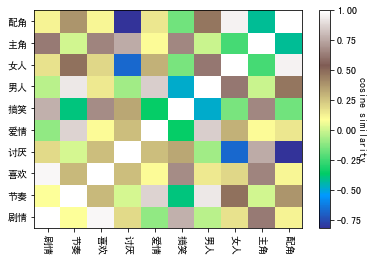

In [117]:
fig, ax = plt.subplots()
hmap = ax.pcolor(heatmapMatrix, cmap='terrain')
cbar = plt.colorbar(hmap)

cbar.set_label('cosine similarity', rotation=270)
a = ax.set_xticks(np.arange(heatmapMatrix.shape[1]) + 0.5, minor=False)
a = ax.set_yticks(np.arange(heatmapMatrix.shape[0]) + 0.5, minor=False)

a = ax.set_xticklabels(keywords, minor=False, rotation=270)
a = ax.set_yticklabels(keywords, minor=False)

In [118]:
targetDocs = new_commentsDF['MOVIE_ID'][:10]

heatmapMatrixD = []

for tagOuter in targetDocs:
    column = []
    tagVec = new_commentsD2V.docvecs[tagOuter].reshape(1, -1)
    for tagInner in targetDocs:
        column.append(sklearn.metrics.pairwise.cosine_similarity(tagVec, new_commentsD2V.docvecs[tagInner].reshape(1, -1))[0][0])
    heatmapMatrixD.append(column)
heatmapMatrixD = np.array(heatmapMatrixD)

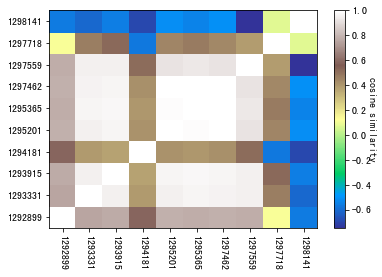

In [119]:
fig, ax = plt.subplots()
hmap = ax.pcolor(heatmapMatrixD, cmap='terrain')
cbar = plt.colorbar(hmap)

cbar.set_label('cosine similarity', rotation=270)
a = ax.set_xticks(np.arange(heatmapMatrixD.shape[1]) + 0.5, minor=False)
a = ax.set_yticks(np.arange(heatmapMatrixD.shape[0]) + 0.5, minor=False)

a = ax.set_xticklabels(targetDocs, minor=False, rotation=270)
a = ax.set_yticklabels(targetDocs, minor=False)

In [120]:
heatmapMatrixC = []

for tagOuter in targetDocs:
    column = []
    tagVec = new_commentsD2V.docvecs[tagOuter].reshape(1, -1)
    for tagInner in keywords:
        column.append(sklearn.metrics.pairwise.cosine_similarity(tagVec, new_commentsD2V.docvecs[tagInner].reshape(1, -1))[0][0])
    heatmapMatrixC.append(column)
heatmapMatrixC = np.array(heatmapMatrixC)

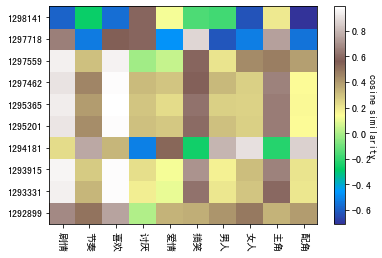

In [121]:
fig, ax = plt.subplots()
hmap = ax.pcolor(heatmapMatrixC, cmap='terrain')
cbar = plt.colorbar(hmap)

cbar.set_label('cosine similarity', rotation=270)
a = ax.set_xticks(np.arange(heatmapMatrixC.shape[1]) + 0.5, minor=False)
a = ax.set_yticks(np.arange(heatmapMatrixC.shape[0]) + 0.5, minor=False)

a = ax.set_xticklabels(keywords, minor=False, rotation=270)
a = ax.set_yticklabels(targetDocs, minor=False)

In this exercise, I aggregated comments of same movie together, tring to find movie-level comments patterns. But the results are not satisfying due to the small sample size. The most disntive pattern from figure2 and 3 is moive 1298141 is really different from other movies and are less relevant to most keywords compared to other movies. Searching on movie.douban.com, I found that it's **a very old love movie from Sweden**. It's indeed very different from other movies. The second movie, is a horror movie. It makes sense that many people '喜欢'love it and also many people ‘讨厌’dislike it and it's irrelevant to love. Though rudimentary, this attemp proved that this Doc2Vec approach is very useful for finding movie-level comments patterns. 

# Projection

We can also project word vectors to an arbitray semantic dimension. To demonstrate this possibility, let's first load a model trained with New York Times news articles. 

In [ ]:
nytimes_model = gensim.models.KeyedVectors.load_word2vec_format('../data/nytimes_cbow.reduced.txt')

First we can visualize with dimension reduction

In [ ]:
#words to create dimensions
tnytTargetWords = ['man','him','he', 'woman', 'her', 'she', 'black','blacks','African', 'white', 'whites', 'Caucasian', 'rich', 'richer', 'richest', 'expensive', 'wealthy', 'poor', 'poorer', 'poorest', 'cheap', 'inexpensive']
#words we will be mapping
tnytTargetWords += ["doctor","lawyer","plumber","scientist","hairdresser", "nanny","carpenter","entrepreneur","musician","writer", "banker","poet","nurse", "steak", "bacon", "croissant", "cheesecake", "salad", "cheeseburger", "vegetables", "beer", "wine", "pastry", "basketball", "baseball", "boxing", "softball", "volleyball", "tennis", "golf", "hockey", "soccer"]


wordsSubMatrix = []
for word in tnytTargetWords:
    wordsSubMatrix.append(nytimes_model[word])
wordsSubMatrix = np.array(wordsSubMatrix)
#wordsSubMatrix

In [ ]:
pcaWordsNYT = sklearn.decomposition.PCA(n_components = 50).fit(wordsSubMatrix)
reducedPCA_dataNYT = pcaWordsNYT.transform(wordsSubMatrix)
#T-SNE is theoretically better, but you should experiment
tsneWordsNYT = sklearn.manifold.TSNE(n_components = 2).fit_transform(reducedPCA_dataNYT)

In [ ]:
fig = plt.figure(figsize = (20,12))
ax = fig.add_subplot(111)
ax.set_frame_on(False)
plt.scatter(tsneWordsNYT[:, 0], tsneWordsNYT[:, 1], alpha = 0) #Making the points invisible
for i, word in enumerate(tnytTargetWords):
    ax.annotate(word, (tsneWordsNYT[:, 0][i],tsneWordsNYT[:, 1][i]), size =  50 * (len(tnytTargetWords) - i) / len(tnytTargetWords))
plt.xticks(())
plt.yticks(())
plt.show()

Define some convenient functions for getting dimensions. 

In [39]:
def normalize(vector):
    normalized_vector = vector / np.linalg.norm(vector)
    return normalized_vector

def dimension(model, positives, negatives):
    diff = sum([normalize(model[x]) for x in positives]) - sum([normalize(model[y]) for y in negatives])
    return diff

Let's calculate three dimensions: gender, race, and class.

In [ ]:
Gender = dimension(nytimes_model, ['man','him','he'], ['woman', 'her', 'she'])
Race = dimension(nytimes_model, ['black','blacks','African'], ['white', 'whites', 'Caucasian'])
Class = dimension(nytimes_model, ['rich', 'richer', 'richest', 'expensive', 'wealthy'], ['poor', 'poorer', 'poorest', 'cheap', 'inexpensive'])

Here we have some words.

In [ ]:
Occupations = ["doctor","lawyer","plumber","scientist","hairdresser", "nanny","carpenter","entrepreneur","musician","writer", "banker","poet","nurse"]

Foods = ["steak", "bacon", "croissant", "cheesecake", "salad", "cheeseburger", "vegetables", "beer", "wine", "pastry"]

Sports  = ["basketball", "baseball", "boxing", "softball", "volleyball", "tennis", "golf", "hockey", "soccer"]

Define a function to project words in a word list to each of the three dimensions.

In [46]:
def makeDF(model, word_list):
    g = []
    r = []
    c = []
    for word in word_list:
        g.append(sklearn.metrics.pairwise.cosine_similarity(model[word].reshape(1,-1), Gender.reshape(1,-1))[0][0])
        c.append(sklearn.metrics.pairwise.cosine_similarity(model[word].reshape(1,-1), Class.reshape(1,-1))[0][0])
    df = pd.DataFrame({'gender': g, 'class': c}, index = word_list)
    return df

Get the projections.

In [ ]:
OCCdf = makeDF(nytimes_model, Occupations) 
Fooddf = makeDF(nytimes_model, Foods)
Sportsdf = makeDF(nytimes_model, Sports)

Define some useful functions for plotting.

In [41]:
def Coloring(Series):
    x = Series.values
    y = x-x.min()
    z = y/y.max()
    c = list(plt.cm.rainbow(z))
    return c

def PlotDimension(ax,df, dim):
    ax.set_frame_on(False)
    ax.set_title(dim, fontsize = 20)
    colors = Coloring(df[dim])
    for i, word in enumerate(df.index):
        ax.annotate(word, (0, df[dim][i]), color = colors[i], alpha = 0.6, fontsize = 12)
    MaxY = df[dim].max()
    MinY = df[dim].min()
    plt.ylim(MinY,MaxY)
    plt.yticks(())
    plt.xticks(())

Plot the occupational words in each of the three dimensions.

In [ ]:
fig = plt.figure(figsize = (12,4))
ax1 = fig.add_subplot(131)
PlotDimension(ax1, OCCdf, 'gender')
ax2 = fig.add_subplot(132)
PlotDimension(ax2, OCCdf, 'race')
ax3 = fig.add_subplot(133)
PlotDimension(ax3, OCCdf, 'class')
plt.show()

Foods:

In [ ]:
fig = plt.figure(figsize = (12,4))
ax1 = fig.add_subplot(131)
PlotDimension(ax1, Fooddf, 'gender')
ax2 = fig.add_subplot(132)
PlotDimension(ax2, Fooddf, 'race')
ax3 = fig.add_subplot(133)
PlotDimension(ax3, Fooddf, 'class')
plt.show()

Sports:

In [ ]:
fig = plt.figure(figsize = (12,4))
ax1 = fig.add_subplot(131)
PlotDimension(ax1, Sportsdf, 'gender')
ax2 = fig.add_subplot(132)
PlotDimension(ax2, Sportsdf, 'race')
ax3 = fig.add_subplot(133)
PlotDimension(ax3, Sportsdf, 'class')
plt.show()

## <font color="red">*Exercise 3*</font>

<font color="red">Construct cells immediately below this that embed documents related to your final project, then generate meaningful semantic dimensions based on your theoretical understanding of the semantic space (i.e., by subtracting semantically opposite word vectors) and project another set of word vectors onto those dimensions. Interpret the meaning of these projections for your analysis. Which of the dimensions you analyze explain the most variation in the projection of your words and why? 

<font color="red">***Stretch***: Average together multiple antonym pairs to create robust semantic dimensions. How do word projections on these robust dimensions differ from single-pair dimensions?

In [6]:
commentsW2V = gensim.models.Word2Vec.load("/Users/mao_shiba/Desktop/2021-Content-Analysis/2022-Content-Analysis-HW/commentsWORD2Vec_100K")

In [29]:
commentsW2V.wv.most_similar('摄像师') # tempo/pacing

[('华人', 0.9771909713745117),
 ('叶伟信', 0.9757073521614075),
 ('魏德圣', 0.9727473258972168),
 ('知名', 0.9727063775062561),
 ('侯孝贤', 0.9724382162094116),
 ('炫耀', 0.9723904132843018),
 ('超强', 0.9720022082328796),
 ('刘伟强', 0.9719867706298828),
 ('对准', 0.9716787338256836),
 ('柔美', 0.9714223742485046)]

In [88]:
#words to create dimensions
commentTargetWords = ['男','男人','男生', '女', '女人', '女生', '富', '有钱','富贵', '穷', '没钱','贫穷']
# man boy wowan girl rich affluence poor peniless
#words we will be mapping
commentTargetWords += ["主角","主演","配角","龙套","演员","明星","偶像","艺人","导演","编剧","制片人","摄像师", "伟大","渺小","力量","柔美","精神","物质", "理想", "现实"]
# protagonist support   actor movie star idol director scriptwriter producer photographer great insignificant power elegant spirit material dream reality

In [89]:
wordsSubMatrix = []
for word in commentTargetWords:
    wordsSubMatrix.append(commentsW2V.wv[word])
wordsSubMatrix = np.array(wordsSubMatrix)

In [90]:
pcaWordsNYT = sklearn.decomposition.PCA(n_components = 32).fit(wordsSubMatrix)
reducedPCA_dataNYT = pcaWordsNYT.transform(wordsSubMatrix)
#T-SNE is theoretically better, but you should experiment
tsneWordsNYT = sklearn.manifold.TSNE(n_components = 2).fit_transform(reducedPCA_dataNYT)

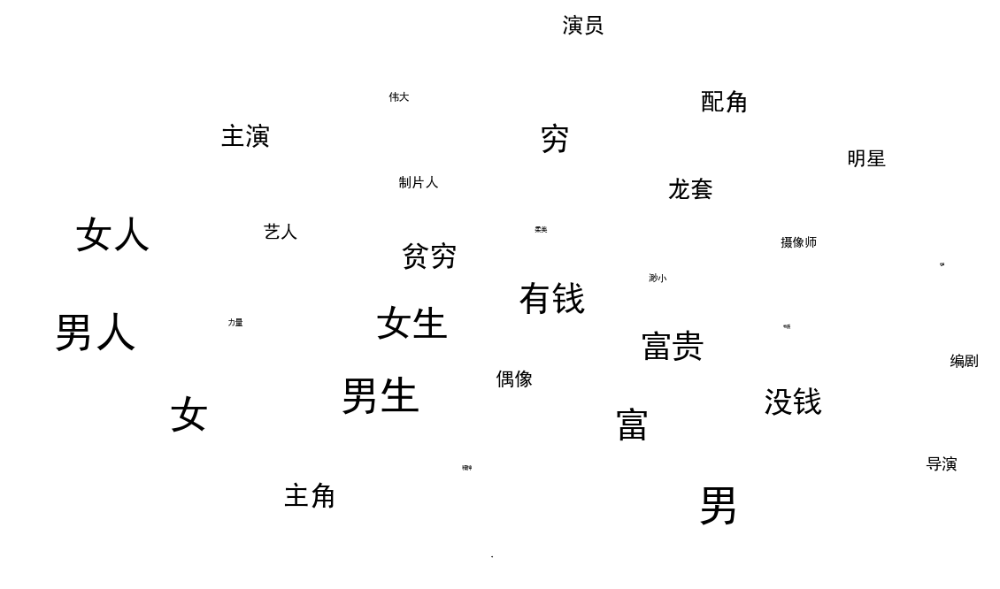

In [91]:
fig = plt.figure(figsize = (20,12))
ax = fig.add_subplot(111)
ax.set_frame_on(False)
plt.scatter(tsneWordsNYT[:, 0], tsneWordsNYT[:, 1], alpha = 0) #Making the points invisible
for i, word in enumerate(commentTargetWords):
    ax.annotate(word, (tsneWordsNYT[:, 0][i],tsneWordsNYT[:, 1][i]), size =  50 * (len(commentTargetWords) - i) / len(commentTargetWords))
plt.xticks(())
plt.yticks(())
plt.show()

In [92]:
Gender = dimension(commentsW2V.wv, ['男','男人','男生'], ['女', '女人', '女生'])
Class = dimension(commentsW2V.wv, ['富', '有钱'], ['穷', '没钱'])

In [97]:
character = ["主角","主演","配角","龙套"]
actors_different_description = ["演员","明星","偶像","艺人"]
movie_industry_practitioner = ["导演","编剧","制片人","摄像师"]
contrast_word_pair = ["伟大","渺小","力量","柔美","精神","物质","理想","现实"]

In [94]:
def makeDF(model, word_list):
    g = []
    r = []
    c = []
    for word in word_list:
        g.append(sklearn.metrics.pairwise.cosine_similarity(model[word].reshape(1,-1), Gender.reshape(1,-1))[0][0])
        c.append(sklearn.metrics.pairwise.cosine_similarity(model[word].reshape(1,-1), Class.reshape(1,-1))[0][0])
    df = pd.DataFrame({'gender': g, 'class': c}, index = word_list)
    return df

In [98]:
character_df = makeDF(commentsW2V.wv, character) 
actors_df = makeDF(commentsW2V.wv, actors_different_description)
movie_practitioner_df = makeDF(commentsW2V.wv, movie_industry_practitioner)
contrast_df = makeDF(commentsW2V.wv, contrast_word_pair) 

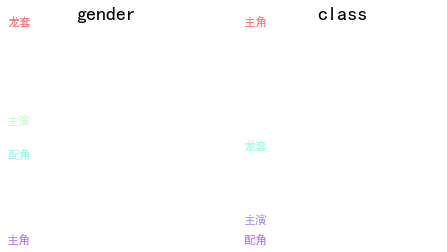

In [99]:
fig = plt.figure(figsize = (12,4))
ax1 = fig.add_subplot(131)
PlotDimension(ax1, character_df, 'gender')
ax2 = fig.add_subplot(132)
PlotDimension(ax2, character_df, 'class')
plt.show()

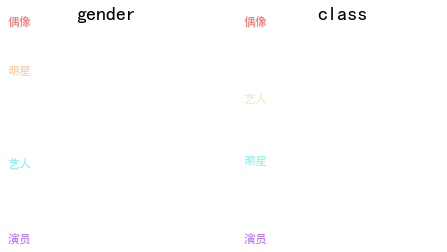

In [82]:
fig = plt.figure(figsize = (12,4))
ax1 = fig.add_subplot(131)
PlotDimension(ax1, actors_df, 'gender')
ax2 = fig.add_subplot(132)
PlotDimension(ax2, actors_df, 'class')
plt.show()

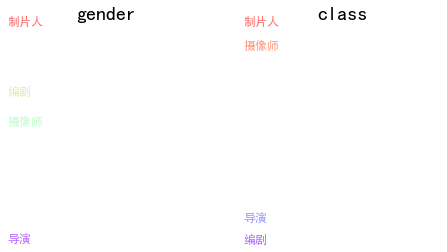

In [83]:
fig = plt.figure(figsize = (12,4))
ax1 = fig.add_subplot(131)
PlotDimension(ax1, movie_practitioner_df, 'gender')
ax2 = fig.add_subplot(132)
PlotDimension(ax2, movie_practitioner_df, 'class')
plt.show()

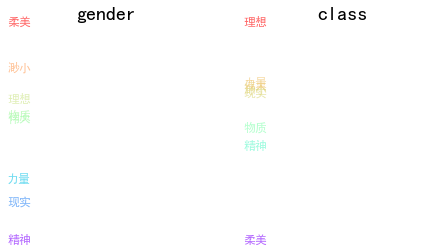

In [84]:
fig = plt.figure(figsize = (12,4))
ax1 = fig.add_subplot(131)
PlotDimension(ax1, contrast_df, 'gender')
ax2 = fig.add_subplot(132)
PlotDimension(ax2, contrast_df, 'class')
plt.show()

The red side of gender dimension is man and the purle side is woman. The constrcution of class is not very satisfying. However, the gender dimension tells us some interesting things. ‘龙套’Support actors are more likely to be male while ‘主角’protagonists are more likely to be male. When we use '偶像'idol, we are more likely refering to famous actors， and '艺人'（don't know how to translate, like movie stars, but less famous than movie stars). These words are supposed to be gender neutral, but now they're gender biased. The third plot is surprising. '导演'director is at the bottom, given the fact that there is a preponderance of male directors. This pattern may worth further exploration. The fourth picture is also very surprising that '柔美'elegant is on the top. If it were not because of movie choice or poor vector representation, then it means the feminization of male movie stars/idols, which is a trend in China. 

# The Score Function

The score function is a simple calculation developed by [Matt Taddy](https://arxiv.org/pdf/1504.07295.pdf) to calculate the likelihood that a given text would have been generated by a word-embedding model by summing the inner product between each pair of the text's word vectors. This relies on a few data files that are not in the git repo due to their size please download and unzip [this](https://github.com/Computational-Content-Analysis-2018/Upcoming/raw/master/data/supplement.zip) (472MB) file in the data directory.

Here, we explore this using a model trained with millions of resumes from the CareerBuilder website (we can't share the private resumes...but we can share a model built with them :-):

In [ ]:
resume_model  = gensim.models.word2vec.Word2Vec.load('../data/resumeAll.model')

We can examine the vacabularies of this model by building a word-index map:

In [ ]:
vocab = resume_model.wv.index2word

Let's just load the sample and take a look at it. The sentences in each job description are already tokenized and normalized.

In [ ]:
sampleDF = pd.read_csv('../data/SampleJobAds.csv', index_col = False)
#We need to convert the last couple columns from strings to lists
sampleDF['tokenized_sents'] = sampleDF['tokenized_sents'].apply(lambda x: eval(x))
sampleDF['normalized_sents'] = sampleDF['normalized_sents'].apply(lambda x: eval(x))
sampleDF

Let's define a function to calculate the likelihood of each job description. The idea is borrowed from [Matt Taddy](https://github.com/RaRe-Technologies/gensim/blob/develop/docs/notebooks/deepir.ipynb), who shows how a document can be characterized as the inner product of the distance between its words. In other words, this analysis will show which job ads are most likely to find an appropriate pool of workers in the resume bank that generated our word embedding.  

In [137]:
def adprob(ad, model):
    sen_scores = model.score(ad, len(ad))
    ad_score = sen_scores.mean()
    return ad_score

Let's apply this function to every job description.

In [ ]:
sampleDF['likelihood'] = sampleDF['normalized_sents'].apply(lambda x: adprob(x, resume_model))

Let's take a look at the top 5 job descriptions that have the highest likelihood.

In [ ]:
for ad in sampleDF.sort_values(by = 'likelihood', ascending = False)['jobDescription'][:5]:
    print (ad + '\n\n')

Let's take a look at the bottom 5 job descriptions that have the lowest likelihood to be matched by the resumes.

In [ ]:
for ad in sampleDF.sort_values(by = 'likelihood')['jobDescription'][:5]:
    print (ad + '\n\n')

We can do the same for phrases corresponding to job skills.

In [ ]:
adprob([["python", "programming"]], resume_model)

In [ ]:
adprob([["julia", "programming"]], resume_model)

Basic programming appears to be more likely in this pool of resumes than python programming. 

We can also do some simple statistics. Unfortunately, we don't have a large sample here. Nevertheless, let's first look at the mean likelihood score of each hiring organization. Some organizations will do well to hire on CareerBuilder...while others will not.

In [ ]:
sampleDF.groupby("hiringOrganization_organizationName")[['likelihood']].mean().sort_values('likelihood', ascending = False)

We can also look at the mean likelihood of each state.

In [ ]:
sampleDF.groupby("jobLocation_address_region")[['likelihood']].mean().sort_values('likelihood', ascending = False)

You would increase the sample size if you want to do a more serious study.

## <font color="red">*Exercise 4a*</font>

<font color="red">**Do only 4a or 4b.** Construct cells immediately below this that calculate the scores for a small sample of documents from outside your corpus to identify which are *closest* to your corpus. Then calculate the scores for a few phrases or sentences to identify the ones most likely to have appeared in your corpus. Interrogate patterns associated with these document/phrase scores (e.g., which companies produced job ads most or least likely to find jobseekers in the resume corpus?) What do these patterns suggest about the boundaries of your corpus?

In this exercise, I used some movie reviews from another website www.maoyan.com. This website is more commercial, a lot of people buy movie tickets on this website and leave comments. So this website has many popular box movie comments. On the other hand, movie.douban.com is more focused on comments, discussion, and recommendation. For a same movie, the rating on maoyan.com is very likely to be higher than rating on movie.douban.com. It's long been argued that these two websites have different target customer groups.

In [138]:
maoyanDF = pd.read_csv('/Users/mao_shiba/Downloads/movieComments-master/movieComments.csv',names=['ID','Location','Content','Rating','Comment_time'], header=None,encoding='gbk')
sample_maoyanDF = maoyanDF[['Rating', 'Content']][:50000:50] # 1000 comments
sample_maoyanDF['Content'].replace('[^\u4e00-\u9fa5A-Za-z0-9]+', ' ', regex = True, inplace=True)

In [139]:
simplify = lambda x: Converter("zh-hans").convert(str(x))
sample_maoyanDF['simplified'] = sample_maoyanDF['Content'].apply(simplify)

In [144]:
cut_words = lambda x: [[text for text in jieba.lcut(x) if text not in stop_words]]
sample_maoyanDF['cut_words'] = sample_maoyanDF['simplified'].apply(cut_words)

In [145]:
sample_maoyanDF.reset_index()

,index,Rating,Content,simplified,cut_words
0,0,4.5,吹爆这部电影 二刷了 第一次3d 这次imax 果然还是imax效果好 能看imax就别看3...,吹爆这部电影 二刷了 第一次3d 这次imax 果然还是imax效果好 能看imax就别看3...,"[[吹, 爆, 这部, 电影, 二刷, 第一次, 3d, imax, imax, 效果, i..."
1,50,5.0,不孬 挺好的 男朋友喜欢看,不孬 挺好的 男朋友喜欢看,"[[孬, 挺, 男朋友, 喜欢]]"
2,100,5.0,不错 很好看,不错 很好看,"[[不错, 好看]]"
3,150,5.0,有着中国情怀的科幻片 完全不同于国外的科幻片 剧情考究 特效惊人 引人深思 感觉完全可以去买...,有着中国情怀的科幻片 完全不同于国外的科幻片 剧情考究 特效惊人 引人深思 感觉完全可以去买...,"[[有着, 中国, 情怀, 科幻片, 完全, 不同于, 国外, 科幻片, 剧情, 考究, 特..."
4,200,5.0,中国硬核科幻的开山之座 没有我想象中那么拔高 但对于中国电影来说是一个很好的开始 期待以后也...,中国硬核科幻的开山之座 没有我想象中那么拔高 但对于中国电影来说是一个很好的开始 期待以后也...,"[[中国, 硬核, 科幻, 开山, 之座, 没有, 我, 想象, 拔高, 中国, 电影, 一..."
...,...,...,...,...,...
995,49750,4.5,我现在唯一指望的就是三体的电影了,我现在唯一指望的就是三体的电影了,"[[我, 现在, 唯一, 指望, 三体, 电影]]"
996,49800,3.0,个人觉得不好看 看了一个多小时都不知道在讲什么,个人觉得不好看 看了一个多小时都不知道在讲什么,"[[个人, 觉得, 好看, 一个多, 小时, 知道, 讲]]"
997,49850,5.0,可以说中国第一部灾难片的典范 虽然剧情与题材不算完美 但是还是值得一看,可以说中国第一部灾难片的典范 虽然剧情与题材不算完美 但是还是值得一看,"[[中国, 第一部, 灾难片, 典范, 剧情, 题材, 不算, 完美, 值得一看]]"
998,49900,5.0,突然就结束了,突然就结束了,"[[突然, 结束]]"


In [148]:
doubanDF = pd.read_csv('/Users/mao_shiba/Downloads/moviedata-10m/moviedata-10m/comments.csv')
doubanDF = doubanDF.loc[:, ['COMMENT_TIME','MOVIE_ID', 'VOTES', 'CONTENT']]
doubanDF['CONTENT'].replace('[^\u4e00-\u9fa5A-Za-z0-9]+', ' ', regex = True, inplace=True)
doubanDF = doubanDF[:100000] # we use 100k comments

In [149]:
# source: https://github.com/goto456/stopwords/blob/master/cn_stopwords.txt
stop_words = open("/Users/mao_shiba/Downloads/stopwords-master/cn_stopwords customized.txt", 'r', encoding='utf-8').read()
stop_words_lst = stop_words.split('\n')

simplify = lambda x: Converter("zh-hans").convert(x)
doubanDF['simplified'] = doubanDF['CONTENT'].apply(simplify)

cut_words = lambda x: [text for text in jieba.lcut(x) if text not in stop_words]
doubanDF['cut_words'] = doubanDF['simplified'].apply(cut_words)
doubanDF.head()

,COMMENT_TIME,MOVIE_ID,VOTES,CONTENT,simplified,cut_words
0,2018-09-05 19:42:07,5113101,0,480p 画质不高 黑白 y,480p 画质不高 黑白 y,"[480p, 画质, 不高, 黑白, y]"
1,2019-07-09 14:52:07,5113101,0,毫无看点 黑白画质 一个男人孤独的心理情景历程 疯疯癫癫 没有任何恐怖的成分 这应该是剧情片吧,毫无看点 黑白画质 一个男人孤独的心理情景历程 疯疯癫癫 没有任何恐怖的成分 这应该是剧情片吧,"[毫无, 看点, 黑白, 画质, 一个, 男人, 孤独, 心理, 情景, 历程, 疯疯癫癫,..."
2,2010-11-05 22:15:44,3718526,0,上吊那裡超好笑 可惜最後報告近況的旁白大扣分,上吊那里超好笑 可惜最后报告近况的旁白大扣分,"[上吊, 超, 好笑, 可惜, 最后, 报告, 近况, 旁白, 扣分]"
3,2010-06-20 02:12:50,3718526,0,上海国际电影节观摩片,上海国际电影节观摩片,"[上海, 国际, 电影节, 观摩, 片]"
4,2011-04-09 22:10:13,3718526,0,,,[]


In [150]:
doubanW2V = gensim.models.word2vec.Word2Vec(doubanDF['cut_words'].to_list(), sg=0, hs=1, negative=0)

In [151]:
doubanW2V.save("doubanWORD2Vec_100K")
doubanW2V = gensim.models.Word2Vec.load("/Users/mao_shiba/Desktop/2021-Content-Analysis/2022-Content-Analysis-HW/doubanWORD2Vec_100K")

In [152]:
sample_maoyanDF['likelihood'] = sample_maoyanDF['cut_words'].apply(lambda x: adprob(x, doubanW2V))

In [158]:
sample_maoyanDF[:50000:50]

,Rating,Content,simplified,cut_words,likelihood
0,4.5,吹爆这部电影 二刷了 第一次3d 这次imax 果然还是imax效果好 能看imax就别看3...,吹爆这部电影 二刷了 第一次3d 这次imax 果然还是imax效果好 能看imax就别看3...,"[[吹, 爆, 这部, 电影, 二刷, 第一次, 3d, imax, imax, 效果, i...",-121.684975
2500,5.0,国产科幻电影都这么厉害了,国产科幻电影都这么厉害了,"[[国产, 科幻电影, 厉害]]",-29.466566
5000,5.0,内容精彩 丰富,内容精彩 丰富,"[[内容, 精彩, 丰富]]",-20.611099
7500,5.0,国产科幻的里程碑作品,国产科幻的里程碑作品,"[[国产, 科幻, 里程碑, 作品]]",-31.078232
10000,5.0,特效满分 节奏满分 四星 多一星给中国国产元年奠定影片的头衔,特效满分 节奏满分 四星 多一星给中国国产元年奠定影片的头衔,"[[特效, 满分, 节奏, 满分, 四星, 多一星, 中国, 国产, 元年, 奠定, 影片,...",-92.532822
12500,5.0,很好 看了新喜剧 外星人 飞驰 流浪地球 流浪地球是最好看到 接着是飞驰 然后外星人 最差新喜剧,很好 看了新喜剧 外星人 飞驰 流浪地球 流浪地球是最好看到 接着是飞驰 然后外星人 最差新喜剧,"[[新, 喜剧, 外星人, 飞驰, 流浪, 地球, 流浪, 地球, 最好, 看到, 飞驰, ...",-123.172607
15000,5.0,绝对值得一看的,绝对值得一看的,"[[绝对, 值得一看]]",-14.183361
17500,4.5,不错 有点美国大片的味道 为国产电影点赞 加油吧,不错 有点美国大片的味道 为国产电影点赞 加油吧,"[[不错, 有点, 美国, 大片, 味道, 国产电影, 点赞, 加油]]",-62.045719
20000,5.0,想二刷 太好看了,想二刷 太好看了,"[[想二刷, 太, 好看]]",-6.752751
22500,5.0,感动 震撼 感悟 珍惜我们生命,感动 震撼 感悟 珍惜我们生命,"[[感动, 震撼, 感悟, 珍惜, 我们, 生命]]",-39.389034


In [156]:
# high likelyhood
for comment in sample_maoyanDF.sort_values(by = 'likelihood', ascending = False)['Content'][:20]:
    print (comment + '\n\n')

好 


保护环境 人人有责 


就那样 


吴京还是可以的


一般一般一般


可以可以可以


不虚此行 


出乎预料 


吴京可以的牛逼


牛逼 


哇噻牛逼啊宝贝儿


还挺好看的吧


挺好看的 可以去看


很好的一部电影


很不错 但是 


剧情还可以吧


还不错 


不错 


不错 


可以 不错 




These comments have similar length to comments on movie.douban.com and use similar subjective words. For example, words like‘剧情’,’不错‘,’好看‘ appear frequently on movie.douban.com. 

In [157]:
# low likelyhood
for comment in sample_maoyanDF.sort_values(by = 'likelihood')['Content'][:20]:
    print (comment + '\n\n')

算是一个台阶 也可以说希望 但这部科幻电影显然并不完美 流浪地球 本质上来讲 是一部披着科幻外衣的灾难片 虽然从庞大的设定上来看 确实是科幻题材 但电影从头至尾 其实都是按照灾难片的套路来拍的 冰封大地 众人援救 高空抢险 生离死别 影片到了中后段 让观众产生强烈浸入感的地方 并不是科幻题材里常见的烧脑元素 或者说让人新奇的设定 而是浓烈的煽情 这类情感调动其实颇为老套 尤其是最后的各国援救队返回基地 所有车辆调头回归的俯拍大场面 以及众多他国救援队员回归 喊出 我是A国救援队队员 我是B国救援队队员 的燃情场面 其实早在未放出之前 便让不少观众猜出了这种模式和套路 以及泪点 


很少给影片打十分的 但这部电影让我看到了国产电影的进步 刚开始看之前还是抱有怀疑态度的 我很担心大刘这么好的科幻素材会被国产电影给拍烂 怀着忐忑的心情看完后证明我的担心有点多余了 其实国产电影只要取消了给那些所谓明星大牌的天价片酬 把资金花在刀刃上还是能拍出来东西的 大刘果然是世界级的水准 以一己之力把中国科幻硬拉至世界顶级 太佩服了 整部电影剧情严谨 紧凑 层次感分明 特效逼真 故事布局宏大 社会性强 很值得人去仔细回味和思考 把以前国产电影只注意特效而无剧情的通病解决了不少 确实是值得一看 缺点呢还是情感戏稍显拖曳 演员表达能力不足 没有把剧情的跌宕起伏表现出来 不过瑕不掩瑜 继续加油 


看完了流浪地球 心中非常失落 只能说这部电影很不刘慈欣 这篇仅仅是大刘随意几笔写的中长小说 场面宏大程度最多只有三体的二十分之一 要表达作者所思考的宇宙构思也很少 可笑的是影片里竟一个也没体现 刘慈欣想用小说表现的是他所思考的宇宙真理 以及对人性的审视 绝不是简简单单的那一套 大难来袭 拯救地球 这部电影把科幻片拍成了灾难片 还是最老套的灾难片 只是生硬加入了流浪这一 科幻 元素 横向对比国外科幻电影 就拿星际穿越来说 这部电影才是拍出了作者的思考 对宇宙的思考 对未来的思考 希望导演们好好研读下原著 不要为票房而拍 能经得住回味的作品 才被人们称为经典 


 流浪地球 一直以来是我非常欣赏的作品 在科幻题材上再次刷新了我的大脑 这次翻拍完也期待了许久 我先不说杠精怎么 先说一下观后感 特效非常不错 场面 音效很宏伟 不知道是因为当过兵还是怎么滴 感觉泪点也是有的 片中还有很多小细节值得赞赏 

Apparently these comments are much longer than most comments on movie.douban.com. This is the biggest difference. The second difference is that those comments are all from a Chinese science fiction film shown in Feb 2019, which is consider as a milestone in Chinese science film history. So many new word patterns and their combinations（complements and comparison with hollywood couterparts） were used. 

These findings suggested that comments on movie.douban.com are usually very short and use simple subjective words. Comments are more focused on movies themselves while comments from maoyan.com may involve comparison with other movies, the format(3d, imax), the environment of cinema, etc.

# Linguistic Change or Difference

Below is code that aligns the dimensions of multiple embeddings arrayed over time or some other dimension and allow identification of semantic chanage as the word vectors change their loadings for focal words. This code comes from the approach piloted at Stanford by William Hamilton, Daniel Jurafsky and Jure Lescovec [here](https://arxiv.org/pdf/1605.09096.pdf). 

In [ ]:
import copy

In [ ]:
def calc_syn0norm(model):
    """since syn0norm is now depricated"""
    return (model.wv.syn0 / np.sqrt((model.wv.syn0 ** 2).sum(-1))[..., np.newaxis]).astype(np.float32)

def smart_procrustes_align_gensim(base_embed, other_embed, words=None):
    """Procrustes align two gensim word2vec models (to allow for comparison between same word across models).
    Code ported from HistWords <https://github.com/williamleif/histwords> by William Hamilton <wleif@stanford.edu>.
    (With help from William. Thank you!)
    First, intersect the vocabularies (see `intersection_align_gensim` documentation).
    Then do the alignment on the other_embed model.
    Replace the other_embed model's syn0 and syn0norm numpy matrices with the aligned version.
    Return other_embed.
    If `words` is set, intersect the two models' vocabulary with the vocabulary in words (see `intersection_align_gensim` documentation).
    """
    base_embed = copy.copy(base_embed)
    other_embed = copy.copy(other_embed)
    # make sure vocabulary and indices are aligned
    in_base_embed, in_other_embed = intersection_align_gensim(base_embed, other_embed, words=words)

    # get the embedding matrices
    base_vecs = calc_syn0norm(in_base_embed)
    other_vecs = calc_syn0norm(in_other_embed)

    # just a matrix dot product with numpy
    m = other_vecs.T.dot(base_vecs) 
    # SVD method from numpy
    u, _, v = np.linalg.svd(m)
    # another matrix operation
    ortho = u.dot(v) 
    # Replace original array with modified one
    # i.e. multiplying the embedding matrix (syn0norm)by "ortho"
    other_embed.wv.syn0norm = other_embed.wv.syn0 = (calc_syn0norm(other_embed)).dot(ortho)
    return other_embed
    
def intersection_align_gensim(m1,m2, words=None):
    """
    Intersect two gensim word2vec models, m1 and m2.
    Only the shared vocabulary between them is kept.
    If 'words' is set (as list or set), then the vocabulary is intersected with this list as well.
    Indices are re-organized from 0..N in order of descending frequency (=sum of counts from both m1 and m2).
    These indices correspond to the new syn0 and syn0norm objects in both gensim models:
        -- so that Row 0 of m1.syn0 will be for the same word as Row 0 of m2.syn0
        -- you can find the index of any word on the .index2word list: model.index2word.index(word) => 2
    The .vocab dictionary is also updated for each model, preserving the count but updating the index.
    """

    # Get the vocab for each model
    vocab_m1 = set(m1.wv.vocab.keys())
    vocab_m2 = set(m2.wv.vocab.keys())

    # Find the common vocabulary
    common_vocab = vocab_m1&vocab_m2
    if words: common_vocab&=set(words)

    # If no alignment necessary because vocab is identical...
    if not vocab_m1-common_vocab and not vocab_m2-common_vocab:
        return (m1,m2)

    # Otherwise sort by frequency (summed for both)
    common_vocab = list(common_vocab)
    common_vocab.sort(key=lambda w: m1.wv.vocab[w].count + m2.wv.vocab[w].count,reverse=True)

    # Then for each model...
    for m in [m1,m2]:
        # Replace old syn0norm array with new one (with common vocab)
        indices = [m.wv.vocab[w].index for w in common_vocab]
        old_arr = calc_syn0norm(m)
        new_arr = np.array([old_arr[index] for index in indices])
        m.wv.syn0norm = m.wv.syn0 = new_arr

        # Replace old vocab dictionary with new one (with common vocab)
        # and old index2word with new one
        m.index2word = common_vocab
        old_vocab = m.wv.vocab
        new_vocab = {}
        for new_index,word in enumerate(common_vocab):
            old_vocab_obj=old_vocab[word]
            new_vocab[word] = gensim.models.word2vec.Vocab(index=new_index, count=old_vocab_obj.count)
        m.wv.vocab = new_vocab

    return (m1,m2)

In order to explore this, let's get some data that follows a time trend. We'll look at conference proceedings from the American Society for Clinical Oncologists.

In [ ]:
ascoDF = pd.read_csv("../data/ASCO_abstracts.csv", index_col=0)

Prepare for wor2vec:

In [ ]:
ascoDF['tokenized_sents'] = ascoDF['Body'].apply(lambda x: [lucem_illud.word_tokenize(s) for s in lucem_illud.sent_tokenize(x)])
ascoDF['normalized_sents'] = ascoDF['tokenized_sents'].apply(lambda x: [lucem_illud.normalizeTokens(s) for s in x])

In [ ]:
ascoDF

We will be creating many embeddings so we have created this function to do most of the work. It creates two collections of embeddings, one the original and one the aligned.

In [ ]:
def compareModels(df, category, text_column_name='normalized_sents', sort = True, embeddings_raw={}):
    """If you are using time as your category sorting is important"""
    if len(embeddings_raw) == 0:
        embeddings_raw = rawModels(df, category, text_column_name, sort)
    cats = sorted(set(df[category]))
    #These are much quicker
    embeddings_aligned = {}
    for catOuter in cats:
        embeddings_aligned[catOuter] = [embeddings_raw[catOuter]]
        for catInner in cats:
            embeddings_aligned[catOuter].append(smart_procrustes_align_gensim(embeddings_aligned[catOuter][-1], embeddings_raw[catInner]))
    return embeddings_raw, embeddings_aligned

In [ ]:
def rawModels(df, category, text_column_name='normalized_sents', sort = True):
    embeddings_raw = {}
    cats = sorted(set(df[category]))
    for cat in cats:
        #This can take a while
        print("Embedding {}".format(cat), end = '\r')
        subsetDF = df[df[category] == cat]
        #You might want to change the W2V parameters
        embeddings_raw[cat] = gensim.models.word2vec.Word2Vec(subsetDF[text_column_name].sum())
    return embeddings_raw

Now we generate the models:

In [ ]:
rawEmbeddings, comparedEmbeddings = compareModels(ascoDF, 'Year')

In [ ]:
rawEmbeddings.keys()

We need to compare them across all permutions so we will define another function to help, we will be using 1 - cosine similarity as that gives a more intitive range of 0-2 with low values meaning little change and high meaning lots of change.

In [ ]:
def getDivergenceDF(word, embeddingsDict):
    dists = []
    cats = sorted(set(embeddingsDict.keys()))
    dists = {}
    print(word)
    for cat in cats:
        dists[cat] = []
        for embed in embeddingsDict[cat][1:]:
            dists[cat].append(np.abs(1 - sklearn.metrics.pairwise.cosine_similarity(np.expand_dims(embeddingsDict[cat][0][word], axis = 0),
                                                                             np.expand_dims(embed[word], axis = 0))[0,0]))
    return pd.DataFrame(dists, index = cats)

Lets look at a couple words:

In [ ]:
targetWord = 'breast'

pltDF = getDivergenceDF(targetWord, comparedEmbeddings)
fig, ax = plt.subplots(figsize = (10, 7))
seaborn.heatmap(pltDF, ax = ax, annot = False) #set annot True for a lot more information
ax.set_xlabel("Starting year")
ax.set_ylabel("Final year")
ax.set_ylabel("Final year")
ax.set_title("Yearly linguistic change for: '{}'".format(targetWord))
plt.show()

In [ ]:
targetWord = 'combination'

pltDF = getDivergenceDF(targetWord, comparedEmbeddings)
fig, ax = plt.subplots(figsize = (10, 7))
seaborn.heatmap(pltDF, ax = ax, annot = False) #set annot True for a lot more information
ax.set_xlabel("Starting year")
ax.set_ylabel("Final year")
ax.set_ylabel("Final year")
ax.set_title("Yearly linguistic change for: '{}'".format(targetWord))
plt.show()

In [ ]:
def findDiverence(word, embeddingsDict):
    cats = sorted(set(embeddingsDict.keys()))
    
    dists = []
    for embed in embeddingsDict[cats[0]][1:]:
        dists.append(1 - sklearn.metrics.pairwise.cosine_similarity(np.expand_dims(embeddingsDict[cats[0]][0][word], axis = 0), np.expand_dims(embed[word], axis = 0))[0,0])
    return sum(dists)

def findMostDivergent(embeddingsDict):
    words = []
    for embeds in embeddingsDict.values():
        for embed in embeds:
            words += list(embed.wv.vocab.keys())
    words = set(words)
    print("Found {} words to compare".format(len(words)))
    return sorted([(w, findDiverence(w, embeddingsDict)) for w in words], key = lambda x: x[1], reverse=True)
    

In [ ]:
wordDivergences = findMostDivergent(comparedEmbeddings)

The most divergent words are:

In [ ]:
wordDivergences[:20]

And the least:

In [ ]:
wordDivergences[-20:]

In [ ]:
targetWord = wordDivergences[0][0]

pltDF = getDivergenceDF(targetWord, comparedEmbeddings)
fig, ax = plt.subplots(figsize = (10, 7))
seaborn.heatmap(pltDF, ax = ax, annot = False) #set annot True for a lot more information
ax.set_xlabel("Starting year")
ax.set_ylabel("Final year")
ax.set_ylabel("Final year")
ax.set_title("Yearly linguistic change for: '{}'".format(targetWord))
plt.show()

In [ ]:
targetWord = wordDivergences[-1][0]

pltDF = getDivergenceDF(targetWord, comparedEmbeddings)
fig, ax = plt.subplots(figsize = (10, 7))
seaborn.heatmap(pltDF, ax = ax, annot = False) #set annot True for a lot more information
ax.set_xlabel("Starting year")
ax.set_ylabel("Final year")
ax.set_ylabel("Final year")
ax.set_title("Yearly linguistic change for: '{}'".format(targetWord))
plt.show()

## COHA

COHA is a historial dataset so it ends up being a good choice to try the same analysis we just did across three different time periods.

We will be using the same data loading procedure as the last notebook, so go through the process to make sure you know what's going on.

In [ ]:
corpora_address = "/Users/bhargavvader/Downloads/Academics_Tech/corpora/COHA"

In [ ]:
coha_texts = lucem_illud.loadDavies(corpora_address, return_raw=True)

Cool - let us now create our different epochs. This is an important step: I will be using the same 5 epochs I did in the DTM example, but you are recommended to play around with this. I will create a dataframe which logs the year and the genre.

In [ ]:
coha_df = pd.DataFrame(columns=["Year", "Genre", "Epoch", "normalized sents"])

In [ ]:
for article in coha_texts:
    genre, year, id_ = article.split("_")

    year = int(year)
    
    if year > 1810 and year < 1880:
        epoch = 0
    if year >= 1880 and year < 1913:
        epoch = 1
    if year >= 1913 and year < 1950:
        epoch = 2
    if year >= 1950 and year < 1990:
        epoch = 3
    if year >= 1990:
        epoch = 4
    
    try:
        if len(coha_texts[article][2]) < 1500000:
            coha_df.loc[id_] = [year, genre, epoch, lucem_illud.normalizeTokens(coha_texts[article][2].decode("utf-8"), lemma=False)]
    except TypeError:
        continue
    except IndexError:
        continue

We can now arrange our word embeddings by either year, genre, or epoch, and see how the words in each of those contexts change.

In [ ]:
rawEmbeddings_epoch = rawModels(coha_df, 'Epoch', text_column_name='normalized sents')

In [ ]:
# rawEmbeddings_genre = rawModels(coha_df, 'Genre', text_column_name='normalized sents')

We now have the raw embeddings for epoch and genre. You can test out the previous analysis on words of your choice.

In [ ]:
for epoch, embedding in enumerate(rawEmbeddings_epoch):
    model = rawEmbeddings_epoch[embedding]
    name = "embedding_epoch_" + str(epoch)
    model.save(name)

In [ ]:
# for embedding in rawEmbeddings_genre:
#     model = rawEmbeddings_genre[embedding]
#     name = "embedding_genre_" + embedding
#     model.save(name)

In [ ]:
from gensim.models import Word2Vec

In [ ]:
def file_to_embeddings(address, kind):
    rawEmbeddings = {}
    for file in os.listdir(address):
        if "embedding_"+kind in file:
            e, kind_, kind_type = file.split("_")
            kind_type = eval(kind_type)
            rawEmbeddings[kind_type] = Word2Vec.load(file)
    return rawEmbeddings

In [ ]:
# rawEmbeddings_genre_load = file_to_embeddings(".", "genre")

In [ ]:
rawEmbeddings_epoch_load = file_to_embeddings(".", "epoch")

In [ ]:
rawEmbeddings_epoch_load.keys()

In [ ]:
rawEmbeddings_epoch, compared_epoch = compareModels(coha_df, 'Epoch', text_column_name='normalized sents', embeddings_raw=rawEmbeddings_epoch_load)

In [ ]:
# rawEmbeddings_genre, compared_genre = compareModels(coha_df, 'Genre', text_column_name='normalized sents', embeddings_raw=rawEmbeddings_genre_load)

You now have access to the epoch wise embeddings, and the code to train models genre wise (commented out). You can use the original embeddings, the compared embeddings and such to perform the analysis we did before.

## <font color="red">*Exercise 4b*</font>

<font color="red">**Do only 4a or 4b.** Construct cells immediately below this that align word embeddings over time or across domains/corpora. Interrogate the spaces that result and ask which words changed most and least over the entire period or between contexts/corpora. What does this reveal about the social game underlying your space? 

There is much more we do not have time to cover on word embeddings. If you are interested in other ways to align word embeddings, take a look at the [Dynamic Word Embeddings (DTM) section from the Thinking with Deep Learning course](https://colab.research.google.com/drive/1RAiI3BIL1X9D4gzZ0rZdIJjkNNicIuKE?usp=sharing#scrollTo=COS_n2RFCJNk) or using the more recent [Temporal Word Embeddings with a Compass (TWEC) package](https://github.com/valedica/twec). There is also a useful section on [debiasing word embeddings](https://colab.research.google.com/drive/1RAiI3BIL1X9D4gzZ0rZdIJjkNNicIuKE?usp=sharing#scrollTo=JHQ--EsWoxGM), such as the famous, ["Man is to Computer Programmer as Woman is to Homemaker? Debiasing Word Embeddings"](https://arxiv.org/abs/1607.06520) paper. Below, we include an optional section on topic modeling with word embeddings, which could be useful for final projects.

## Optional: Topic modeling with word embeddings

Recently computer scientists have developed methods to cluster word embeddings, which can be viewed as a topic model, an embedding-based version of conventional topic models that use the document-term matrix (e.g., LDA). One method is Discourse Atoms, first described by Princeton NLP researchers ([Arora et al. 2018](https://arxiv.org/abs/1601.03764)). This uses k-SVD, a generalization of the k-means clustering algorithm to identify topic-like vectors in the n-dimensional word embedding space. Below is code adapted from the first social science paper using Discourse Atoms, [Arseniev-Koehler et al. 2021](https://osf.io/preprints/socarxiv/nkyaq/). It takes as input _gensim_ word vectors.

You are not required to implement this, but for class projects or your own research, this can be more useful than conventional topic models. It runs faster, produces more detailed topics, and in general makes use of more information (i.e., word order within a document) than do conventional topic models. Note there are at least 4 other papers with methods for word embedding clusters:

- Xun, Li, Zhao, Gao, and Zhang 2017: [multivariate Gaussian distributions](https://www.ijcai.org/proceedings/2017/588)
- Dieng, Ruiz, and Blei 2019: ["Embedding Topic Model (ETM)"](https://arxiv.org/abs/1907.04907)
- Angelov 2020: ["Top2Vec"](https://arxiv.org/abs/2008.09470)
- Sia, Dalmia, and Mielke 2020: [(spherical) k-means, k-medoids, von Mises-Fisher Models, Gaussian Mixture Models](https://arxiv.org/abs/2004.14914)

Let's implement the Discourse Atoms method.

In [ ]:
# from gensim.test.utils import datapath 
# import re
# import string, re
# import cython

In [ ]:
# The ksvd package has a convenient Approximate k-SVD function.
!pip install ksvd

In [ ]:
from gensim import corpora, models, similarities #calc all similarities at once, from http://radimrehurek.com/gensim/tut3.html
from sklearn.metrics.pairwise import cosine_similarity
from gensim.models import KeyedVectors
from random import seed, sample
from ksvd import ApproximateKSVD #pip or conda install ksvd #this is key!

In [ ]:
import pickle

In [ ]:
import math

In [ ]:
# Load a gensim word2vec model
w2v = senReleasesW2V

#### k-SVD

We then perform a K-SVD on the word embedding matrix to learn topics in such a way where each word-vector is represented as a spare linear combination of topics. To generate a good representation of the original word vector space, we want to minimize the difference between our word vectors and the vectors generated as a linear combination of topics. 




In [ ]:
#### TRAIN MODEL:

#n_comp: Number of topics (i.e., atoms, or dictionary elements)
#n_nonzeros: Number of nonzero coefficients to target (how many atoms each word can load onto)
            
def do_aksvd(w2vmodel, n_comp, n_nonzeros, save=False, savelocation='/content/aksvd_models/'): 
    #https://github.com/nel215/ksvd #takes about 2 min on Alina's laptop for 30 atoms 
    aksvd_t = ApproximateKSVD(n_components=n_comp, transform_n_nonzero_coefs=n_nonzeros) #also may adjuste n iter which is default at 10, and tolerance for error which is default at  tol=1e-6 #n_components is number of discourse atoms, since vocab size is smallish, keep this fewer. transform_n is the number of atoms (components) that a word can be a linear combo of
    dictionary_t = aksvd_t.fit(w2vmodel.wv.vectors).components_ # Dictionary is the matrix of discourse atoms. 
    alpha_t = aksvd_t.transform(w2vmodel.wv.vectors) #get the alphas, which are the "weights" of each word on a discourse atoms

    if save==True:
        outfile = open(str(savelocation) + '200d_' + str(n_comp) + 'comp' + str(n_nonzeros) + 'nonzeros_aksvd_nvdrsdf20','wb')
        pickle.dump(aksvd_t,outfile)
        outfile.close()
        
        outfile = open(str(savelocation) + '200d_' +str(n_comp) + 'comp' + str(n_nonzeros) + 'nonzeros_dictionary_nvdrsdf20','wb')
        pickle.dump(dictionary_t,outfile)
        outfile.close()
        
        outfile = open(str(savelocation) + '200d_' + str(n_comp) + 'comp' + str(n_nonzeros) + 'nonzeros_alpha_nvdrsdf20','wb')
        pickle.dump(alpha_t,outfile)
        outfile.close()
    return(dictionary_t, alpha_t)

Two quick quality checks. These are useful to choose the number of atoms in the dictionary (i.e., number of topics): $R^2$ and Topic Diversity

Useful to look at product of the two since $R^2$ tends to increase with higher # topics, as Topic Diversity decreases. Intuition: more topics can better explain the original semantic space, but also then these topics are less distinct from one another. As a result, we typically want a balance between the two.

In [ ]:
def reconst_qual(w2vmodel, dictionary_mat, alpha_mat):
    #reconstruct the word vectors
    reconstructed = alpha_mat.dot(dictionary_mat) #reconstruct word vectors and add back in mean(?). but note that reconstructed norm is still around 0-1, not 1, is that an issue?
    #e1 = norm(w2vmodel.wv.vectors - reconstructed) #total reconstruction error, larger means MORE error. norm as specified here takes frobenius norm of error matrix.


    #total VARIANCE in the data: sum of squares 
    squares3= w2vmodel.wv.vectors-np.mean(w2vmodel.wv.vectors, axis=1).reshape(-1,1) #https://dziganto.github.io/data%20science/linear%20regression/machine%20learning/python/Linear-Regression-101-Metrics/
    #sst3= np.sum([i.dot(i) for i in squares3] ) #same as below

    sst3= np.sum(np.square(squares3))


    #total sum of squared ERRORS/residuals
    e3= [reconstructed[i]-w2vmodel.wv.vectors[i] for i in range(0,len(w2vmodel.wv.vectors))]  #https://dziganto.github.io/data%20science/linear%20regression/machine%20learning/python/Linear-Regression-101-Metrics/
    #sse3= np.sum([i.dot(i) for i in e3] ) #same as below
    sse3= np.sum(np.square(e3))

    #R^2: 1- (SSE / SST )
    r2= 1- (sse3 /  sst3) #https://stats.stackexchange.com/questions/184603/in-pca-what-is-the-connection-between-explained-variance-and-squared-error


    #compute root mean square error
    rmse=  math.sqrt(np.mean(np.square(e3)))



    return(sse3, rmse, r2) #https://stats.stackexchange.com/questions/184603/in-pca-what-is-the-connection-between-explained-variance-and-squared-error

#### Inferring topics from document

We now use a similar approach to what we saw a little earlier, where we inverted our generative model to see which documents belong to which class - we do the same now, but with discourse atoms instead of the whole model. This process tells us the topic most likely to have generated a specific context (document). 



In [ ]:
#topic diversity (% unique words among total closest 25 words to each atom)
def topic_diversity(w2vmodel, dictionary_mat, top_n=25):

    topwords=[] #list of list, each innter list includes top N words in that topic

    for i in range(0, len(dictionary_mat)): #set to number of total topics
        topwords.extend([i[0] for i in w2vmodel.wv.similar_by_vector(dictionary_mat[i],topn=top_n)]) #set for top N words 
        #print(w2vmodel.wv.similar_by_vector(dictionary[i],topn=N))

    uniquewords= set(topwords)
    diversity = len(uniquewords)/len(topwords)
    return(diversity)

In [ ]:
dictionary, alpha = do_aksvd(w2v, 150, 5, save=True)

In [ ]:
topic_diversity(w2v, dictionary, top_n=25)

In [ ]:
reconst_qual(w2v, dictionary, alpha)


In [ ]:
#loading back in the model pieces if not already in

# infile = open('../data/aksvd_models/200d_150comp5nonzeros_dictionary_nvdrsdf20','rb')
# dictionary=pickle.load(infile)
# infile.close()

# infile = open('../data/aksvd_models/200d_150comp5nonzeros_aksvd_nvdrsdf20','rb')
# aksvd=pickle.load(infile)
# infile.close()

# infile = open('../data/aksvd_models/200d_150comp5nonzeros_alpha_nvdrsdf20','rb')
# alpha=pickle.load(infile)
# infile.close()

In [ ]:
for i in range(0, len(dictionary)):
    print("Discourse_Atom " + str(i))
    print([i[0] for i in w2v.wv.similar_by_vector(dictionary[i],topn=25)]) #what are the most similar words to the Nth
    #print([i[0] for i in w2vmodel.wv.similar_by_vector(-dictionary[i],topn=25)]) #what are the most similar words to the Nth dicourse atom?
    print('\n')


In [ ]:
# for a specific atom, e.g., 112th atom look at 25 most similar words:
w2v.wv.similar_by_vector(dictionary[112],topn=25)

In [ ]:
print(w2v.wv.vocab.get('the').index, '\n', alpha[w2vmodel.wv.vocab.get('the').index])



In [ ]:
#useful relevant code:
#w2vmodel.wv.index2word[3452]
#w2vmodel.wv.most_similar('the', topn=15)
#np.where(alpha[w2vmodel.wv.vocab.get('the').index] != 0) #get index where the loading of a word onto discourse atoms is not 0